# 1. Take images 
# 2. Split the images into train, test and validation dataset

In [2]:
import os
import shutil
import random
from collections import defaultdict

# Define the path to your images directory
dataset_dir = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images'
train_dir = os.path.join(dataset_dir, 'train')
val_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

# Create the directories for train, val, and test if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Get a list of all image files in the dataset directory
all_images = [f for f in os.listdir(dataset_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Group images by their common prefix (before the first '_')
image_groups = defaultdict(list)
for image in all_images:
    prefix = image.split('_')[0]  # Extract the common prefix (e.g., '1004-4B')
    image_groups[prefix].append(image)

# Shuffle the groups to ensure randomness
groups = list(image_groups.values())
random.shuffle(groups)

# Define the split ratios
train_ratio = 0.8
val_ratio = 0.1
test_ratio = 0.1

# Calculate the number of groups for each set
total_groups = len(groups)
num_train_groups = int(train_ratio * total_groups)
num_val_groups = int(val_ratio * total_groups)
num_test_groups = total_groups - num_train_groups - num_val_groups

# Split the groups into train, val, and test sets
train_groups = groups[:num_train_groups]
val_groups = groups[num_train_groups:num_train_groups + num_val_groups]
test_groups = groups[num_train_groups + num_val_groups:]

# Move the images to their respective folders
def move_images(groups, target_dir):
    for group in groups:
        for image in group:
            shutil.move(os.path.join(dataset_dir, image), os.path.join(target_dir, image))

move_images(train_groups, train_dir)
move_images(val_groups, val_dir)
move_images(test_groups, test_dir)

print(f"Split {total_groups} image groups into:")
print(f" - {len(train_groups)} groups for training")
print(f" - {len(val_groups)} groups for validation")
print(f" - {len(test_groups)} groups for testing")


Split 12 image groups into:
 - 9 groups for training
 - 1 groups for validation
 - 2 groups for testing


# 3. Get the landmarks 


Image 2001-6C_1.jpg load, size: (4032, 3024, 3)

0: 640x480 1 color_card, 60.4ms
Speed: 3.9ms preprocess, 60.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)


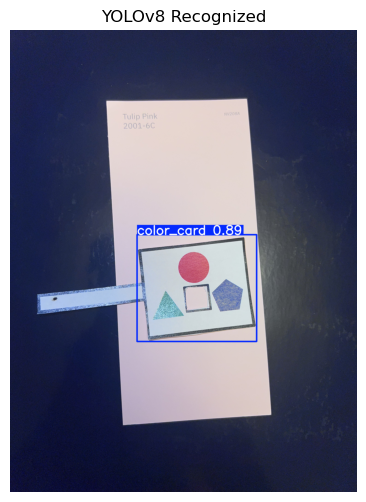

Image cropped. Size: (932, 1042, 3)

0: 576x640 2 black_boxs, 1 red_circle, 1 green_triangle, 1 blue_pentagon, 58.4ms
Speed: 2.2ms preprocess, 58.4ms inference, 0.3ms postprocess per image at shape (1, 3, 576, 640)


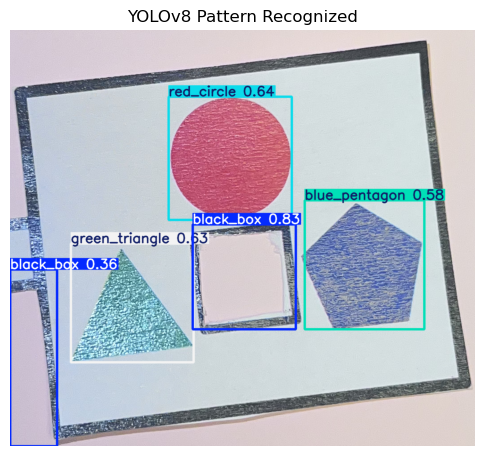


0: 576x640 2 black_boxs, 1 red_circle, 1 green_triangle, 1 blue_pentagon, 108.4ms
Speed: 1.8ms preprocess, 108.4ms inference, 0.3ms postprocess per image at shape (1, 3, 576, 640)


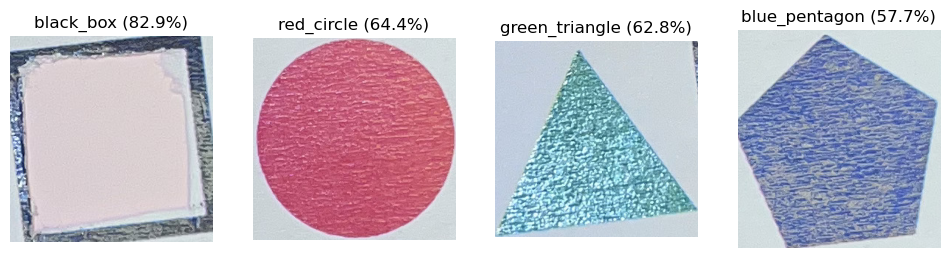

In [61]:
# LOAD ALL NECESSARY LIBRARIES AND MODELS

from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np


# Load the YOLOv8 models from local paths
model_first = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_first.pt')
model_second = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_second.pt')

# Make sure the image can be used to recgonize
from PIL import Image

# Get the name
uploaded_filename = "2001-6C_1.jpg"
image_path = "test/2001-6C_1.jpg"

# Load the image
image = cv2.imread(image_path)

# If OpenCV can't read it, try processing it with PIL
if image is None:
    print(f"Load {uploaded_filename} Failed, try converting format...")
    try:
        pil_image = Image.open(image_path).convert("RGB")
        image = np.array(pil_image)
        image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)  
        print(f"Success Converting {uploaded_filename}")
    except Exception as e:
        print(f"Failed to convert {uploaded_filename}: {e}")
        image = None

if image is not None:
    print(f"Image {uploaded_filename} load, size: {image.shape}")

import matplotlib.pyplot as plt

# Use model1 to narrow the recognizing area
results1 = model_first(image)

# Display YOLOv8 recognition results (full image + recognition box)
annotated_image = results1[0].plot()
plt.figure(figsize=(6, 6))
plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("YOLOv8 Recognized")
plt.show()

# Get the detection frame
boxes = results1[0].boxes if results1 else []

if len(boxes) > 0:
    box = boxes[0]  # Take the first target box
    x1, y1, x2, y2 = map(int, box.xyxy[0])  # Convert to integer

    # Make sure the cropping range is within the image boundaries
    h, w, _ = image.shape
    x1, y1, x2, y2 = max(0, x1), max(0, y1), min(w, x2), min(h, y2)

    # Cut the card
    image_crop = image[y1:y2, x1:x2]

    print(f"Image cropped. Size: {image_crop.shape}")
else:
    print("Card Not Recognized")
    image_crop = None

# Recognize patterns based on cropped image
if image_crop is not None:
    # use model2 to recognize pattern
    results2 = model_second(image_crop)

    # show target box of each pattern
    annotated_crop = results2[0].plot()
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(annotated_crop, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("YOLOv8 Pattern Recognized")
    plt.show()
else:
    print("Failed")

# For further analysis
if image_crop is not None:
    results2 = model_second(image_crop)  # Recognize patterns using model2
    boxes = results2[0].boxes if results2 else []
    class_names = results2[0].names  # Get class labels from YOLO model
    confidences = results2[0].boxes.conf  # Confidence scores

    # Store all detected patterns with names and confidence >= 50%
    patterns = []
    pattern_labels = []  # List to store pattern names
    valid_confidence = []  # List to store valid confidence levels

    # Iterate through all detected bounding boxes
    for i, (box, confidence) in enumerate(zip(boxes, confidences)):
        if confidence >= 0.5:  # Only consider patterns with confidence >= 50%
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            h, w, _ = image_crop.shape

            # Ensure coordinates do not exceed image boundaries
            x1, y1, x2, y2 = max(0, x1), max(0, y1), min(w, x2), min(h, y2)

            # Crop the pattern and store it in the array
            pattern_crop = image_crop[y1:y2, x1:x2]
            patterns.append(pattern_crop)

            # Get class label (pattern name)
            class_id = int(box.cls[0])  # Get the detected class index
            pattern_labels.append(class_names[class_id])  # Retrieve pattern name
            valid_confidence.append(confidence)  # Store valid confidence

    # Display all detected patterns with their names and valid confidence
    fig, axes = plt.subplots(1, len(patterns), figsize=(12, 4))

    for i, (pattern, label) in enumerate(zip(patterns, pattern_labels)):
        axes[i].imshow(cv2.cvtColor(pattern, cv2.COLOR_BGR2RGB))
        axes[i].axis("off")
        axes[i].set_title(f"{label} ({valid_confidence[i]*100:.1f}%)")  # Show confidence

    plt.show()

else:
    print("Detection failed, no patterns found.")


# 4. Extract observed color values
- extract the rgb values for all the data points from the image segments 
- and draw a histogram to remove outliers of the white point appearances

- visualize the observed color and the actual colors side-by-side to show the difference in color and emphasise on the delta

### Extract the RGB values

In [63]:
observed_colors = []
pattern_names = []

for pattern, label in zip(patterns, pattern_labels):  # Use actual names instead of numbers
    # Convert to RGB for correct color representation
    pattern_rgb = cv2.cvtColor(pattern, cv2.COLOR_BGR2RGB)
    
    # Compute mean color (ignoring white pixels)
    mask = np.all(pattern_rgb < [250, 250, 250], axis=-1)  # Exclude nearly white pixels
    mean_color = np.mean(pattern_rgb[mask], axis=0) if np.any(mask) else np.array([255, 255, 255])

    observed_colors.append(mean_color)
    pattern_names.append(label)  # Use detected pattern name

# Print results to verify
for name, color in zip(pattern_names, observed_colors):
    print(f"Pattern: {name}, Mean Color: {color}")


Pattern: black_box, Mean Color: [     191.19      187.46      193.82]
Pattern: red_circle, Mean Color: [      200.3      124.49      144.85]
Pattern: green_triangle, Mean Color: [        163      192.92      204.79]
Pattern: blue_pentagon, Mean Color: [     149.07      162.92      192.39]


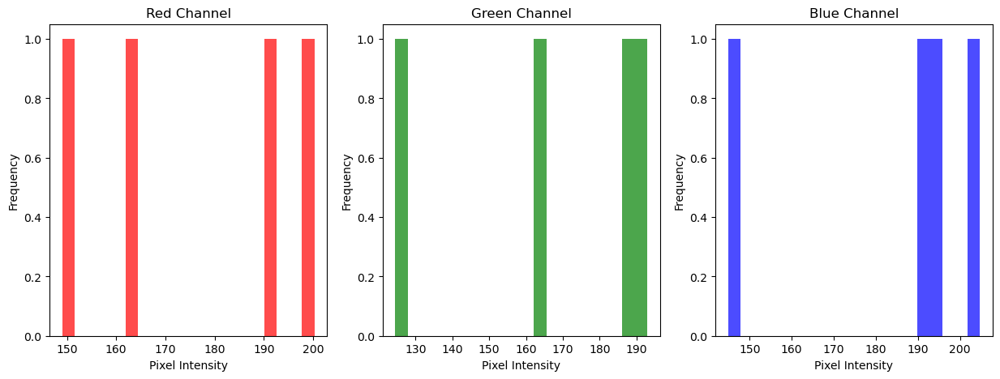

In [64]:
# Convert list to numpy array
observed_colors = np.array(observed_colors)

# Plot histograms for each channel
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
colors = ['red', 'green', 'blue']
labels = ['Red Channel', 'Green Channel', 'Blue Channel']

for i in range(3):
    axes[i].hist(observed_colors[:, i], bins=20, color=colors[i], alpha=0.7)
    axes[i].set_title(labels[i])
    axes[i].set_xlabel("Pixel Intensity")
    axes[i].set_ylabel("Frequency")

plt.show()


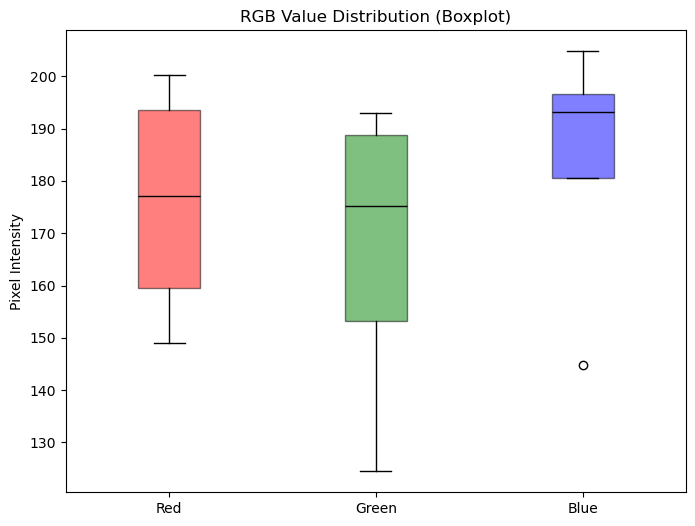

In [65]:
plt.figure(figsize=(8, 6))

# Define colors for each channel
box_colors = ['red', 'green', 'blue']

# Create boxplot
box = plt.boxplot(observed_colors, labels=['Red', 'Green', 'Blue'], patch_artist=True,
                  medianprops=dict(color="black"))

# Set colors for each box
for patch, color in zip(box['boxes'], box_colors):
    patch.set_facecolor(color)
    patch.set_alpha(0.5)  # Adjust transparency for better visibility

plt.title("RGB Value Distribution (Boxplot)")
plt.ylabel("Pixel Intensity")
plt.show()


#### Real vs Observed

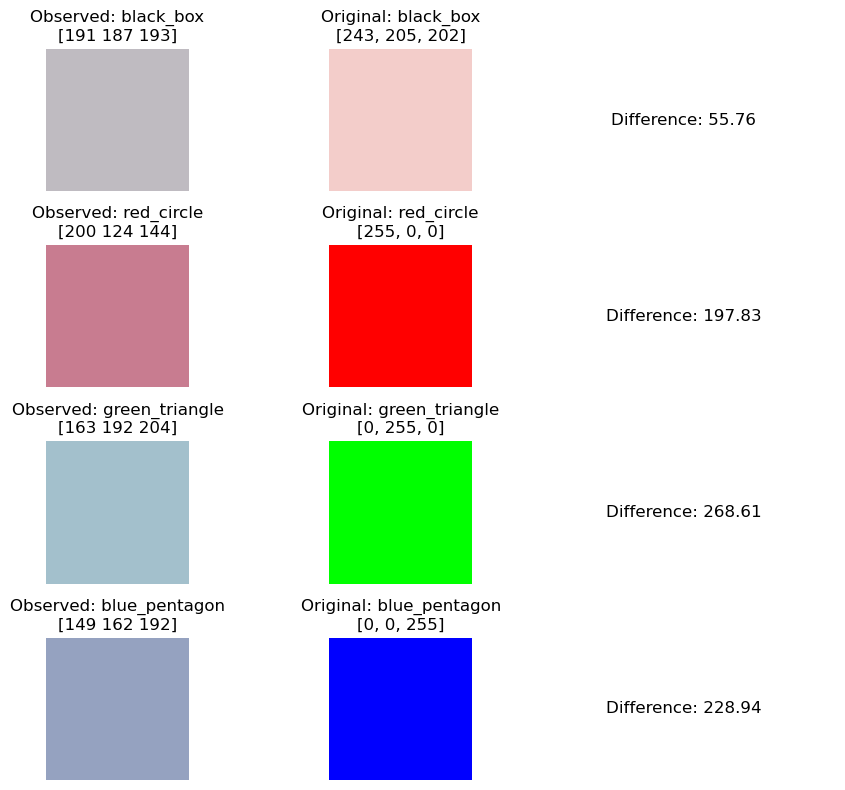

In [ ]:
import matplotlib.patches as mpatches
import numpy as np
import matplotlib.pyplot as plt

# Define original colors (expected values)
original_colors = {
    "black_box": [243, 205, 202],
    "red_circle": [255, 0, 0],
    "green_triangle": [0, 255, 0],
    "blue_pentagon": [0, 0, 255],
}

# Example observed data
observed_colors = [
    [191.19, 187.46, 193.82],  # black_box
    [200.3, 124.49, 144.85],   # red_circle
    [163, 192.92, 204.79],     # green_triangle
    [149.07, 162.92, 192.39],  # blue_pentagon
]

pattern_names = ["black_box", "red_circle", "green_triangle", "blue_pentagon"]

# Create a plot comparing observed vs. original colors
fig, axes = plt.subplots(len(pattern_names), 3, figsize=(9, len(pattern_names) * 2))

for name, observed_color in zip(pattern_names, observed_colors):
    # Convert observed color to integer
    observed_color = np.array(observed_color).astype(int)

    # Get the original color, defaulting to white if not found
    original_color = original_colors.get(name, [255, 255, 255])

    # Calculate the Euclidean distance (color difference)
    diff = np.linalg.norm(observed_color - np.array(original_color))

    # Plot observed color
    axes[pattern_names.index(name), 0].imshow([[observed_color / 255]])  # Normalize to [0,1] for imshow
    axes[pattern_names.index(name), 0].axis("off")
    axes[pattern_names.index(name), 0].set_title(f"Observed: {name}\n{observed_color}")

    # Plot original color
    axes[pattern_names.index(name), 1].imshow([[np.array(original_color) / 255]])  # Normalize
    axes[pattern_names.index(name), 1].axis("off")
    axes[pattern_names.index(name), 1].set_title(f"Original: {name}\n{original_color}")

    # Display the color difference
    axes[pattern_names.index(name), 2].text(0.5, 0.5, f"Difference: {diff:.2f}", 
                                             ha='center', va='center', fontsize=12)
    axes[pattern_names.index(name), 2].axis("off")

# Adjust layout
plt.tight_layout()
plt.show()


# Euclidean Distance:
# We use the np.linalg.norm() function to calculate the Euclidean distance between the observed color and the original color. This gives the "color difference" (the smaller the number, the closer the two colors are).
# The difference is computed as np.linalg.norm(observed_color - np.array(original_color)).

- grouped: 
    - visualise the observed values as compare to the real value for rgb colors
    - visualize all the pattern 1 boxed values together and a graph or something to show the difference between the observed color and the actual

Average Color Difference (Euclidean Distance): 73.50
Max Color Difference: 284.19
Min Color Difference: 3.61


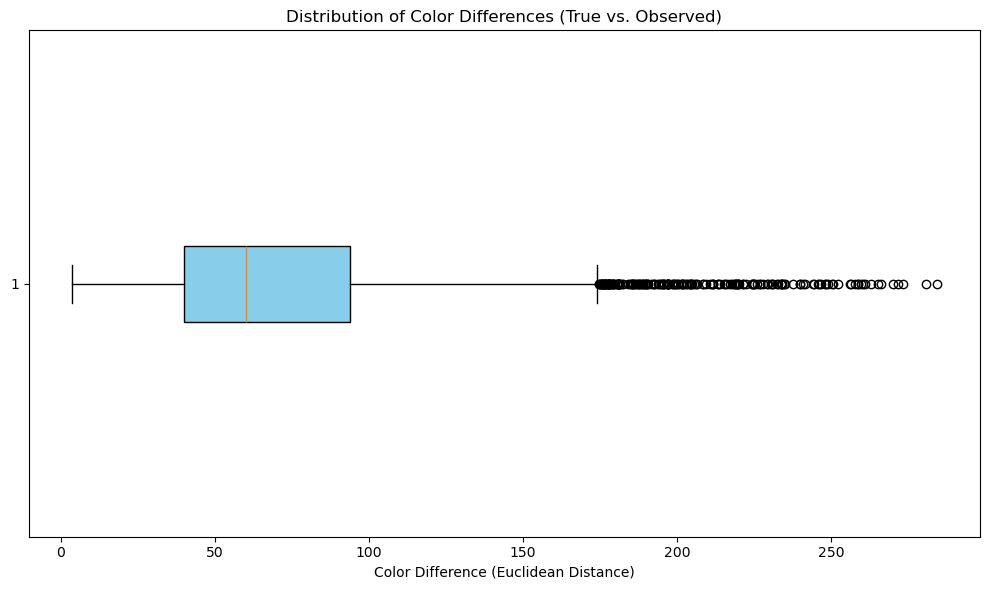

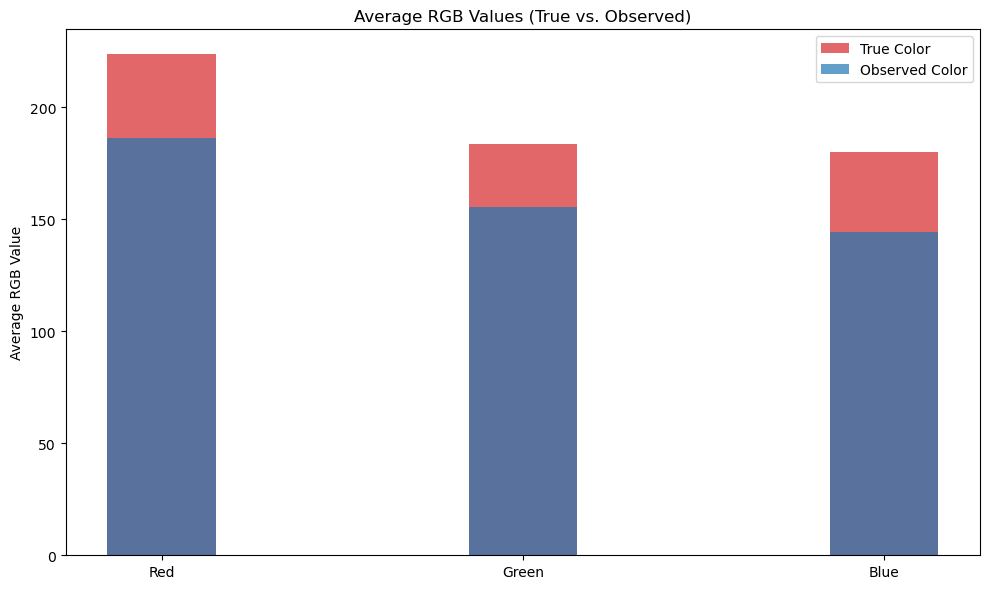


Summary Table with Color Differences:
           Pattern  True R  True G  True B  Observed R  Observed G  \
0        Pattern 1      72      30      40        75.0        41.0   
1        Pattern 2      72      30      40       117.0        57.0   
2        Pattern 3      72      30      40        83.0        55.0   
3        Pattern 4     250     226     216       211.0       185.0   
4        Pattern 5     250     226     216       185.0       174.0   
...            ...     ...     ...     ...         ...         ...   
3169  Pattern 3170     210     129     101       170.0       108.0   
3170  Pattern 3171     210     129     101       177.0       116.0   
3171  Pattern 3172     210     129     101       177.0       116.0   
3172  Pattern 3173     210     129     101       175.0       114.0   
3173  Pattern 3174     210     129     101       171.0       109.0   

      Observed B  Color Difference  
0           49.0         14.525839  
1           67.0         59.016947  
2        

In [74]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Step 1: Load the CSV file into a DataFrame
df = pd.read_csv('your_data.csv')

# Step 2: Handle NaNs (choose one method)
df = df.dropna()  # Remove rows with NaNs
# df = df.fillna(df.mean())  # Fill with the mean
# df = df.fillna(0) # Fill with 0
# df = df.interpolate()  # Interpolate

# Step 3: Extract relevant columns and convert to numpy arrays
true_r = df['True R'].values
true_g = df['True G'].values
true_b = df['True B'].values
observed_r = df['Observed R'].values
observed_g = df['Observed G'].values
observed_b = df['Observed B'].values

# Step 4: Calculate color difference (Euclidean distance) for each pattern
true_rgb_all = np.array([true_r, true_g, true_b]).T  # Stack the RGB values for all patterns
observed_rgb_all = np.array([observed_r, observed_g, observed_b]).T  # Stack the Observed RGB values

# Calculate the Euclidean distance (color difference) between true and observed RGB values
color_diff = np.linalg.norm(true_rgb_all - observed_rgb_all, axis=1)

# Step 5: Visualizations

# 1. Summary Statistics: Average Color Difference
avg_color_diff = np.mean(color_diff)
max_color_diff = np.max(color_diff)
min_color_diff = np.min(color_diff)

# Print summary statistics
print(f"Average Color Difference (Euclidean Distance): {avg_color_diff:.2f}")
print(f"Max Color Difference: {max_color_diff:.2f}")
print(f"Min Color Difference: {min_color_diff:.2f}")

# 2. Box Plot of Color Differences
fig, ax = plt.subplots(figsize=(10, 6))
ax.boxplot(color_diff, vert=False, patch_artist=True, boxprops=dict(facecolor="skyblue"))
ax.set_title('Distribution of Color Differences (True vs. Observed)')
ax.set_xlabel('Color Difference (Euclidean Distance)')
plt.tight_layout()
plt.show()

# 3. Plot Average Color Difference for Each RGB Channel
fig, ax = plt.subplots(figsize=(10, 6))
x_labels = ['Red', 'Green', 'Blue']

# Average difference for each RGB channel
avg_true = [np.mean(true_r), np.mean(true_g), np.mean(true_b)]
avg_observed = [np.mean(observed_r), np.mean(observed_g), np.mean(observed_b)]

ax.bar(x_labels, avg_true, width=0.3, label='True Color', alpha=0.7, color='tab:red')
ax.bar(x_labels, avg_observed, width=0.3, label='Observed Color', alpha=0.7, color='tab:blue')

ax.set_title('Average RGB Values (True vs. Observed)')
ax.set_ylabel('Average RGB Value')
ax.legend()

plt.tight_layout()
plt.show()

# 4. Summary Table (Optional)
summary_df = pd.DataFrame({
    'Pattern': [f'Pattern {i+1}' for i in range(len(df))],
    'True R': true_r,
    'True G': true_g,
    'True B': true_b,
    'Observed R': observed_r,
    'Observed G': observed_g,
    'Observed B': observed_b,
    'Color Difference': color_diff
})

# Display the summary table for reference
print("\nSummary Table with Color Differences:")
print(summary_df)


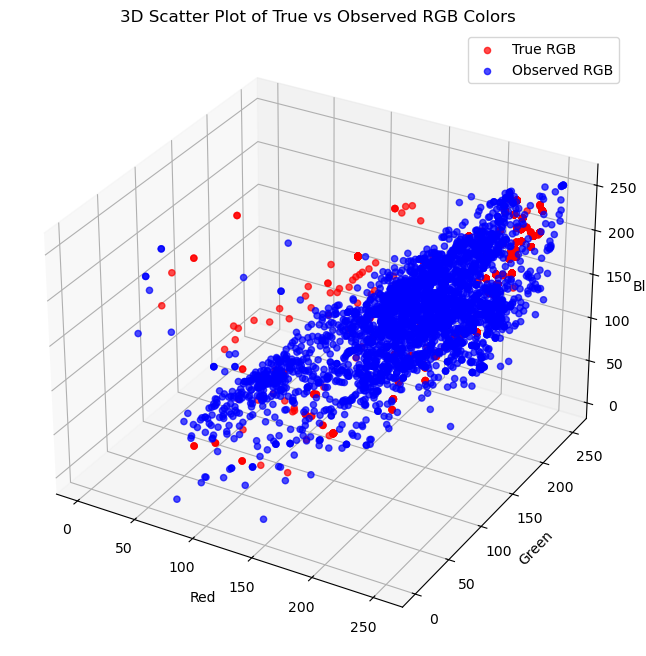

In [76]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot true RGB values
ax.scatter(true_r, true_g, true_b, c='r', label="True RGB", alpha=0.7)

# Plot observed RGB values
ax.scatter(observed_r, observed_g, observed_b, c='b', label="Observed RGB", alpha=0.7)

ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')
ax.set_title("3D Scatter Plot of True vs Observed RGB Colors")
ax.legend()

plt.show()


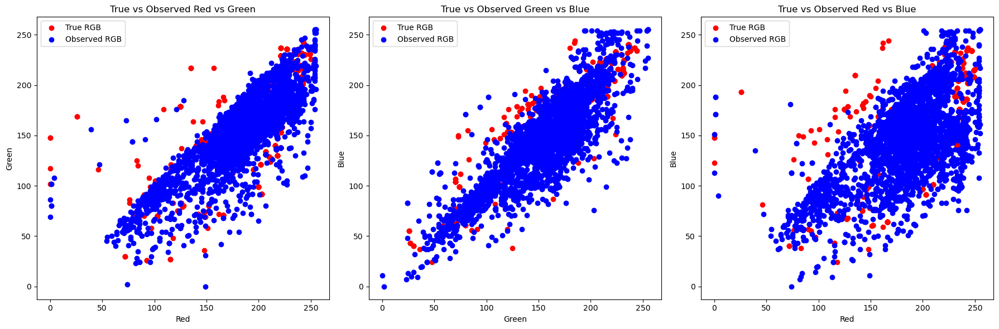

In [77]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Red vs Green
axes[0].scatter(true_r, true_g, c='r', label="True RGB")
axes[0].scatter(observed_r, observed_g, c='b', label="Observed RGB")
axes[0].set_xlabel("Red")
axes[0].set_ylabel("Green")
axes[0].set_title("True vs Observed Red vs Green")
axes[0].legend()

# Green vs Blue
axes[1].scatter(true_g, true_b, c='r', label="True RGB")
axes[1].scatter(observed_g, observed_b, c='b', label="Observed RGB")
axes[1].set_xlabel("Green")
axes[1].set_ylabel("Blue")
axes[1].set_title("True vs Observed Green vs Blue")
axes[1].legend()

# Red vs Blue
axes[2].scatter(true_r, true_b, c='r', label="True RGB")
axes[2].scatter(observed_r, observed_b, c='b', label="Observed RGB")
axes[2].set_xlabel("Red")
axes[2].set_ylabel("Blue")
axes[2].set_title("True vs Observed Red vs Blue")
axes[2].legend()

plt.tight_layout()
plt.show()


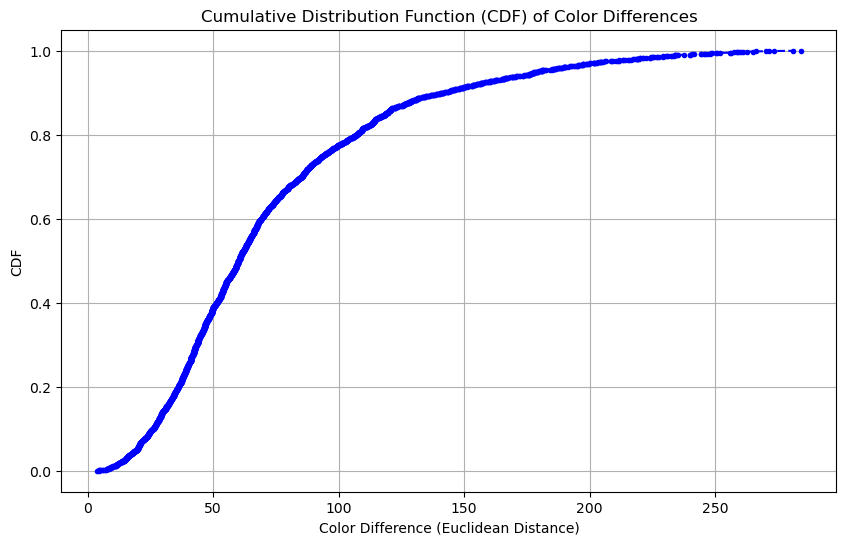

In [78]:
# Sort the color differences for plotting the CDF
sorted_diff = np.sort(color_diff)

# Plot the CDF
plt.figure(figsize=(10, 6))
plt.plot(sorted_diff, np.linspace(0, 1, len(sorted_diff)), marker='.', linestyle='--', color='b')
plt.title("Cumulative Distribution Function (CDF) of Color Differences")
plt.xlabel("Color Difference (Euclidean Distance)")
plt.ylabel("CDF")
plt.grid(True)
plt.show()


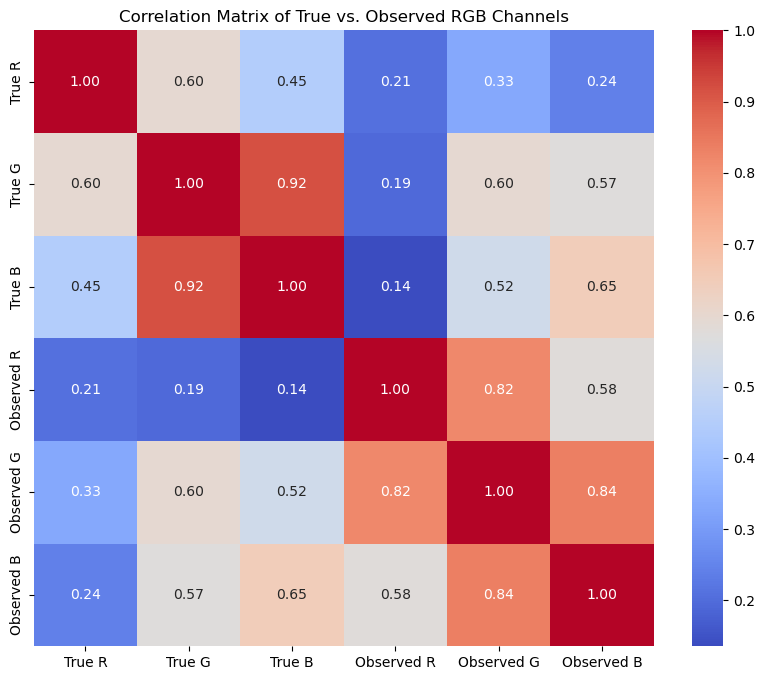

In [79]:
import seaborn as sns

# Combine the true and observed RGB values into a single dataframe
df_combined = pd.DataFrame({
    'True R': true_r,
    'True G': true_g,
    'True B': true_b,
    'Observed R': observed_r,
    'Observed G': observed_g,
    'Observed B': observed_b
})

# Calculate the correlation matrix
corr_matrix = df_combined.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", cbar=True)
plt.title("Correlation Matrix of True vs. Observed RGB Channels")
plt.show()


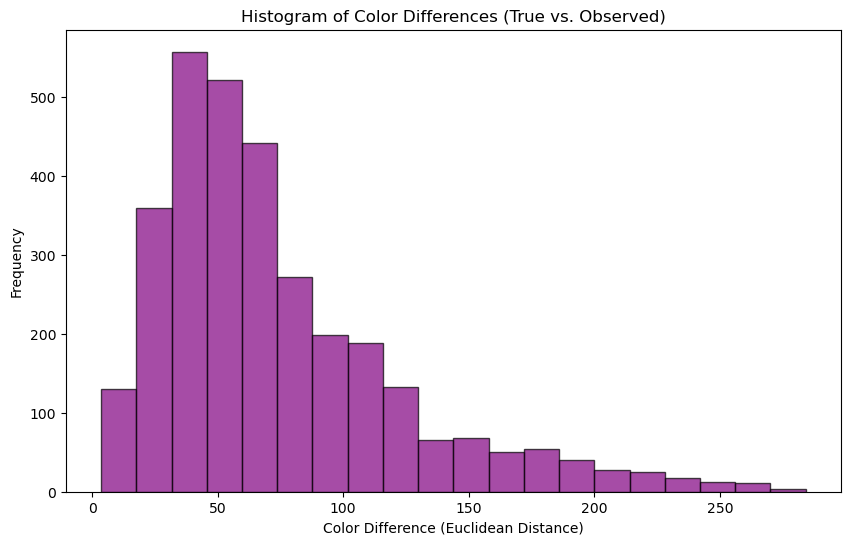

In [80]:
plt.figure(figsize=(10, 6))
plt.hist(color_diff, bins=20, color='purple', edgecolor='black', alpha=0.7)
plt.title("Histogram of Color Differences (True vs. Observed)")
plt.xlabel("Color Difference (Euclidean Distance)")
plt.ylabel("Frequency")
plt.show()


These are some effective ways to visualize and analyze the true and observed color values and their differences. Each visualization serves a specific purpose and can provide different insights:

- Heatmap and correlation matrix highlight the relationships between RGB channels.
- 3D scatter plot and pairwise comparison provide a spatial understanding.
- CDF and histogram offer insights into the distribution of differences.
- Box plot gives a good overview of the spread of the differences.

# 5. Load all the combined data values from the class
- preprocess the data, remove the nan values
- divide all the data into train, test, val sets (80, 10, 10)

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Step 1: Load the CSV file into a DataFrame
df = pd.read_csv('your_data.csv')

# Step 2: Handle NaNs (choose one method)
df_cleaned = df.dropna()  # Remove rows with NaNs

# Split the data into features (X) and target (y)
X = df_cleaned[['True R', 'True G', 'True B']]  # Features
y = df_cleaned[['Observed R', 'Observed G', 'Observed B']]  # Target

# Step 3: Split into Training, Testing, and Validation Sets (80%, 10%, 10%)

# First split (80% training, 20% testing + validation)
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.2, random_state=42)

# Check if the temp set has enough data to be split further
if len(X_temp) > 1:
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)
else:
    print("Not enough data in temp set for further splitting. Using all data as test set.")
    X_val, X_test, y_val, y_test = X_temp, y_temp, X_temp, y_temp

# Check the sizes of the splits
print(f"Training Set: {X_train.shape}, Validation Set: {X_val.shape}, Test Set: {X_test.shape}")

Training Set: (2539, 3), Validation Set: (317, 3), Test Set: (318, 3)


# 6. Train the models
- NN
    - Model Builder with EarlyStopping and Learning Rate Scheduling
- CNN
- ResNET
- Fully connected
- Transformer
- Random Forest
- sample diff
- weighted diff
- autoencoder
- HistGradientBoosting
- XGBoost

Epoch 1/50


80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 11010.3242 - mae: 85.1547 - val_loss: 1460.2037 - val_mae: 28.6624 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step - loss: 1307.5427 - mae: 27.0147 - val_loss: 1365.9845 - val_mae: 27.8355 - learning_rate: 0.0010
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step - loss: 1329.1787 - mae: 26.9977 - val_loss: 1365.0114 - val_mae: 28.1109 - learning_rate: 0.0010
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 441us/step - loss: 1283.4187 - mae: 26.5538 - val_loss: 1333.8027 - val_mae: 27.4736 - learning_rate: 0.0010
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 460us/step - loss: 1243.6641 - mae: 26.0328 - val_loss: 1316.5002 - val_mae: 27.1517 - learning_rate: 0.0010
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step - loss: 1190.5159 - mae: 25.5297 - val_loss: 1334.4054 - val_mae: 27.8554 - learning_rate: 0.0010
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 441us/step - loss: 1232.8175 - mae: 26.0292 - val_loss: 1379.9813 - val

80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 13365.5713 - mae: 95.8545 - val_loss: 1306.0719 - val_mae: 27.5797 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 477us/step - loss: 1437.6143 - mae: 28.7081 - val_loss: 1227.3959 - val_mae: 26.0262 - learning_rate: 0.0010
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 641us/step - loss: 1338.6180 - mae: 27.2512 - val_loss: 1248.5206 - val_mae: 25.9284 - learning_rate: 0.0010
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 478us/step - loss: 1346.5000 - mae: 27.5061 - val_loss: 1160.0094 - val_mae: 25.3191 - learning_rate: 0.0010
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step - loss: 1254.4594 - mae: 25.9944 - val_loss: 1156.5988 - val_mae: 25.5560 - learning_rate: 0.0010
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 1274.3755 - mae: 26.7198 - val_loss: 1144.1023 - val_mae: 25.3301 - learning_rate: 0.0010
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 457us/step - loss: 1312.0521 - mae: 26.7749 - val_loss: 1181.7223 - val

80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 9356.7656 - mae: 76.2562 - val_loss: 1455.3196 - val_mae: 29.4892 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 462us/step - loss: 1331.5530 - mae: 27.3417 - val_loss: 1360.0789 - val_mae: 27.9674 - learning_rate: 0.0010
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 459us/step - loss: 1307.1775 - mae: 26.7623 - val_loss: 1347.2679 - val_mae: 27.6814 - learning_rate: 0.0010
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 459us/step - loss: 1120.2040 - mae: 24.7049 - val_loss: 1333.8165 - val_mae: 27.3147 - learning_rate: 0.0010
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 469us/step - loss: 1265.3879 - mae: 26.4384 - val_loss: 1335.1445 - val_mae: 27.7380 - learning_rate: 0.0010
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 449us/step - loss: 1236.8994 - mae: 26.2133 - val_loss: 1456.0945 - val_mae: 29.8698 - learning_rate: 0.0010
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 537us/step - loss: 1292.5096 - mae: 26.7426 - val_loss: 1390.1339 - val_

80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 6455.8379 - mae: 62.7883 - val_loss: 1410.8883 - val_mae: 27.6018 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 489us/step - loss: 1312.2794 - mae: 27.2194 - val_loss: 1381.9967 - val_mae: 26.7654 - learning_rate: 0.0010
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 474us/step - loss: 1224.4191 - mae: 25.9996 - val_loss: 1356.5758 - val_mae: 27.1490 - learning_rate: 0.0010
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 482us/step - loss: 1198.7339 - mae: 25.8150 - val_loss: 1320.3842 - val_mae: 26.3357 - learning_rate: 0.0010
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 454us/step - loss: 1172.1350 - mae: 25.0660 - val_loss: 1332.2349 - val_mae: 26.8579 - learning_rate: 0.0010
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 469us/step - loss: 1139.4015 - mae: 25.0751 - val_loss: 1299.8639 - val_mae: 26.1355 - learning_rate: 0.0010
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 458us/step - loss: 1137.7762 - mae: 24.9012 - val_loss: 1327.7743 - val_

80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 13080.2188 - mae: 92.4252 - val_loss: 1272.9697 - val_mae: 27.2913 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 476us/step - loss: 1425.5067 - mae: 28.4615 - val_loss: 1205.8553 - val_mae: 26.4201 - learning_rate: 0.0010
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 482us/step - loss: 1386.0981 - mae: 28.0356 - val_loss: 1161.2190 - val_mae: 25.7558 - learning_rate: 0.0010
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 1357.8638 - mae: 27.3229 - val_loss: 1142.9835 - val_mae: 25.5071 - learning_rate: 0.0010
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 467us/step - loss: 1323.4725 - mae: 27.1588 - val_loss: 1106.6826 - val_mae: 24.9317 - learning_rate: 0.0010
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 463us/step - loss: 1243.9978 - mae: 26.1319 - val_loss: 1098.6969 - val_mae: 24.8827 - learning_rate: 0.0010
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 460us/step - loss: 1302.4685 - mae: 26.4404 - val_loss: 1070.6729 - val_m

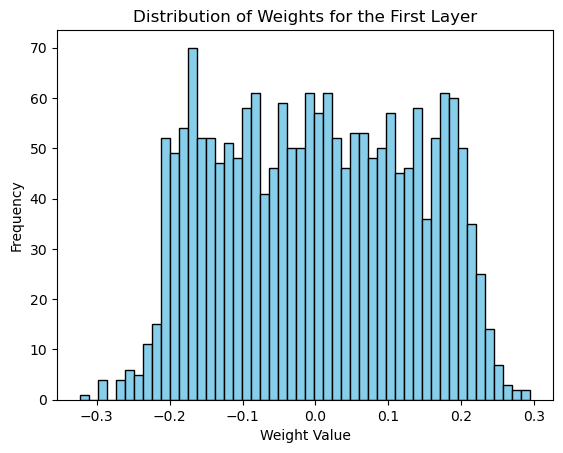

In [121]:
# 1. Neural Network (NN) with EarlyStopping and Learning Rate Scheduling (Keras)

from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error, roc_auc_score, roc_curve
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import tensorflow as tf

# Define K-Fold cross-validation
kfold = KFold(n_splits=5, shuffle=True, random_state=42)

# Define the Neural Network model
def build_nn_model(input_shape):
    model = Sequential()
    model.add(Dense(128, activation='relu', input_shape=input_shape))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(3))  # Output layer for 3 observed RGB values

    model.compile(optimizer=Adam(), loss='mean_squared_error', metrics=['mae'])
    return model

# Learning Rate Scheduler
def lr_schedule(epoch):
    initial_lr = 0.001
    drop = 0.5
    epochs_drop = 10
    return initial_lr * (drop ** (epoch // epochs_drop))

lr_scheduler = LearningRateScheduler(lr_schedule)

# EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

def evaluate_model_with_kfold(model_builder, X, y):
    rmse_list = []
    mse_list = []
    mae_list = []
    weights_list = []
    
    for train_idx, val_idx in kfold.split(X):
        # Convert DataFrame slices to NumPy arrays
        X_train, X_val = X.iloc[train_idx].values, X.iloc[val_idx].values
        y_train, y_val = y.iloc[train_idx].values, y.iloc[val_idx].values
        
        # Build and compile the model
        model = model_builder(X_train.shape[1:])
        
        # Fit the model
        model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), callbacks=[early_stopping, lr_scheduler])
        
        # Evaluate model
        y_pred = model.predict(X_val)
        
        # Compute evaluation metrics
        mse = mean_squared_error(y_val, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_val, y_pred)
        
        # Store the weights of the model
        model_weights = model.get_weights()
        weights_list.append(model_weights)  # Store weights as a list of arrays
        
        # For regression, we won't calculate AUC
        auc = 0  # Set AUC to 0 for regression models
        
        rmse_list.append(rmse)
        mse_list.append(mse)
        mae_list.append(mae)
    
    # Here we can't average weights directly due to varying shapes
    # You can either inspect individual weight distributions or perform analysis per fold
    return {
        'RMSE': np.mean(rmse_list),
        'MSE': np.mean(mse_list),
        'MAE': np.mean(mae_list),
        'Weights List': weights_list  # Return raw weights list for further inspection
    }

# Assuming X and y are your feature and label datasets
nn_results = evaluate_model_with_kfold(build_nn_model, X, y)

# Assuming nn_results is returned by the evaluate_model_with_kfold function
weights_list = nn_results['Weights List']

# Example function to plot weight distributions (for the first layer's weights as an example)
def plot_weight_distribution(weights_list):
    # Extract weights of the first layer from each fold
    first_layer_weights = [weights[0] for weights in weights_list]  # First layer weights
    
    # Flatten the weights from all folds
    flattened_weights = np.concatenate([w.flatten() for w in first_layer_weights])
    
    # Plot distribution
    plt.hist(flattened_weights, bins=50, color='skyblue', edgecolor='black')
    plt.title("Distribution of Weights for the First Layer")
    plt.xlabel("Weight Value")
    plt.ylabel("Frequency")
    plt.show()

# Now plot the weight distribution
plot_weight_distribution(weights_list)


In [110]:
# 3. ResNet (Keras with Transfer Learning)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler

# Reshape X_train and X_val to ensure they're 2D (samples, features)
X_train = X_train.reshape(-1, 3)
X_val = X_val.reshape(-1, 3)

# Define a simple fully connected model
def build_fully_connected_model(input_shape):
    model = Sequential()
    model.add(Dense(64, activation='relu', input_shape=input_shape))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(3))  # Output RGB

    model.compile(optimizer=Adam(), loss='mean_squared_error', metrics=['mae'])
    return model

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_scheduler = LearningRateScheduler(lambda epoch: 1e-3 * 0.9 ** epoch)

# Train the fully connected model
fc_model = build_fully_connected_model((3,))  # RGB values, so input shape is (3,)
fc_model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), callbacks=[early_stopping, lr_scheduler])


Epoch 1/50


80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 20211.7207 - mae: 116.1593 - val_loss: 1497.3253 - val_mae: 29.5955 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 408us/step - loss: 1355.9635 - mae: 27.7891 - val_loss: 1440.5425 - val_mae: 28.3576 - learning_rate: 9.0000e-04
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 405us/step - loss: 1345.3317 - mae: 27.1506 - val_loss: 1422.6171 - val_mae: 28.1186 - learning_rate: 8.1000e-04
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 386us/step - loss: 1326.6866 - mae: 27.2725 - val_loss: 1394.9337 - val_mae: 28.3398 - learning_rate: 7.2900e-04
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 384us/step - loss: 1249.4396 - mae: 26.3718 - val_loss: 1383.4236 - val_mae: 27.8884 - learning_rate: 6.5610e-04
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 376us/step - loss: 1247.3832 - mae: 26.2583 - val_loss: 1374.4293 - val_mae: 27.9037 - learning_rate: 5.9049e-04
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 372us/step - loss: 1294.5604 - mae: 26.8591 - val_

In [111]:
# 4. Transformer Model (Keras)

from tensorflow.keras.layers import MultiHeadAttention, LayerNormalization, Dropout, Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
import tensorflow as tf

# Transformer Encoder Block
def transformer_encoder(inputs, num_heads, ff_dim):
    attention = MultiHeadAttention(num_heads=num_heads, key_dim=inputs.shape[-1])(inputs, inputs)
    attention = Dropout(0.1)(attention)
    attention = LayerNormalization()(attention)
    ffn = Dense(ff_dim, activation='relu')(attention)
    ffn = Dense(inputs.shape[-1])(ffn)
    ffn = Dropout(0.1)(ffn)
    return LayerNormalization()(ffn)

# Define Transformer model
def build_transformer_model(input_shape, num_heads=4, ff_dim=128):
    inputs = tf.keras.Input(shape=input_shape)
    
    # Reshape the input to have a sequence length dimension for transformer
    x = tf.keras.layers.Reshape((-1, input_shape[-1]))(inputs)  # Reshape to (batch_size, seq_len, feature_dim)
    
    x = transformer_encoder(x, num_heads, ff_dim)
    x = Dense(64, activation='relu')(x)
    x = Dense(3)(x)  # RGB Output

    model = tf.keras.Model(inputs=inputs, outputs=x)
    model.compile(optimizer=Adam(), loss='mean_squared_error', metrics=['mae'])
    return model

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_scheduler = LearningRateScheduler(lambda epoch: 1e-3 * 0.9 ** epoch)

# Reshape X_train and X_val to have the right shape for the transformer (n_samples, seq_len, features)
X_train_reshaped = X_train.reshape(-1, 1, 3)  # (n_samples, 1, 3) for RGB
X_val_reshaped = X_val.reshape(-1, 1, 3)

# Train Transformer model
transformer_model = build_transformer_model((1, 3))  # Input shape is now (1, 3)
transformer_model.fit(X_train_reshaped, y_train, epochs=50, validation_data=(X_val_reshaped, y_val), callbacks=[early_stopping, lr_scheduler])


Epoch 1/50


80/80 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 28406.5781 - mae: 162.7289 - val_loss: 26791.0527 - val_mae: 156.9482 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 709us/step - loss: 27133.7969 - mae: 158.8335 - val_loss: 24449.0352 - val_mae: 149.3376 - learning_rate: 9.0000e-04
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 690us/step - loss: 23763.0508 - mae: 147.9439 - val_loss: 20637.2539 - val_mae: 136.0709 - learning_rate: 8.1000e-04
Epoch 4/50


80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 706us/step - loss: 20094.7520 - mae: 134.5950 - val_loss: 15831.6387 - val_mae: 117.3577 - learning_rate: 7.2900e-04
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 708us/step - loss: 14927.3555 - mae: 114.2399 - val_loss: 11009.9316 - val_mae: 95.4853 - learning_rate: 6.5610e-04
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 731us/step - loss: 10206.9746 - mae: 91.9591 - val_loss: 7187.0088 - val_mae: 74.9741 - learning_rate: 5.9049e-04
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 6676.1206 - mae: 71.6962 - val_loss: 4636.0039 - val_mae: 58.8082 - learning_rate: 5.3144e-04
Epoch 8/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 677us/step - loss: 4258.3872 - mae: 56.2210 - val_loss: 3210.2024 - val_mae: 47.9474 - learning_rate: 4.7830e-04
Epoch 9/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 675us/step - loss: 3086.0137 - mae: 47.1816 - val_loss: 2502.2700 - val_mae: 41.5652 - learning_rate: 4.3047e-04
Epoch 10/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 670us/step - loss: 2294.0896 - mae: 39.

In [ ]:
# 5. Random Forest (Scikit-learn)

from sklearn.ensemble import RandomForestRegressor

# Train Random Forest model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predict with Random Forest
rf_predictions = rf_model.predict(X_test)


In [96]:
# 6. Sample Difference and Weighted Difference

# Sample difference
sample_diff = np.abs(y_test - rf_predictions)

# Weighted difference (assuming equal weights for simplicity)
weights = np.array([1, 1, 1])
weighted_diff = np.sum(weights * sample_diff, axis=1)


In [97]:
# 8. Autoencoder (Keras)

from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.models import Model

# Define Autoencoder
def build_autoencoder(input_shape):
    inputs = Input(shape=input_shape)
    encoded = Dense(128, activation='relu')(inputs)
    encoded = Dense(64, activation='relu')(encoded)
    decoded = Dense(128, activation='relu')(encoded)
    decoded = Dense(input_shape[0])(decoded)

    autoencoder = Model(inputs, decoded)
    autoencoder.compile(optimizer=Adam(), loss='mean_squared_error')

    return autoencoder

# Train Autoencoder
autoencoder_model = build_autoencoder((X_train.shape[1],))
autoencoder_model.fit(X_train, X_train, epochs=50, validation_data=(X_val, X_val))


Epoch 1/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 960us/step - loss: 10687.3193 - val_loss: 84.7796
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 448us/step - loss: 45.9149 - val_loss: 23.6400
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 430us/step - loss: 14.0464 - val_loss: 3.0781
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 430us/step - loss: 0.7557 - val_loss: 0.9691
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 440us/step - loss: 0.3815 - val_loss: 0.4903
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 422us/step - loss: 0.1926 - val_loss: 0.3115
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 446us/step - loss: 0.2264 - val_loss: 0.1841
Epoch 8/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 436us/step - loss: 0.0544 - val_loss: 0.1986
Epoch 9/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step - loss: 0.0968 - val_loss: 0.1920
Epoch 10/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 437us/step - loss: 0.1081 - val_loss: 0.1632
Epoch 11/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 431us/step - loss: 0.0514 - val_loss: 0.1636
Epoch 12/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 44

In [ ]:
# 8. XGBoost (XGBoost)

import xgboost as xgb

# Train XGBoost model
xgb_model = xgb.XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train, y_train)

# Predict with XGBoost
xgb_predictions = xgb_model.predict(X_test)


# 7. Cross-validation evaluation
- kfold cross validation
- loss
- learning rate
- rmse
- mse
- roc
- auc
- distribution of weights

Epoch 1/50


80/80 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 5366.0464 - mae: 55.6529 - val_loss: 1426.0383 - val_mae: 28.2226 - learning_rate: 0.0010
Epoch 2/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 534us/step - loss: 1278.7379 - mae: 26.7148 - val_loss: 1365.9382 - val_mae: 27.8218 - learning_rate: 0.0010
Epoch 3/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 479us/step - loss: 1299.6794 - mae: 26.7526 - val_loss: 1399.9615 - val_mae: 28.8346 - learning_rate: 0.0010
Epoch 4/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 532us/step - loss: 1326.7988 - mae: 26.9311 - val_loss: 1347.3861 - val_mae: 27.7697 - learning_rate: 0.0010
Epoch 5/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 510us/step - loss: 1160.9756 - mae: 25.2733 - val_loss: 1348.9639 - val_mae: 27.3080 - learning_rate: 0.0010
Epoch 6/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 507us/step - loss: 1339.6838 - mae: 27.1522 - val_loss: 1329.3811 - val_mae: 27.2340 - learning_rate: 0.0010
Epoch 7/50
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 514us/step - loss: 1183.3491 - mae: 25.7691 - val_loss: 1324.8547 - val_

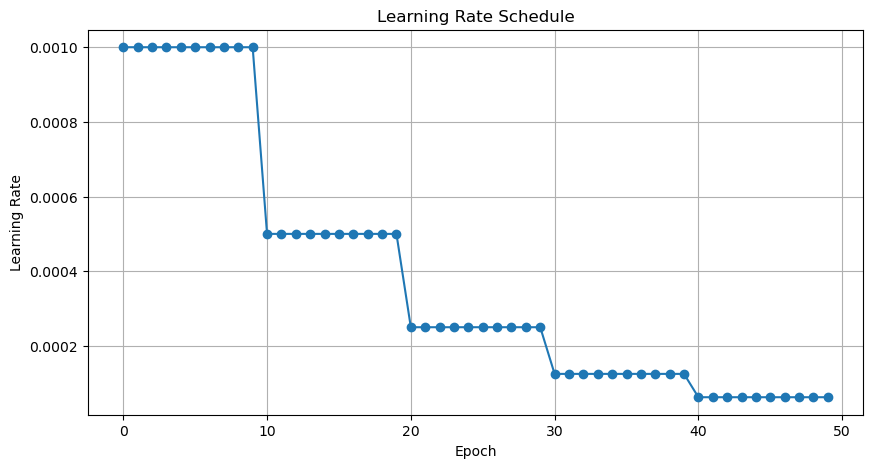

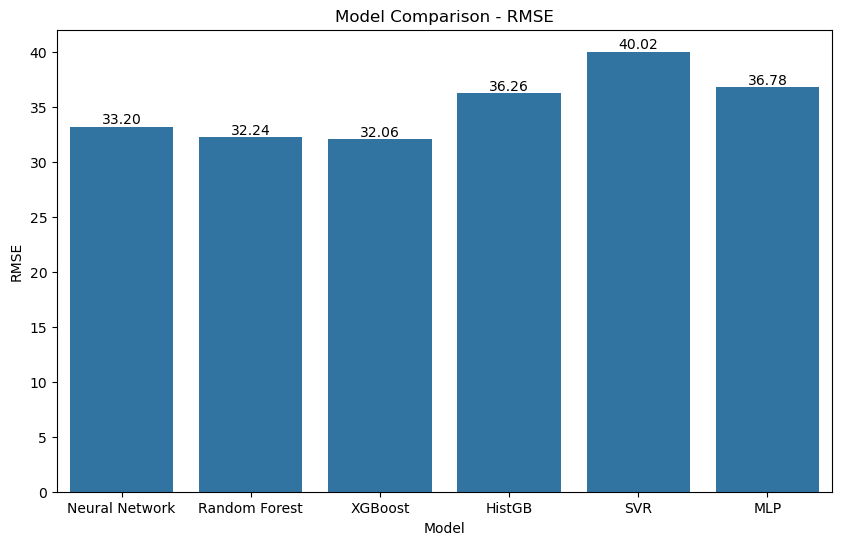

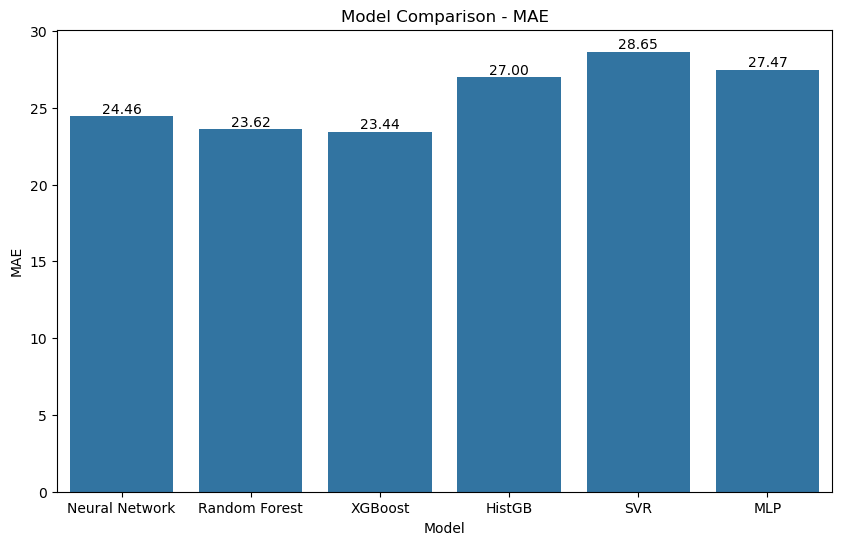

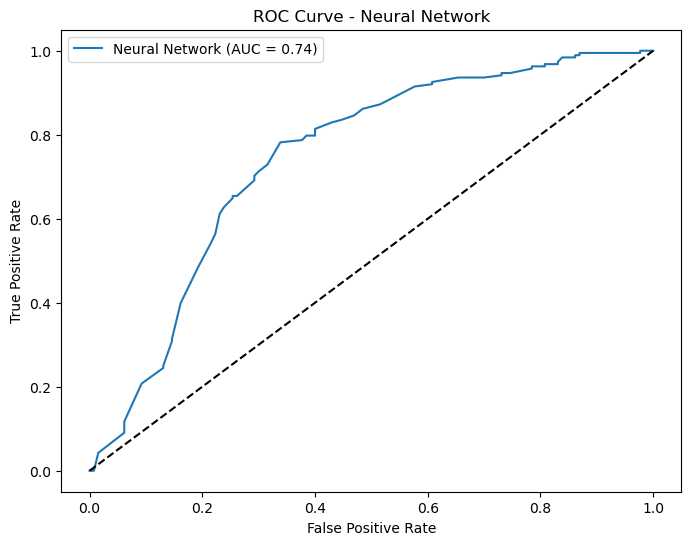

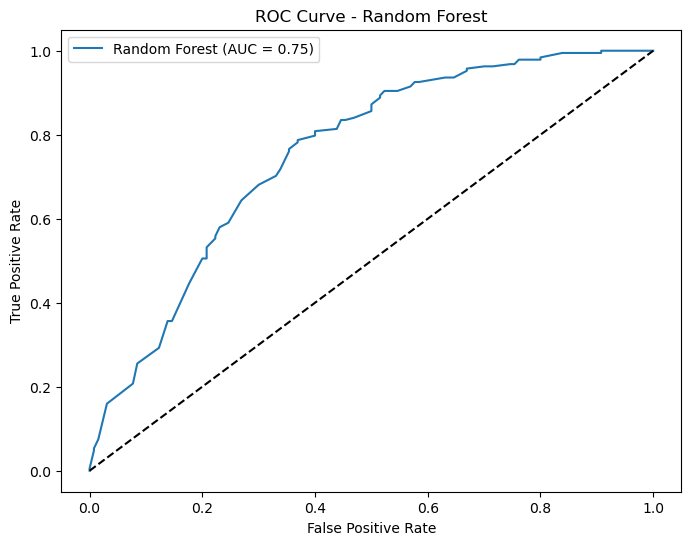

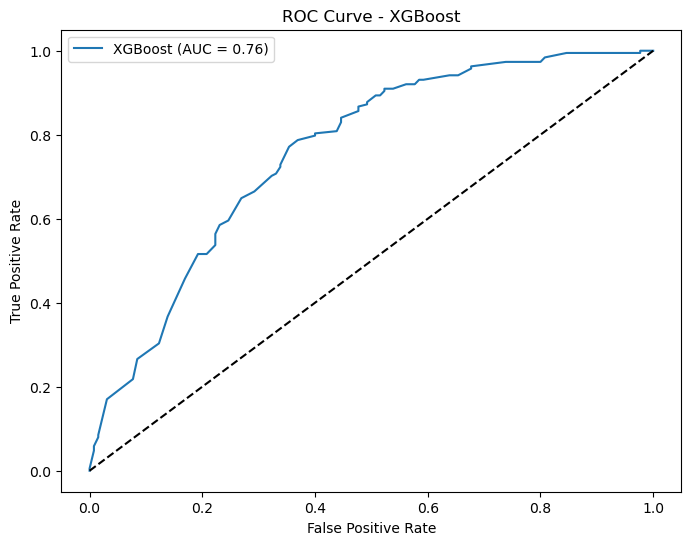

In [130]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error, roc_curve, auc
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

# Load Data
df = pd.read_csv('your_data.csv').dropna()
X = df[['True R', 'True G', 'True B']]
y = df[['Observed R', 'Observed G', 'Observed B']].values  # Convert y to numpy array

# Split Data
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.2, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Learning Rate Scheduler
def lr_schedule(epoch, lr):
    if epoch % 10 == 0 and epoch != 0:
        return lr * 0.5
    return lr

# Track Learning Rate
def lr_tracker():
    lrs = [0.001 * (0.5 ** (epoch // 10)) for epoch in range(50)]
    plt.figure(figsize=(10, 5))
    plt.plot(range(50), lrs, marker='o')
    plt.xlabel("Epoch")
    plt.ylabel("Learning Rate")
    plt.title("Learning Rate Schedule")
    plt.grid()
    plt.show()

# Define Model Evaluation Function
def evaluate_model(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    mae = mean_absolute_error(y_test, y_pred)
    return rmse, mae, y_test, y_pred

# Neural Network Model
def build_nn_model(input_shape):
    model = Sequential([
        Dense(128, activation='relu', input_shape=input_shape),
        Dense(64, activation='relu'),
        Dense(32, activation='relu'),
        Dense(3)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=['mae'])
    return model

nn_model = build_nn_model((X_train.shape[1],))
nn_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=32,
              callbacks=[EarlyStopping(monitor='val_loss', patience=10), LearningRateScheduler(lr_schedule)])
nn_rmse, nn_mae, y_test_nn, y_pred_nn = evaluate_model(nn_model, X_train, y_train, X_test, y_test)

# Random Forest Model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_rmse, rf_mae, y_test_rf, y_pred_rf = evaluate_model(rf_model, X_train, y_train, X_test, y_test)

# XGBoost Model
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, learning_rate=0.1)
xgb_rmse, xgb_mae, y_test_xgb, y_pred_xgb = evaluate_model(xgb_model, X_train, y_train, X_test, y_test)

# HistGradientBoosting Model
hgb_model = HistGradientBoostingRegressor()
hgb_rmse, hgb_mae, y_test_hgb, y_pred_hgb = evaluate_model(hgb_model, X_train, y_train[:, 0], X_test, y_test[:, 0])

# Support Vector Regression (SVR)
svr_model = make_pipeline(StandardScaler(), SVR(kernel='rbf'))
svr_rmse, svr_mae, y_test_svr, y_pred_svr = evaluate_model(svr_model, X_train, y_train[:, 0], X_test, y_test[:, 0])

# Multi-Layer Perceptron (MLP)
mlp_model = MLPRegressor(hidden_layer_sizes=(100,50,25), max_iter=500, random_state=42, learning_rate_init=0.01)
mlp_rmse, mlp_mae, y_test_mlp, y_pred_mlp = evaluate_model(mlp_model, X_train, y_train[:, 0], X_test, y_test[:, 0])

# Compare Models
results = pd.DataFrame({
    'Model': ['Neural Network', 'Random Forest', 'XGBoost', 'HistGB', 'SVR', 'MLP'],
    'RMSE': [nn_rmse, rf_rmse, xgb_rmse, hgb_rmse, svr_rmse, mlp_rmse],
    'MAE': [nn_mae, rf_mae, xgb_mae, hgb_mae, svr_mae, mlp_mae]
})
print(results)

# Learning Rate Visualization
lr_tracker()

# Visualization with values
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Model', y='RMSE', data=results)
for p in ax.patches:
    ax.annotate(f"{p.get_height():.2f}", (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')
plt.title('Model Comparison - RMSE')
plt.show()

plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Model', y='MAE', data=results)
for p in ax.patches:
    ax.annotate(f"{p.get_height():.2f}", (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')
plt.title('Model Comparison - MAE')
plt.show()

# ROC Curve and AUC (for regression, approximate using classification thresholding)
def plot_roc(y_test, y_pred, model_name):
    fpr, tpr, _ = roc_curve(y_test > np.mean(y_test), y_pred)
    roc_auc = auc(fpr, tpr)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, label=f'{model_name} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve - {model_name}')
    plt.legend()
    plt.show()

# Plot ROC for selected models
plot_roc(y_test_nn[:, 0], y_pred_nn[:, 0], 'Neural Network')
plot_roc(y_test_rf[:, 0], y_pred_rf[:, 0], 'Random Forest')
plot_roc(y_test_xgb[:, 0], y_pred_xgb[:, 0], 'XGBoost')

Simple Difference Model MSE: 119199.88346456691, RMSE: 345.2533612646905, MAE: 320.9984251968504, R2: -100.86442662672135
Weighted Difference Model MSE: 6.56906354116463e+167, RMSE: 8.104975966136254e+83, MAE: 6.864263231206437e+83, R2: -6.182826190849498e+164


20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 850us/step
Neural Network Model MSE: 11.684546354618801, RMSE: 3.418266571614742, MAE: 2.049488497155858, R2: 0.9897403347711666
Random Forest Model MSE: 18.068125459317596, RMSE: 4.250661767221382, MAE: 0.4819107611548558, R2: 0.9822376692339213

Model Comparison:
Simple Difference Model MSE: 119199.88346456691, RMSE: 345.2533612646905, MAE: 320.9984251968504, R2: -100.86442662672135
Weighted Difference Model MSE: 6.56906354116463e+167, RMSE: 8.104975966136254e+83, MAE: 6.864263231206437e+83, R2: -6.182826190849498e+164
Neural Network Model MSE: 11.684546354618801, RMSE: 3.418266571614742, MAE: 2.049488497155858, R2: 0.9897403347711666
Random Forest Model MSE: 18.068125459317596, RMSE: 4.250661767221382, MAE: 0.4819107611548558, R2: 0.9822376692339213


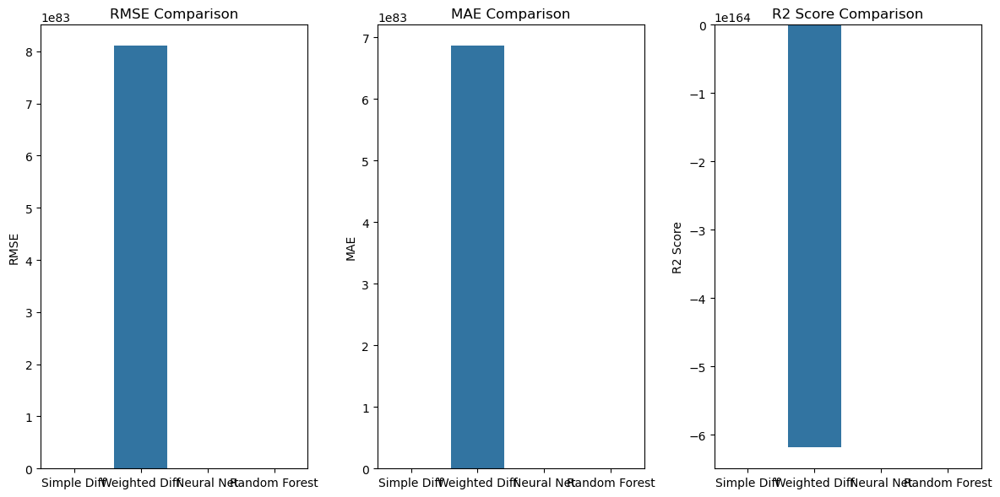

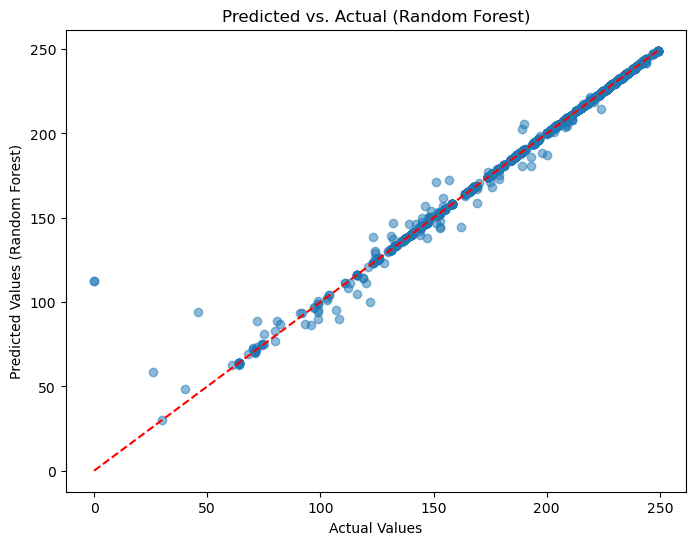

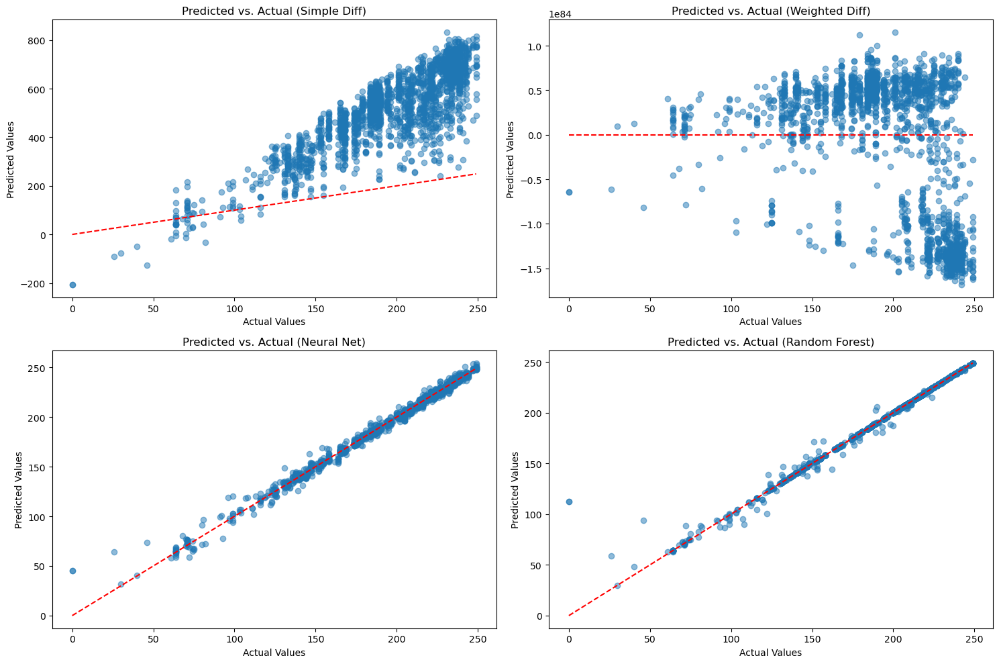

In [147]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.ensemble import RandomForestRegressor

# Load the data from the CSV file (replace 'your_data.csv' with your file path)
df = pd.read_csv('your_data.csv')

# Handle NaNs (choose one method)
df = df.dropna()  # Remove rows with NaNs
# df = df.fillna(df.mean())  # Fill with the mean
# df = df.fillna(0) #Fill with 0
# df = df.interpolate()  # Interpolate

# Extract relevant columns and convert to numpy arrays
true_r = df['True R'].values
true_g = df['True G'].values
true_b = df['True B'].values
obs_r = df['Observed R'].values
obs_g = df['Observed G'].values
obs_b = df['Observed B'].values
red_r = df['Red R'].values
red_g = df['Red G'].values
red_b = df['Red B'].values
green_r = df['Green R'].values
green_g = df['Green G'].values
green_b = df['Green B'].values
blue_r = df['Blue R'].values
blue_g = df['Blue G'].values
blue_b = df['Blue B'].values

# Create input features (X) and target (y)
X = np.column_stack((obs_r, obs_g, obs_b, red_r, red_g, red_b, green_r, green_g, green_b, blue_r, blue_g, blue_b, 
                      true_r, true_g, true_b))
y = np.column_stack((true_r, true_g, true_b))

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize the data (important for neural networks)
X_mean = X_train.mean(axis=0)
X_std = X_train.std(axis=0)
X_train_scaled = (X_train - X_mean) / X_std
X_test_scaled = (X_test - X_mean) / X_std

# 1. Simple Difference Model
def simple_difference_model(X):
    obs_r = X[:, 0]
    obs_g = X[:, 1]
    obs_b = X[:, 2]
    red_r = X[:, 3]
    red_g = X[:, 4]
    red_b = X[:, 5]
    green_r = X[:, 6]
    green_g = X[:, 7]
    green_b = X[:, 8]
    blue_r = X[:, 9]
    blue_g = X[:, 10]
    blue_b = X[:, 11]
    true_r = X[:, 12]
    true_g = X[:, 13]
    true_b = X[:, 14]

    red_diff_r = true_r - red_r
    red_diff_g = true_g - red_g
    red_diff_b = true_b - red_b
    
    green_diff_r = true_r - green_r
    green_diff_g = true_g - green_g
    green_diff_b = true_b - green_b
    
    blue_diff_r = true_r - blue_r
    blue_diff_g = true_g - blue_g
    blue_diff_b = true_b - blue_b

    corrected_r = obs_r + red_diff_r + green_diff_r + blue_diff_r
    corrected_g = obs_g + red_diff_g + green_diff_g + blue_diff_g
    corrected_b = obs_b + red_diff_b + green_diff_b + blue_diff_b

    corrected_color = np.column_stack((corrected_r, corrected_g, corrected_b))
    return corrected_color

y_pred_simple = simple_difference_model(X_test)
mse_simple = mean_squared_error(y_test, y_pred_simple)
rmse_simple = np.sqrt(mse_simple)
mae_simple = mean_absolute_error(y_test, y_pred_simple)
r2_simple = r2_score(y_test, y_pred_simple)
print(f"Simple Difference Model MSE: {mse_simple}, RMSE: {rmse_simple}, MAE: {mae_simple}, R2: {r2_simple}")

def apply_weights(X, weights):
    # Unpack the X values into their respective columns
    obs_r = X[:, 0]
    obs_g = X[:, 1]
    obs_b = X[:, 2]
    red_r = X[:, 3]
    red_g = X[:, 4]
    red_b = X[:, 5]
    green_r = X[:, 6]
    green_g = X[:, 7]
    green_b = X[:, 8]
    blue_r = X[:, 9]
    blue_g = X[:, 10]
    blue_b = X[:, 11]
    true_r = X[:, 12]
    true_g = X[:, 13]
    true_b = X[:, 14]
    
    # Calculate the differences for each color channel
    red_diff_r = true_r - red_r
    red_diff_g = true_g - red_g
    red_diff_b = true_b - red_b
    
    green_diff_r = true_r - green_r
    green_diff_g = true_g - green_g
    green_diff_b = true_b - green_b
    
    blue_diff_r = true_r - blue_r
    blue_diff_g = true_g - blue_g
    blue_diff_b = true_b - blue_b

    # Calculate the weighted differences
    weighted_diff_r = weights[0] * red_diff_r + weights[1] * green_diff_r + weights[2] * blue_diff_r
    weighted_diff_g = weights[3] * red_diff_g + weights[4] * green_diff_g + weights[5] * blue_diff_g
    weighted_diff_b = weights[6] * red_diff_b + weights[7] * green_diff_b + weights[8] * blue_diff_b

    # Apply the weighted differences to the observed colors to get corrected colors
    corrected_r = obs_r + weighted_diff_r
    corrected_g = obs_g + weighted_diff_g
    corrected_b = obs_b + weighted_diff_b
    
    corrected_color = np.column_stack((corrected_r, corrected_g, corrected_b))
    return corrected_color


# 2. Weighted Difference Model (Trainable Weights)
def weighted_difference_model(X_train, y_train, X_test):
    # Initialize weights
    weights = np.random.rand(9)  # 9 weights for red, green, blue diffs (r, g, b each)

    # Training (Gradient Descent)
    learning_rate = 0.00001
    epochs = 1000
    
    for epoch in range(epochs):
        y_pred_train = apply_weights(X_train, weights)
        error = y_pred_train - y_train
        
        # Calculate gradients
        red_diff_r = X_train[:, 12] - X_train[:, 3]
        red_diff_g = X_train[:, 13] - X_train[:, 4]
        red_diff_b = X_train[:, 14] - X_train[:, 5]
        
        green_diff_r = X_train[:, 12] - X_train[:, 6]
        green_diff_g = X_train[:, 13] - X_train[:, 7]
        green_diff_b = X_train[:, 14] - X_train[:, 8]
        
        blue_diff_r = X_train[:, 12] - X_train[:, 9]
        blue_diff_g = X_train[:, 13] - X_train[:, 10]
        blue_diff_b = X_train[:, 14] - X_train[:, 11]
        
        grad_r = np.mean(error * np.column_stack((red_diff_r, green_diff_r, blue_diff_r)), axis=0)
        grad_g = np.mean(error * np.column_stack((red_diff_g, green_diff_g, blue_diff_g)), axis=0)
        grad_b = np.mean(error * np.column_stack((red_diff_b, green_diff_b, blue_diff_b)), axis=0)
        
        gradients = np.concatenate((grad_r, grad_g, grad_b))
        
        # Update weights
        weights -= learning_rate * gradients
    
    y_pred_test = apply_weights(X_test, weights)
    return y_pred_test

y_pred_weighted = weighted_difference_model(X_train, y_train, X_test)
mse_weighted = mean_squared_error(y_test, y_pred_weighted)
rmse_weighted = np.sqrt(mse_weighted)
mae_weighted = mean_absolute_error(y_test, y_pred_weighted)
r2_weighted = r2_score(y_test, y_pred_weighted)
print(f"Weighted Difference Model MSE: {mse_weighted}, RMSE: {rmse_weighted}, MAE: {mae_weighted}, R2: {r2_weighted}")

# 3. Neural Network Model
model_nn = keras.Sequential([
    layers.Dense(128, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    layers.Dense(64, activation='relu'),
    layers.Dense(3)  # Output RGB
])

model_nn.compile(optimizer='adam', loss='mse')
model_nn.fit(X_train_scaled, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=0)

y_pred_nn = model_nn.predict(X_test_scaled)
mse_nn = mean_squared_error(y_test, y_pred_nn)
rmse_nn = np.sqrt(mse_nn)
mae_nn = mean_absolute_error(y_test, y_pred_nn)
r2_nn = r2_score(y_test, y_pred_nn)
print(f"Neural Network Model MSE: {mse_nn}, RMSE: {rmse_nn}, MAE: {mae_nn}, R2: {r2_nn}")

# 4. Random Forest Model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

y_pred_rf = rf_model.predict(X_test)
mse_rf = mean_squared_error(y_test, y_pred_rf)
rmse_rf = np.sqrt(mse_rf)
mae_rf = mean_absolute_error(y_test, y_pred_rf)
r2_rf = r2_score(y_test, y_pred_rf)
print(f"Random Forest Model MSE: {mse_rf}, RMSE: {rmse_rf}, MAE: {mae_rf}, R2: {r2_rf}")

# Compare Results
print("\nModel Comparison:")
print(f"Simple Difference Model MSE: {mse_simple}, RMSE: {rmse_simple}, MAE: {mae_simple}, R2: {r2_simple}")
print(f"Weighted Difference Model MSE: {mse_weighted}, RMSE: {rmse_weighted}, MAE: {mae_weighted}, R2: {r2_weighted}")
print(f"Neural Network Model MSE: {mse_nn}, RMSE: {rmse_nn}, MAE: {mae_nn}, R2: {r2_nn}")
print(f"Random Forest Model MSE: {mse_rf}, RMSE: {rmse_rf}, MAE: {mae_rf}, R2: {r2_rf}")

# Visualizations
models = ['Simple Diff', 'Weighted Diff', 'Neural Net', 'Random Forest']
mses = [mse_simple, mse_weighted, mse_nn, mse_rf]
rmses = [rmse_simple, rmse_weighted, rmse_nn, rmse_rf]
maes = [mae_simple, mae_weighted, mae_nn, mae_rf]
r2s = [r2_simple, r2_weighted, r2_nn, r2_rf]

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
sns.barplot(x=models, y=rmses)
plt.title('RMSE Comparison')
plt.ylabel('RMSE')

plt.subplot(1, 3, 2)
sns.barplot(x=models, y=maes)
plt.title('MAE Comparison')
plt.ylabel('MAE')

plt.subplot(1, 3, 3)
sns.barplot(x=models, y=r2s)
plt.title('R2 Score Comparison')
plt.ylabel('R2 Score')

plt.tight_layout()
plt.show()

# Scatter Plot of Predicted vs. Actual (Random Forest)
plt.figure(figsize=(8, 6))
plt.scatter(y_test.flatten(), y_pred_rf.flatten(), alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')  # Diagonal line
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values (Random Forest)')
plt.title('Predicted vs. Actual (Random Forest)')
plt.show()

# Visualizations
models = ['Simple Diff', 'Weighted Diff', 'Neural Net', 'Random Forest']
y_preds = [y_pred_simple, y_pred_weighted, y_pred_nn, y_pred_rf]

# Scatter Plots for all models
plt.figure(figsize=(15, 10))
for i, model_name in enumerate(models):
    plt.subplot(2, 2, i + 1)
    plt.scatter(y_test.flatten(), y_preds[i].flatten(), alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')  # Diagonal line
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title(f'Predicted vs. Actual ({model_name})')

plt.tight_layout()
plt.show()


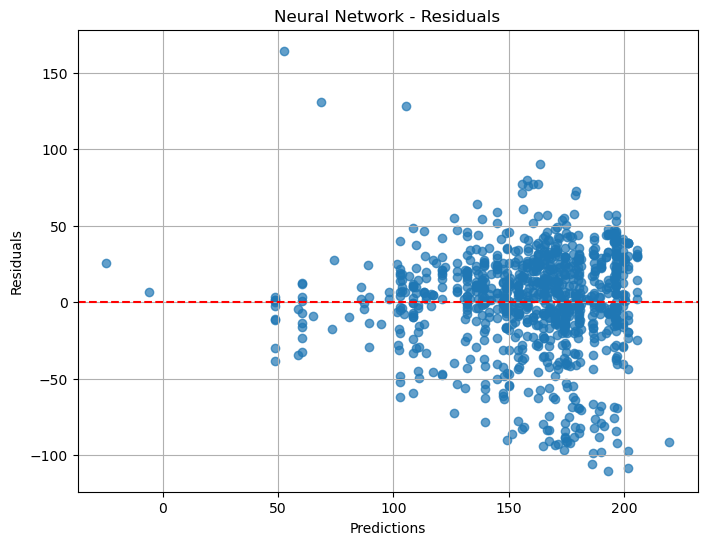

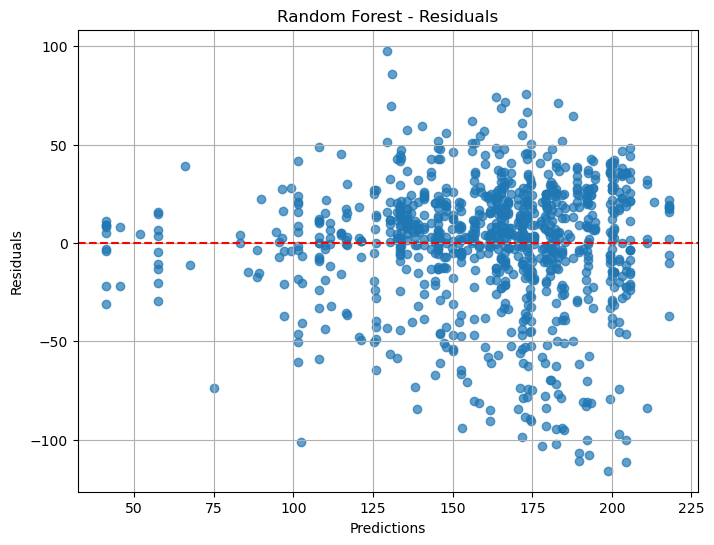

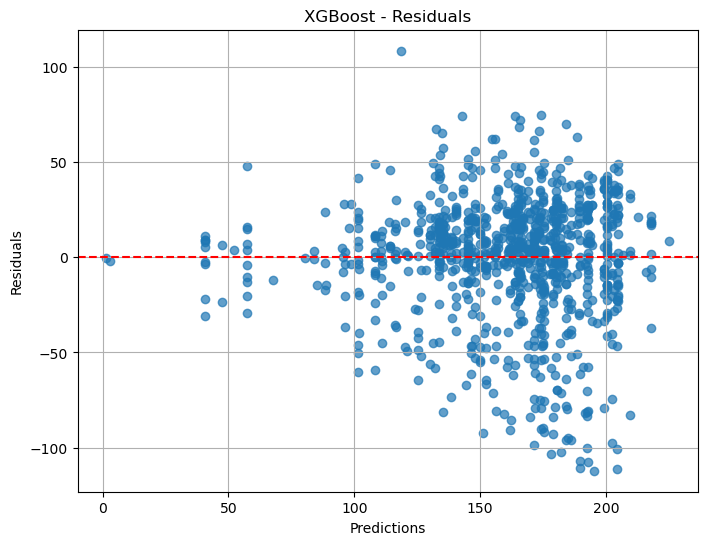

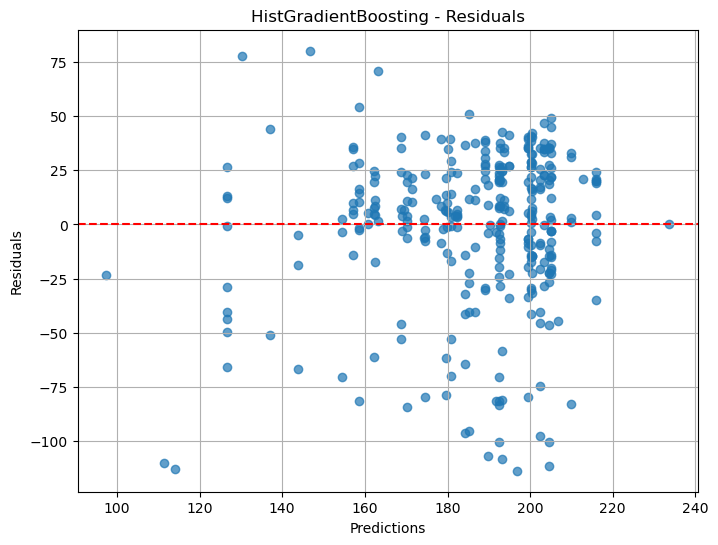

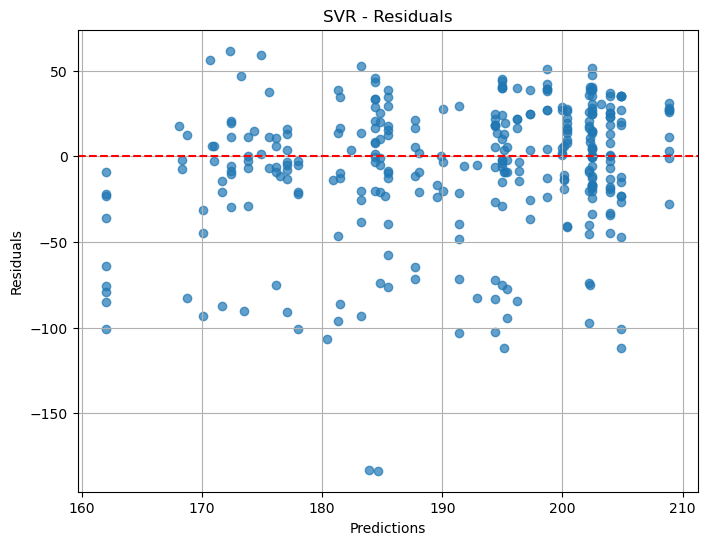

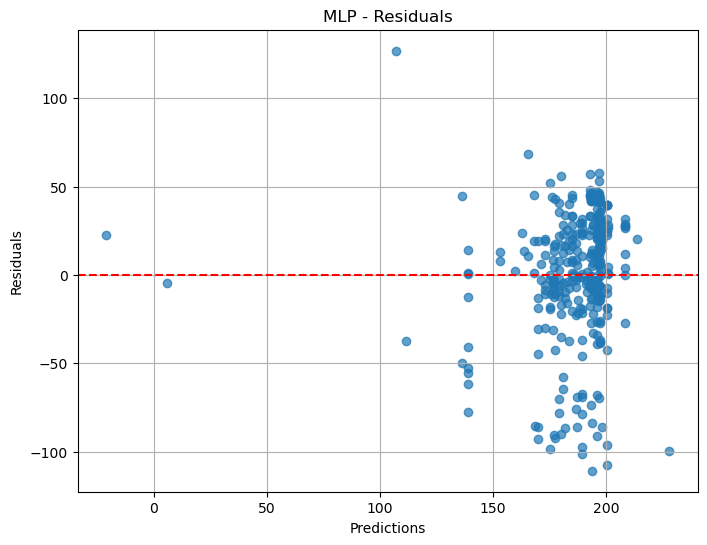

In [132]:
# Residual Plot
def plot_residuals(y_test, y_pred, model_name):
    residuals = y_test - y_pred
    plt.figure(figsize=(8, 6))
    plt.scatter(y_pred, residuals, alpha=0.7)
    plt.axhline(y=0, color='r', linestyle='--')
    plt.xlabel('Predictions')
    plt.ylabel('Residuals')
    plt.title(f'{model_name} - Residuals')
    plt.grid(True)
    plt.show()

# Residual plots for selected models
plot_residuals(y_test_nn, y_pred_nn, 'Neural Network')
plot_residuals(y_test_rf, y_pred_rf, 'Random Forest')
plot_residuals(y_test_xgb, y_pred_xgb, 'XGBoost')
plot_residuals(y_test_hgb, y_pred_hgb, 'HistGradientBoosting')
plot_residuals(y_test_svr, y_pred_svr, 'SVR')
plot_residuals(y_test_mlp, y_pred_mlp, 'MLP')


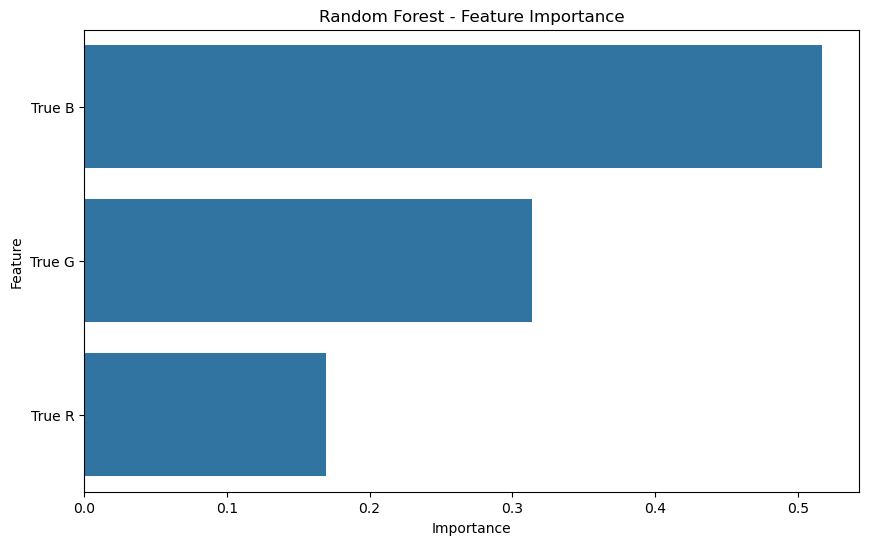

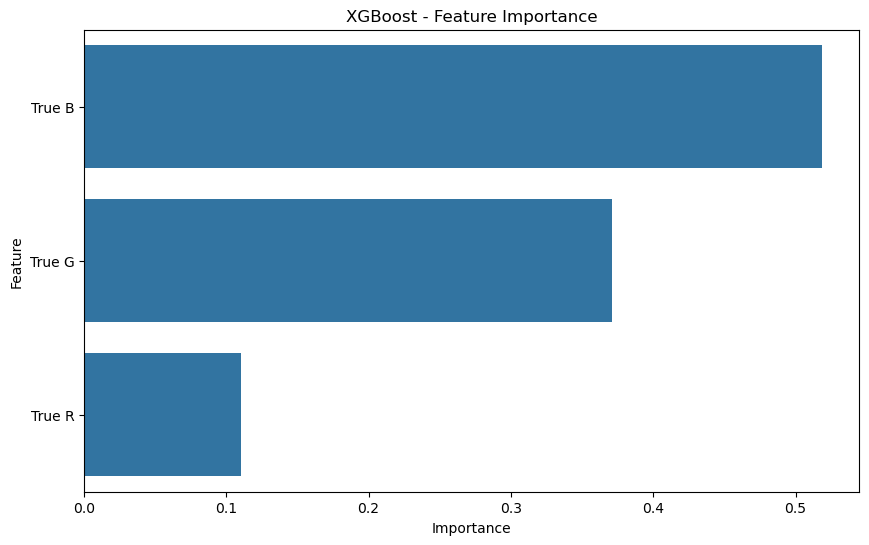

Model HistGradientBoosting does not support feature importance visualization.


In [133]:
# Feature Importance Plot (for Random Forest, XGBoost, HistGradientBoosting)
def plot_feature_importance(model, model_name, feature_names):
    if hasattr(model, 'feature_importances_'):
        feature_importances = model.feature_importances_
    elif hasattr(model, 'get_booster'):
        feature_importances = model.feature_importances_
    else:
        print(f"Model {model_name} does not support feature importance visualization.")
        return

    importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    }).sort_values(by='Importance', ascending=False)
    
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=importance_df)
    plt.title(f'{model_name} - Feature Importance')
    plt.show()

# Feature importance for tree-based models
plot_feature_importance(rf_model, 'Random Forest', X.columns)
plot_feature_importance(xgb_model, 'XGBoost', X.columns)
plot_feature_importance(hgb_model, 'HistGradientBoosting', X.columns)


Epoch 1/10


70/70 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 10133.8994 - mae: 81.1303 - val_loss: 2217.2480 - val_mae: 33.5795
Epoch 2/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 570us/step - loss: 2596.8989 - mae: 37.7745 - val_loss: 2246.2461 - val_mae: 33.5919
Epoch 3/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 471us/step - loss: 2311.5354 - mae: 35.2228 - val_loss: 2204.8896 - val_mae: 33.1074
Epoch 4/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 447us/step - loss: 2330.6973 - mae: 35.1930 - val_loss: 2326.7554 - val_mae: 34.5542
Epoch 5/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 513us/step - loss: 2246.0283 - mae: 34.2467 - val_loss: 2432.8450 - val_mae: 35.4977
Epoch 6/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 449us/step - loss: 2173.7312 - mae: 33.2345 - val_loss: 2282.2949 - val_mae: 33.8820
Epoch 7/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 479us/step - loss: 1983.2469 - mae: 31.3838 - val_loss: 2162.7883 - val_mae: 32.5263
Epoch 8/10
70/70 ━━━━━━━━━━━━━━━━━━━━ 0s 475us/step - loss: 1953.8335 - mae: 31.4512 - val_loss: 2475.4275 - val_mae: 35.9167
Epoc

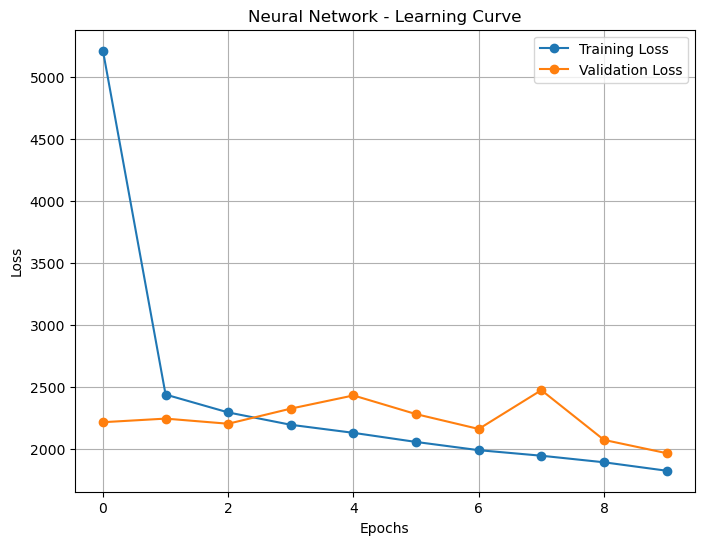

15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 673us/step - loss: 2728.8025 - mae: 35.8601
Test Loss: 2417.9048, Test MAE: 33.2066


In [162]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Load the data from CSV
df = pd.read_csv('your_data.csv')  # Replace with the actual filename

# Handle missing values (choose one method)
df = df.dropna()  # Remove rows with NaNs
# df = df.fillna(df.mean())  # Fill NaNs with the column mean
# df = df.interpolate()  # Interpolate missing values

# Define feature columns
features = ['Observed R', 'Observed G', 'Observed B', 
            'Red R', 'Red G', 'Red B', 
            'Green R', 'Green G', 'Green B', 
            'Blue R', 'Blue G', 'Blue B']

# Define target column
target = 'True R'  # Modify if needed

# Convert to numpy arrays
X = df[features].values
y = df[target].values

# Split data into training, validation, and test sets
train_ratio = 0.7  # 70% training
val_ratio = 0.15  # 15% validation
test_ratio = 0.15  # 15% testing

train_index = int(len(X) * train_ratio)
val_index = train_index + int(len(X) * val_ratio)

X_train, X_val, X_test = X[:train_index], X[train_index:val_index], X[val_index:]
y_train, y_val, y_test = y[:train_index], y[train_index:val_index], y[val_index:]

# Build the Neural Network Model
nn_model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(X_train.shape[1],)),  # Dynamic input shape
    tf.keras.layers.Dense(64, activation='relu'),   # First hidden layer
    tf.keras.layers.Dense(32, activation='relu'),   # Second hidden layer
    tf.keras.layers.Dense(1)  # Output layer for regression
])

# Compile the model
nn_model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Train the model and store the history
history = nn_model.fit(X_train, y_train, epochs=10, validation_data=(X_val, y_val))

# Function to plot the learning curve
def plot_learning_curve(history, model_name):
    print(f"History keys: {history.history.keys()}")  # Check available keys

    if 'loss' in history.history and 'val_loss' in history.history:
        plt.figure(figsize=(8, 6))
        plt.plot(history.history['loss'], label='Training Loss', marker="o")
        plt.plot(history.history['val_loss'], label='Validation Loss', marker="o")
        plt.title(f'{model_name} - Learning Curve')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True)
        plt.show()
    else:
        print("Error: 'loss' or 'val_loss' not found in the history object.")

# Plot the learning curve
plot_learning_curve(history, 'Neural Network')

# Evaluate on the test set
test_loss, test_mae = nn_model.evaluate(X_test, y_test)
print(f'Test Loss: {test_loss:.4f}, Test MAE: {test_mae:.4f}')


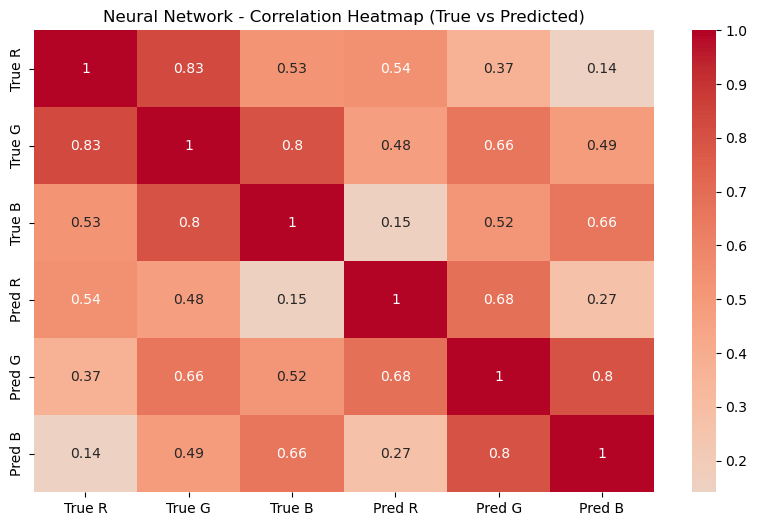

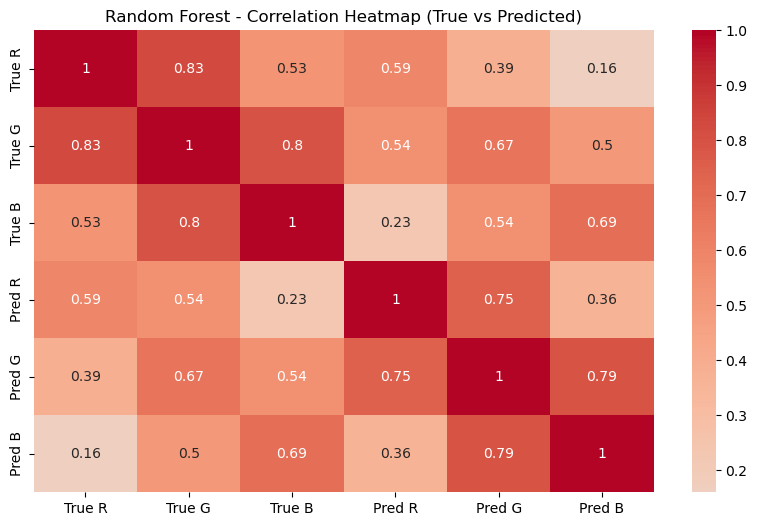

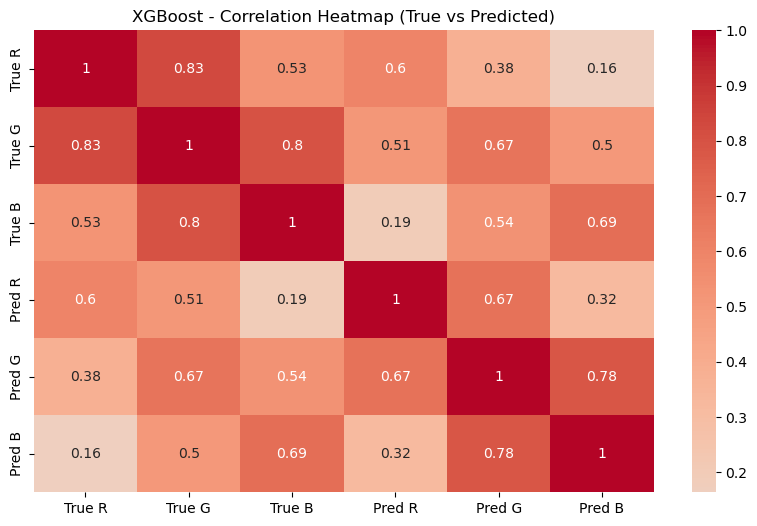

In [135]:
# Heatmap of True vs Predicted Values for Multi-output Regression
def plot_heatmap(true_values, predicted_values, model_name):
    df_true = pd.DataFrame(true_values, columns=['True R', 'True G', 'True B'])
    df_pred = pd.DataFrame(predicted_values, columns=['Pred R', 'Pred G', 'Pred B'])
    comparison_df = pd.concat([df_true, df_pred], axis=1)
    corr = comparison_df.corr()

    plt.figure(figsize=(10, 6))
    sns.heatmap(corr, annot=True, cmap='coolwarm', center=0)
    plt.title(f'{model_name} - Correlation Heatmap (True vs Predicted)')
    plt.show()

# Heatmap for selected models
plot_heatmap(y_test_nn, y_pred_nn, 'Neural Network')
plot_heatmap(y_test_rf, y_pred_rf, 'Random Forest')
plot_heatmap(y_test_xgb, y_pred_xgb, 'XGBoost')


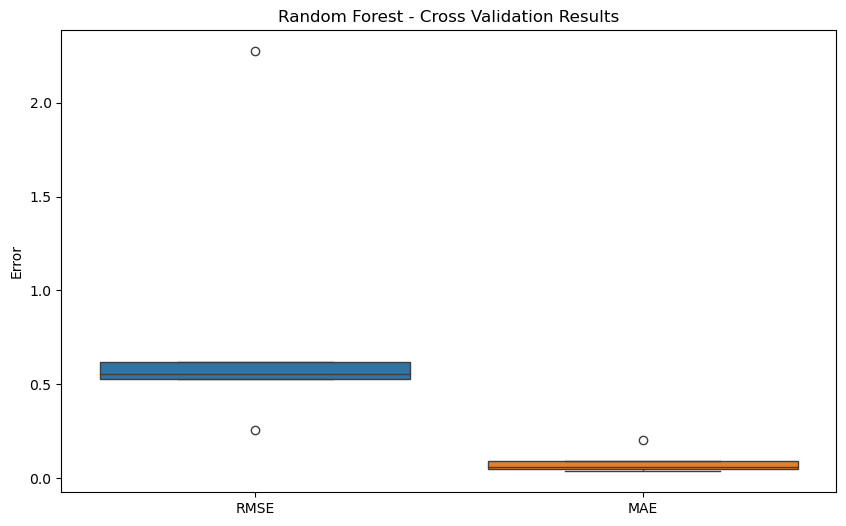

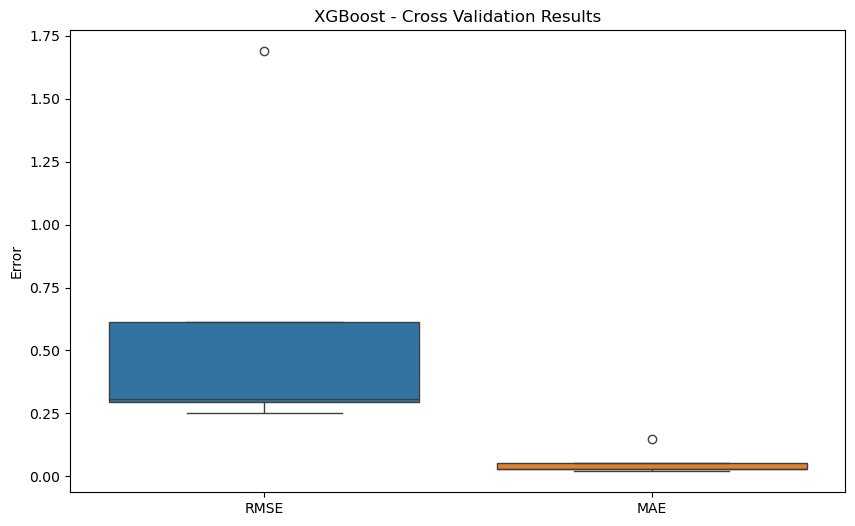

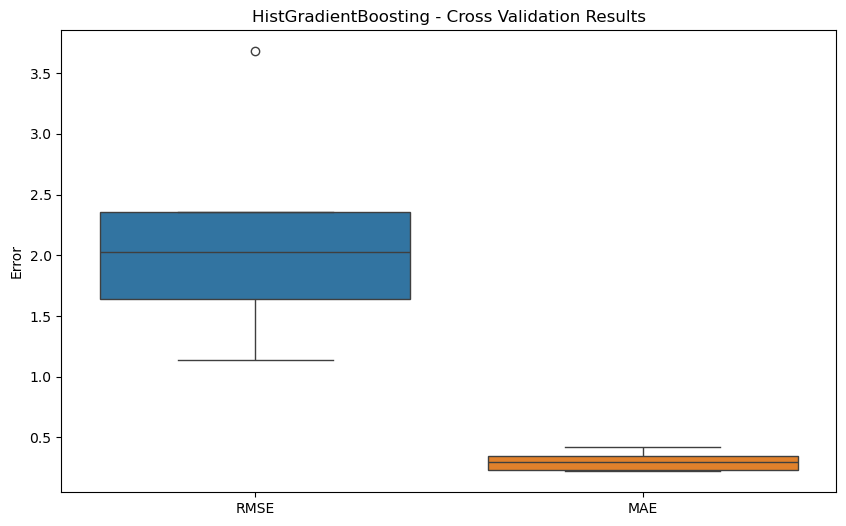

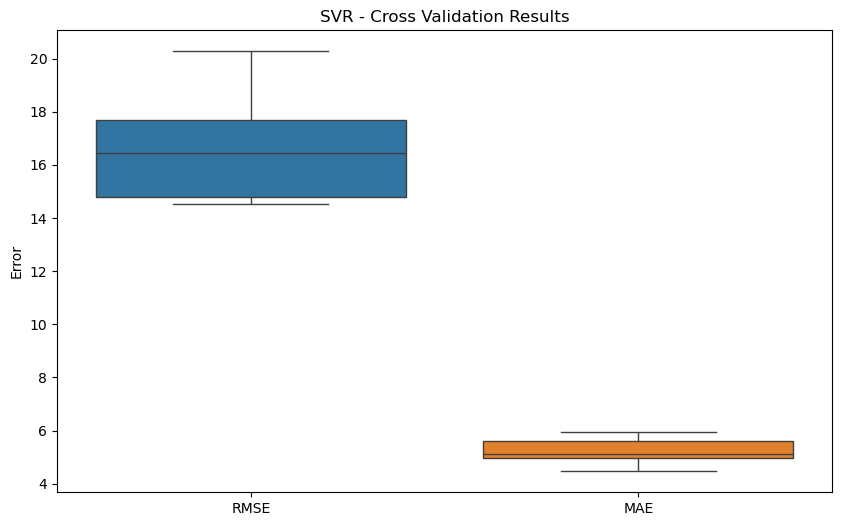

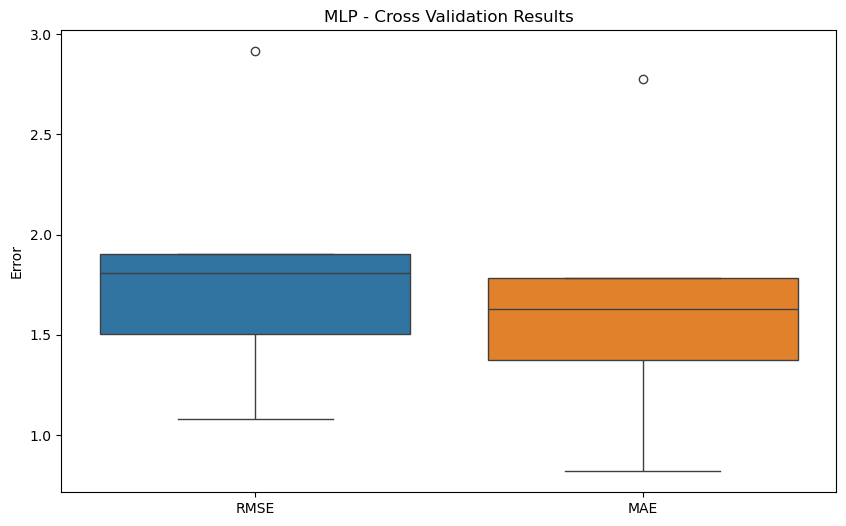

In [156]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error

def cross_val_plot(model, X, y, model_name):
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    rmse_list = []
    mae_list = []
    
    for train_idx, val_idx in kf.split(X):
        X_train_cv, X_val_cv = X[train_idx], X[val_idx]
        y_train_cv, y_val_cv = y[train_idx], y[val_idx]
        
        model.fit(X_train_cv, y_train_cv)
        y_pred_cv = model.predict(X_val_cv)
        
        rmse = np.sqrt(mean_squared_error(y_val_cv, y_pred_cv))
        mae = mean_absolute_error(y_val_cv, y_pred_cv)
        
        rmse_list.append(rmse)
        mae_list.append(mae)
    
    plt.figure(figsize=(10, 6))
    ax = sns.boxplot(data=[rmse_list, mae_list])
    ax.set_xticklabels(['RMSE', 'MAE'])
    plt.title(f'{model_name} - Cross Validation Results')
    plt.ylabel('Error')
    plt.show()

# Cross-validation for selected models
cross_val_plot(rf_model, X, y[:, 0], 'Random Forest')
cross_val_plot(xgb_model, X, y[:, 0], 'XGBoost')
cross_val_plot(hgb_model, X, y[:, 0], 'HistGradientBoosting')
cross_val_plot(svr_model, X, y[:, 0], 'SVR')
cross_val_plot(mlp_model, X, y[:, 0], 'MLP')


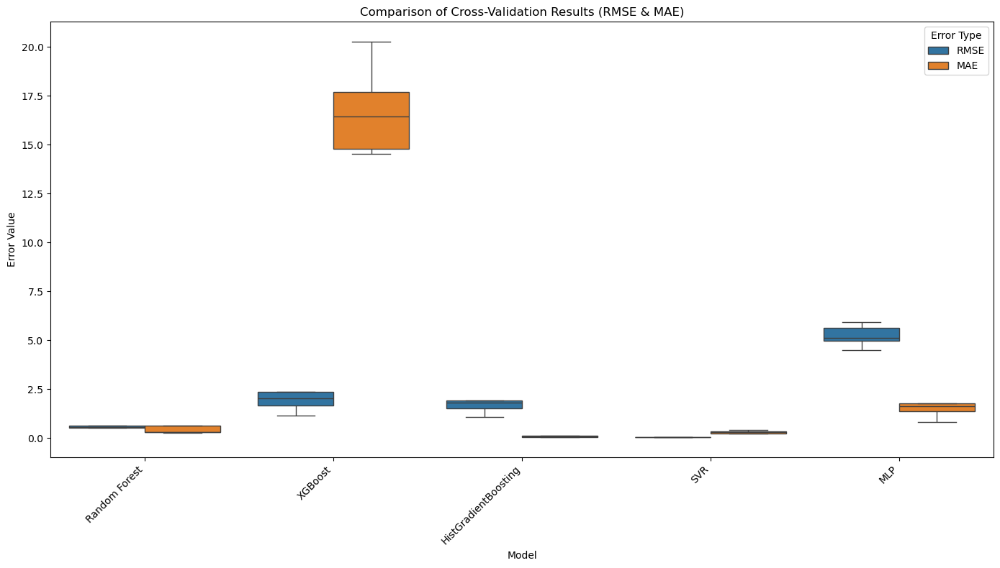

In [158]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error
import pandas as pd

def cross_val_plot(models, model_names, X, y):
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    
    all_rmse = []
    all_mae = []
    all_model_names = []
    all_error_types = []

    # Perform cross-validation for each model
    for model, model_name in zip(models, model_names):
        rmse_list = []
        mae_list = []
        
        for train_idx, val_idx in kf.split(X):
            X_train_cv, X_val_cv = X[train_idx], X[val_idx]
            y_train_cv, y_val_cv = y[train_idx], y[val_idx]
            
            model.fit(X_train_cv, y_train_cv)
            y_pred_cv = model.predict(X_val_cv)
            
            rmse = np.sqrt(mean_squared_error(y_val_cv, y_pred_cv))
            mae = mean_absolute_error(y_val_cv, y_pred_cv)
            
            rmse_list.append(rmse)
            mae_list.append(mae)
        
        # Append results to the overall lists
        all_rmse.extend(rmse_list)
        all_mae.extend(mae_list)
        all_model_names.extend([model_name] * (len(rmse_list) + len(mae_list)))
        all_error_types.extend(['RMSE'] * len(rmse_list) + ['MAE'] * len(mae_list))

    # Create a dataframe for easy visualization
    df = pd.DataFrame({
        'Model': all_model_names,
        'Error Type': all_error_types,
        'Error Value': all_rmse + all_mae
    })

    # Plotting
    plt.figure(figsize=(14, 8))
    sns.boxplot(x='Model', y='Error Value', hue='Error Type', data=df, showfliers=False)
    plt.title('Comparison of Cross-Validation Results (RMSE & MAE)')
    plt.ylabel('Error Value')
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Error Type')
    plt.tight_layout()
    plt.show()

# List of models and their names
models = [rf_model, xgb_model, hgb_model, svr_model, mlp_model]
model_names = ['Random Forest', 'XGBoost', 'HistGradientBoosting', 'SVR', 'MLP']

# Cross-validation comparison
cross_val_plot(models, model_names, X, y[:, 0])


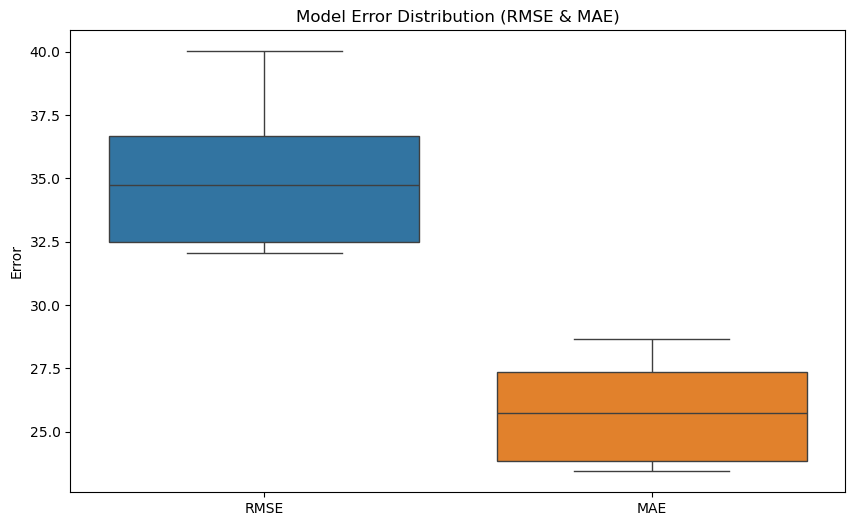

In [137]:
# Model Error Distribution Boxplot
def plot_model_error_distribution(results_df):
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=results_df[['RMSE', 'MAE']])
    plt.title('Model Error Distribution (RMSE & MAE)')
    plt.ylabel('Error')
    plt.show()

# Prepare the error data for boxplot
error_data = pd.DataFrame({
    'Model': ['Neural Network', 'Random Forest', 'XGBoost', 'HistGB', 'SVR', 'MLP'],
    'RMSE': [nn_rmse, rf_rmse, xgb_rmse, hgb_rmse, svr_rmse, mlp_rmse],
    'MAE': [nn_mae, rf_mae, xgb_mae, hgb_mae, svr_mae, mlp_mae]
})
plot_model_error_distribution(error_data)


# -------------------------------------------------------------------

Processing test images...
Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_2.jpg: 640x480 1 color_card, 47.6ms
Speed: 2.0ms preprocess, 47.6ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-10A_2.jpg


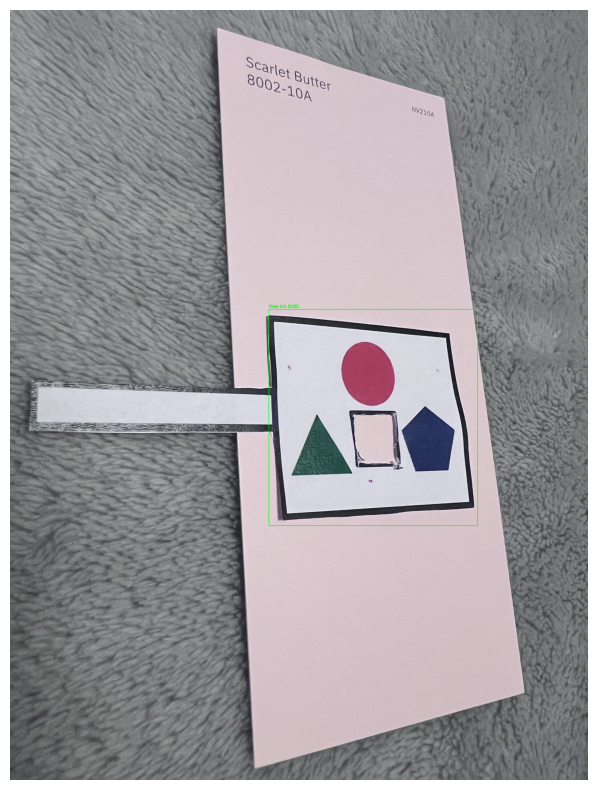

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_3.jpg: 640x480 1 color_card, 37.6ms
Speed: 1.7ms preprocess, 37.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-10A_3.jpg


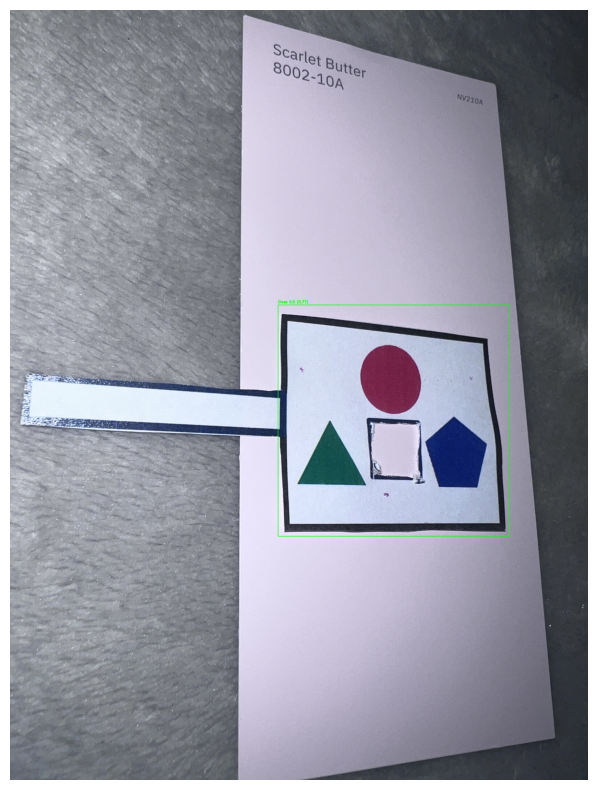

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_1.jpg: 640x480 1 color_card, 36.4ms
Speed: 1.6ms preprocess, 36.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-10A_1.jpg


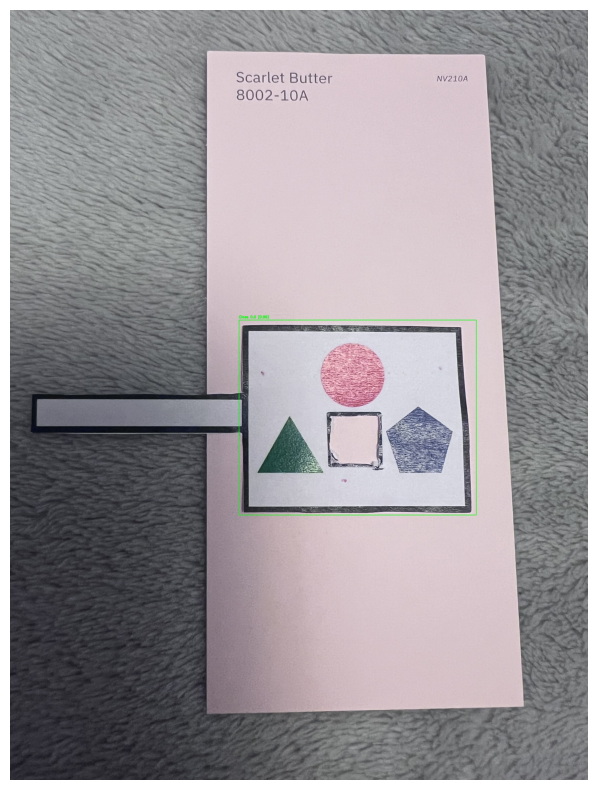

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_4.jpg: 640x480 1 color_card, 37.4ms
Speed: 2.1ms preprocess, 37.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-10A_4.jpg


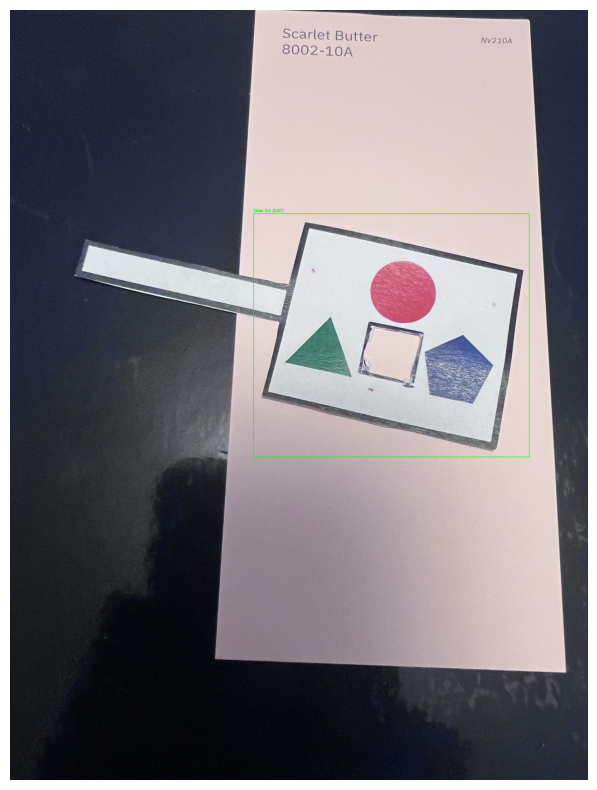

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_5.jpg: 640x480 1 color_card, 39.4ms
Speed: 1.6ms preprocess, 39.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-10A_5.jpg


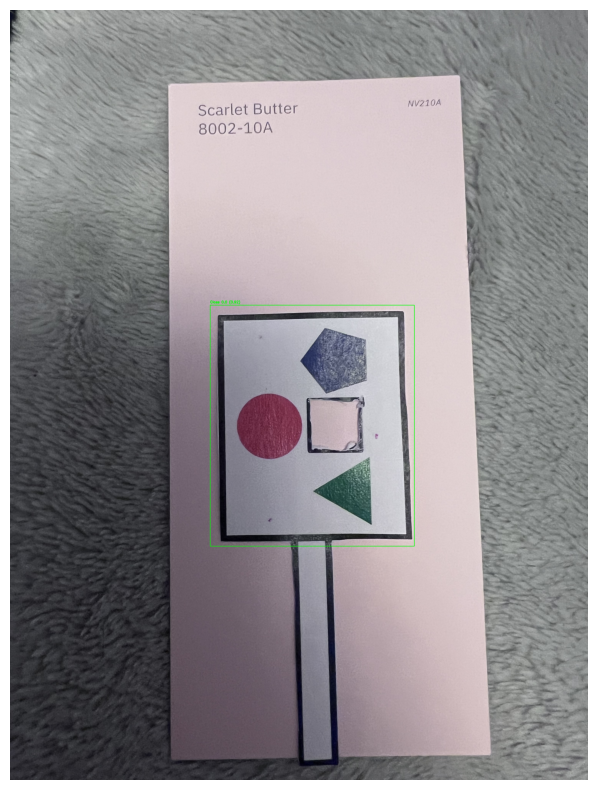

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_4.jpg: 640x480 1 color_card, 53.3ms
Speed: 2.1ms preprocess, 53.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_2001-6C_4.jpg


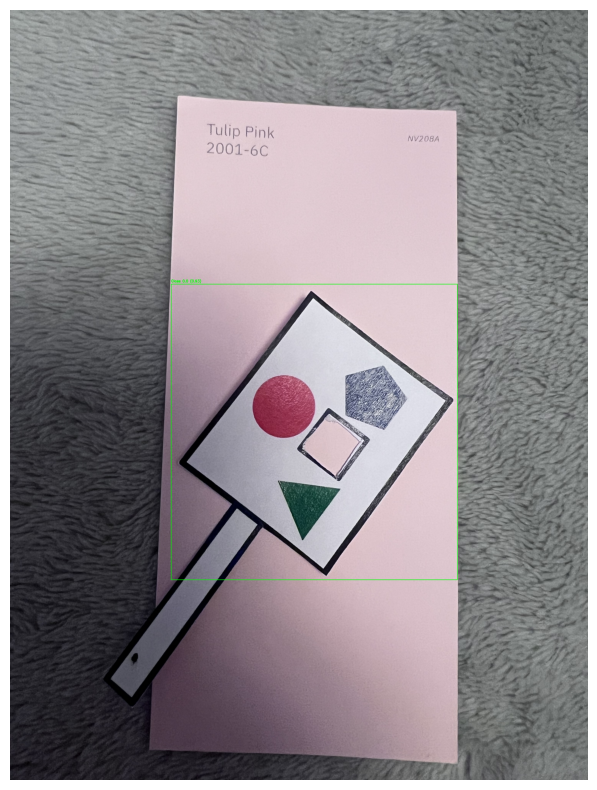

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_5.jpg: 640x480 1 color_card, 42.6ms
Speed: 1.6ms preprocess, 42.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_2001-6C_5.jpg


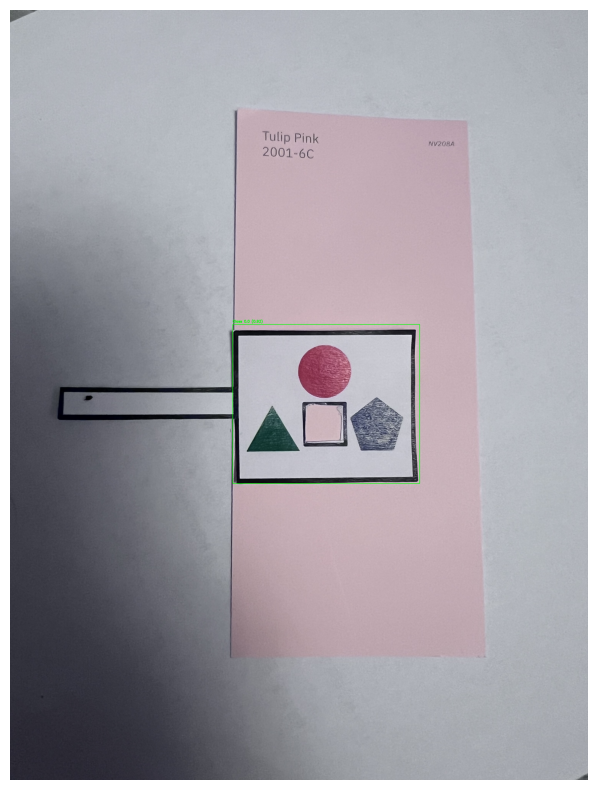

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_2.jpg: 640x480 2 color_cards, 35.0ms
Speed: 1.6ms preprocess, 35.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_2001-6C_2.jpg
Cropped image saved at cropped_2001-6C_2.jpg


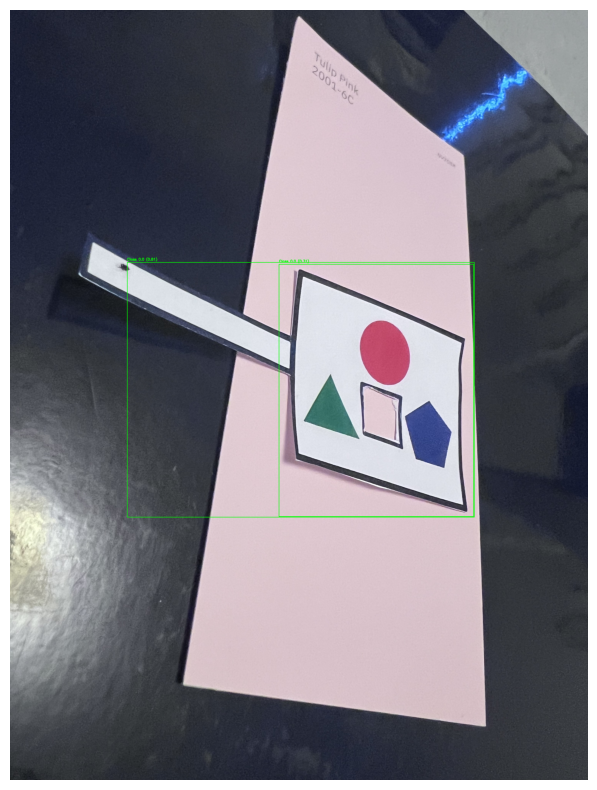

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_3.jpg: 640x480 1 color_card, 40.1ms
Speed: 2.0ms preprocess, 40.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_2001-6C_3.jpg


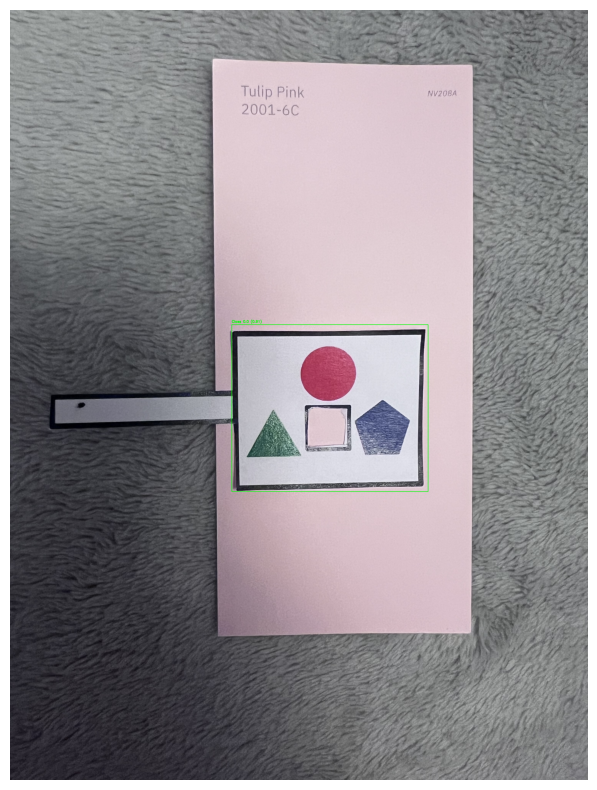

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_1.jpg: 640x480 1 color_card, 37.7ms
Speed: 1.6ms preprocess, 37.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_2001-6C_1.jpg


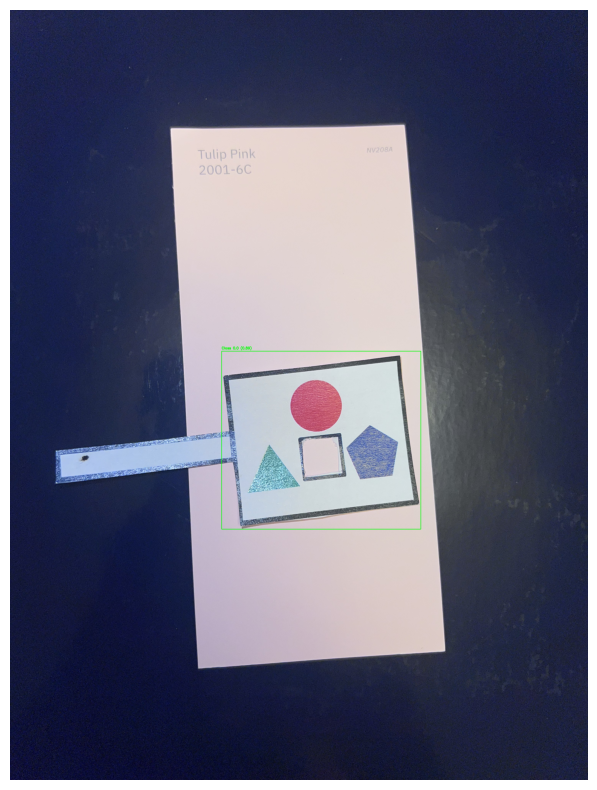

Processing train images...
Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_5.jpg: 640x480 2 color_cards, 41.6ms
Speed: 4.9ms preprocess, 41.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4B_5.jpg
Cropped image saved at cropped_1004-4B_5.jpg


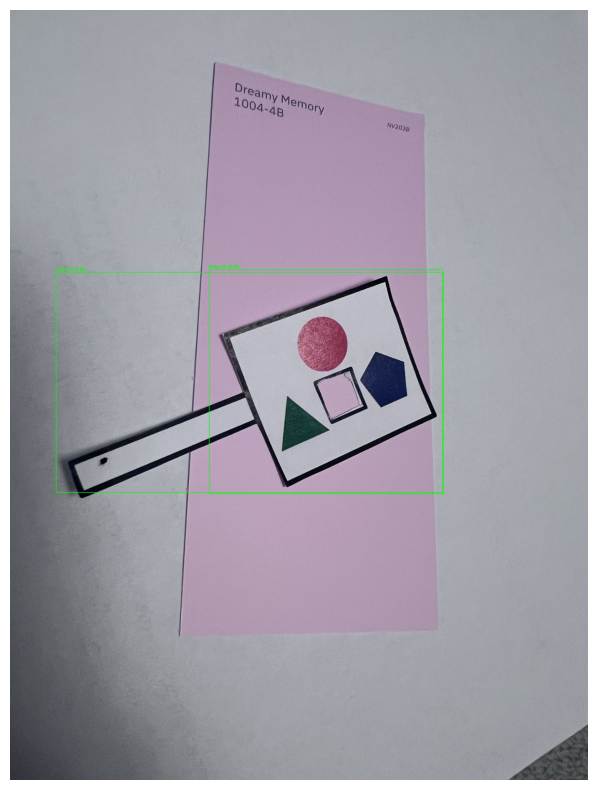

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_2.jpg: 640x480 1 color_card, 38.6ms
Speed: 1.6ms preprocess, 38.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-2B_2.jpg


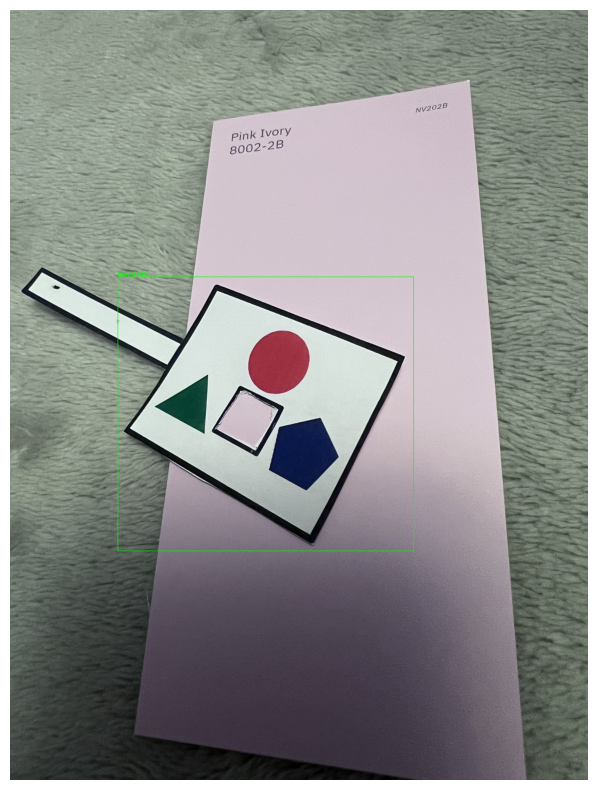

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_3.jpg: 640x480 1 color_card, 42.4ms
Speed: 2.0ms preprocess, 42.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-2B_3.jpg


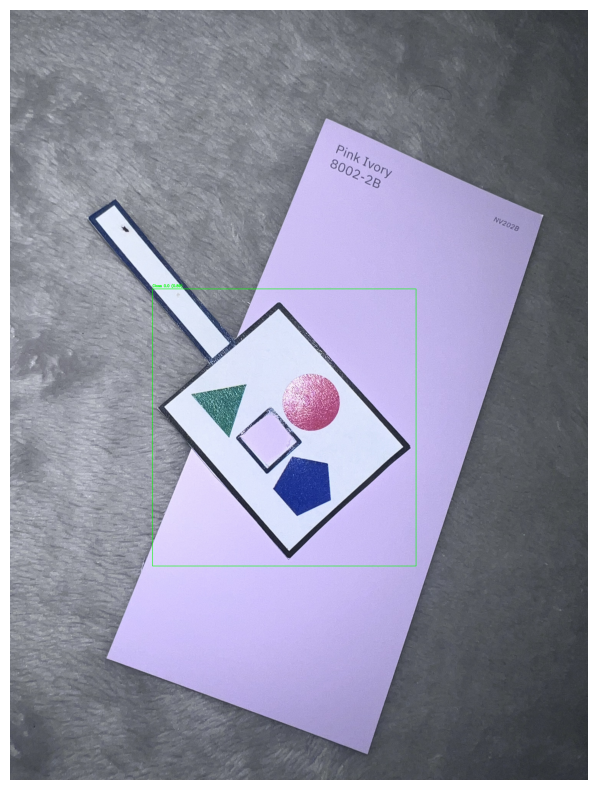

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_4.jpg: 640x480 2 color_cards, 43.8ms
Speed: 2.2ms preprocess, 43.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4B_4.jpg
Cropped image saved at cropped_1004-4B_4.jpg


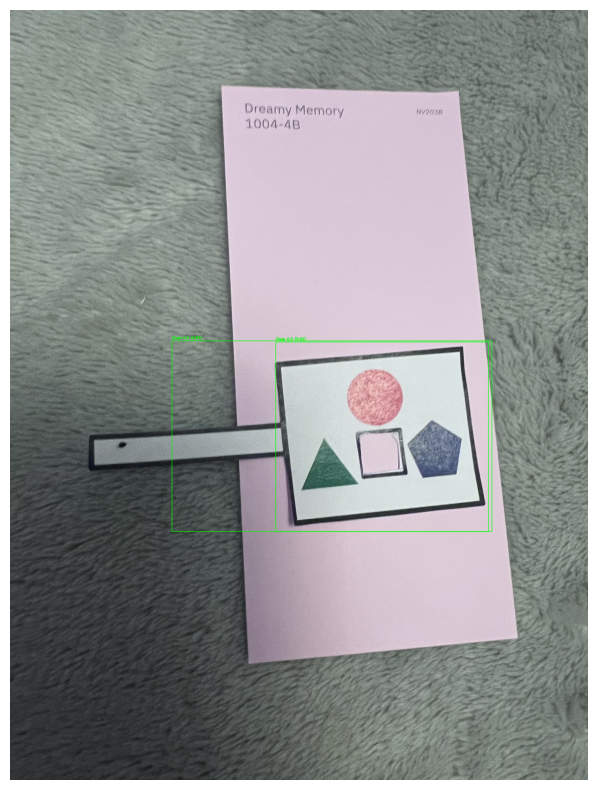

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_5.jpg: 640x480 2 color_cards, 39.5ms
Speed: 1.8ms preprocess, 39.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-6C_5.jpg
Cropped image saved at cropped_1008-6C_5.jpg


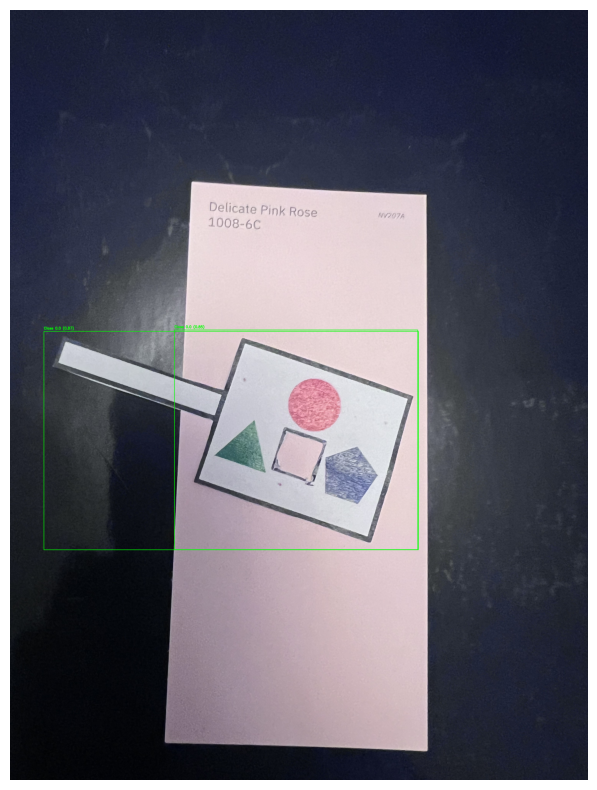

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_1.jpg: 640x480 1 color_card, 42.3ms
Speed: 1.7ms preprocess, 42.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-2B_1.jpg


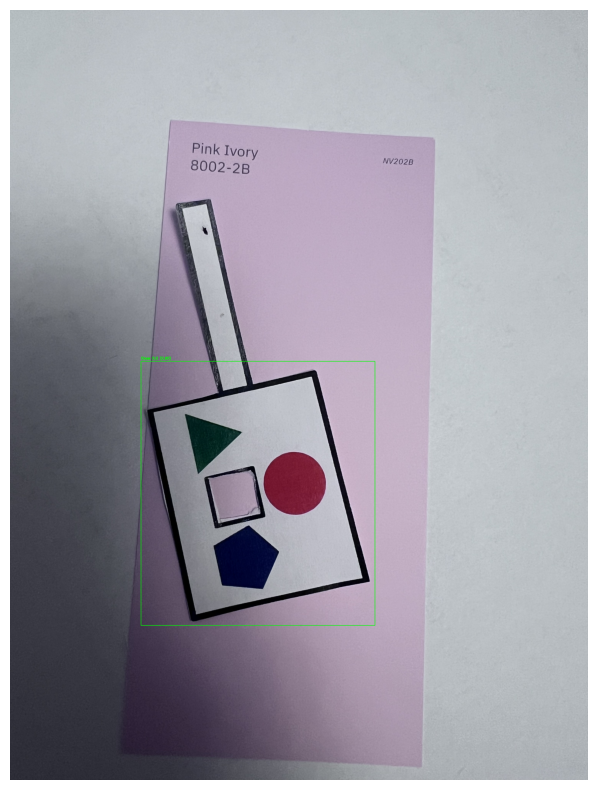

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_4.jpg: 640x480 1 color_card, 36.9ms
Speed: 2.5ms preprocess, 36.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-6C_4.jpg


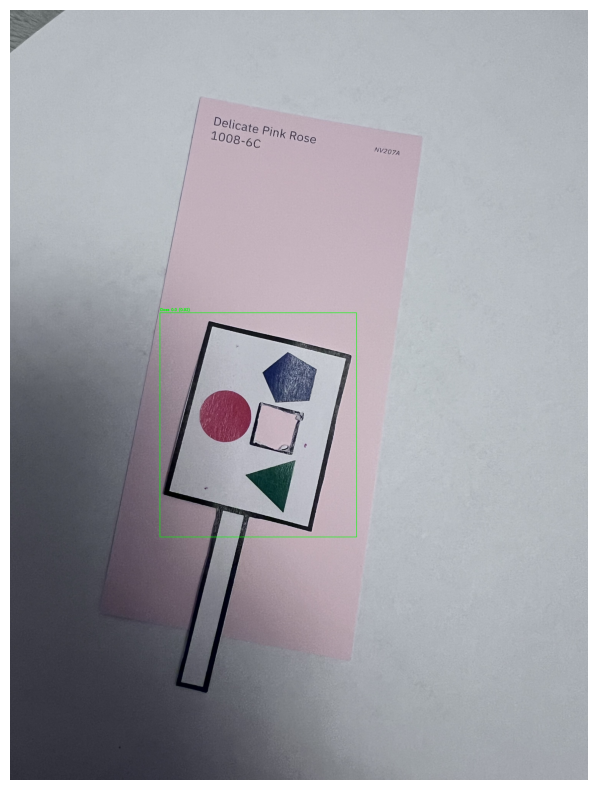

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_3.jpg: 640x480 1 color_card, 41.2ms
Speed: 2.2ms preprocess, 41.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4B_3.jpg


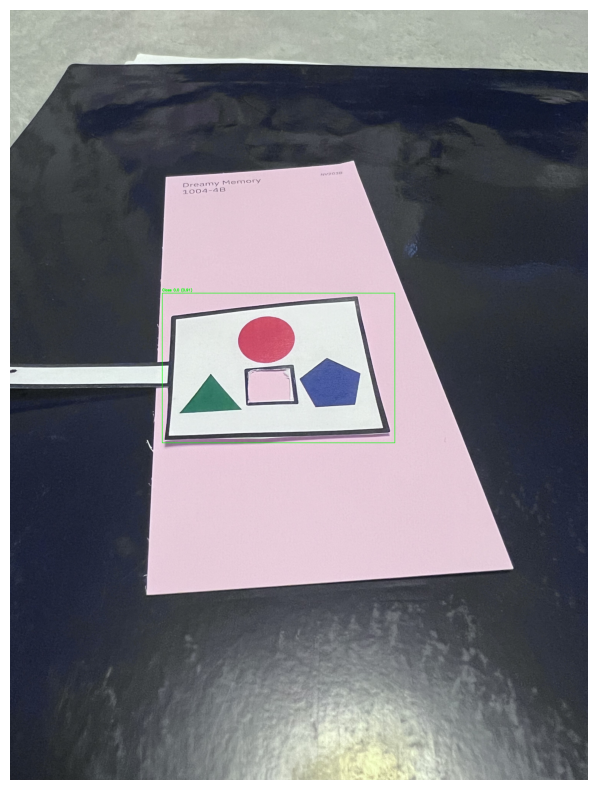

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_4.jpg: 640x480 2 color_cards, 35.6ms
Speed: 1.7ms preprocess, 35.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-2B_4.jpg
Cropped image saved at cropped_8002-2B_4.jpg


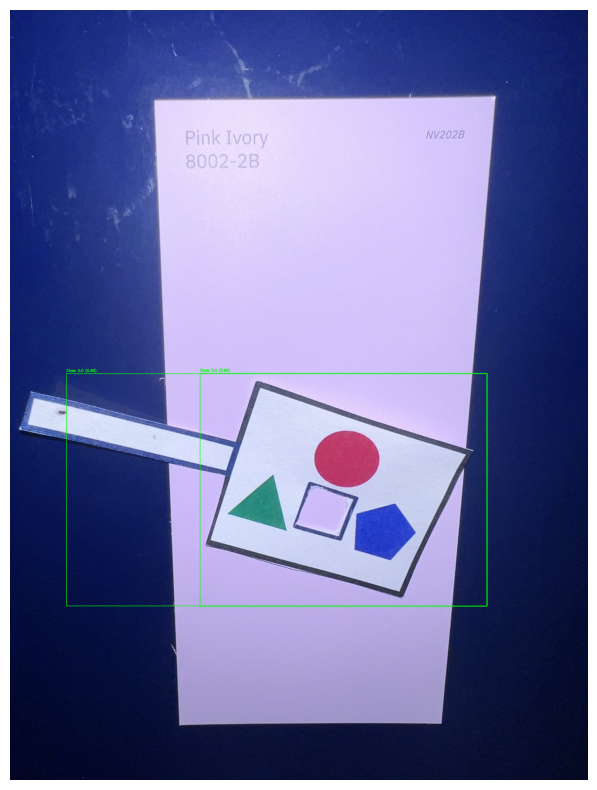

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_1.jpg: 640x480 1 color_card, 37.1ms
Speed: 1.8ms preprocess, 37.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-6C_1.jpg


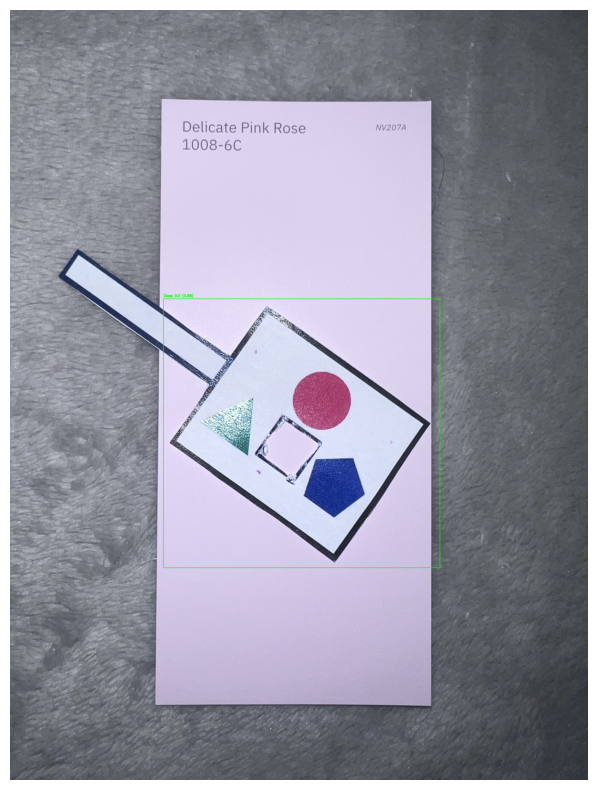

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-2B_5.jpg: 640x480 1 color_card, 41.2ms
Speed: 1.7ms preprocess, 41.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-2B_5.jpg


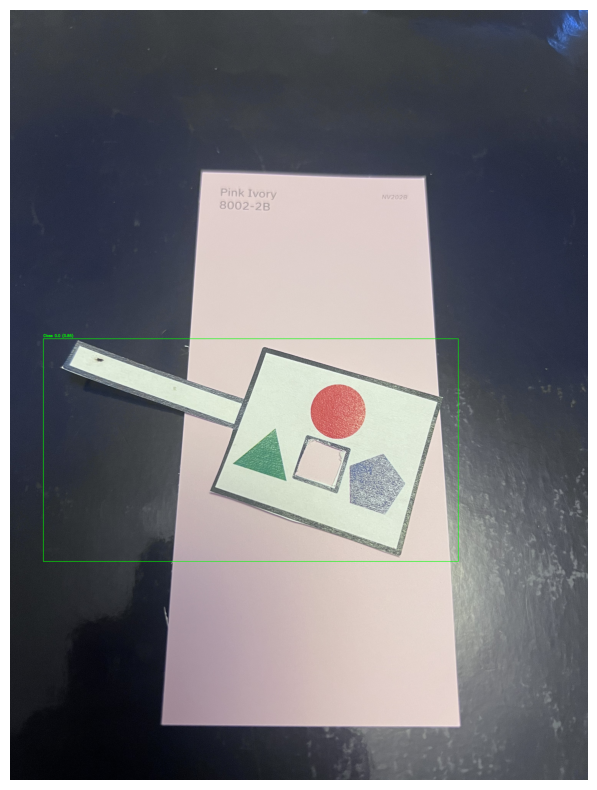

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_2.jpg: 640x480 1 color_card, 40.2ms
Speed: 1.6ms preprocess, 40.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4B_2.jpg


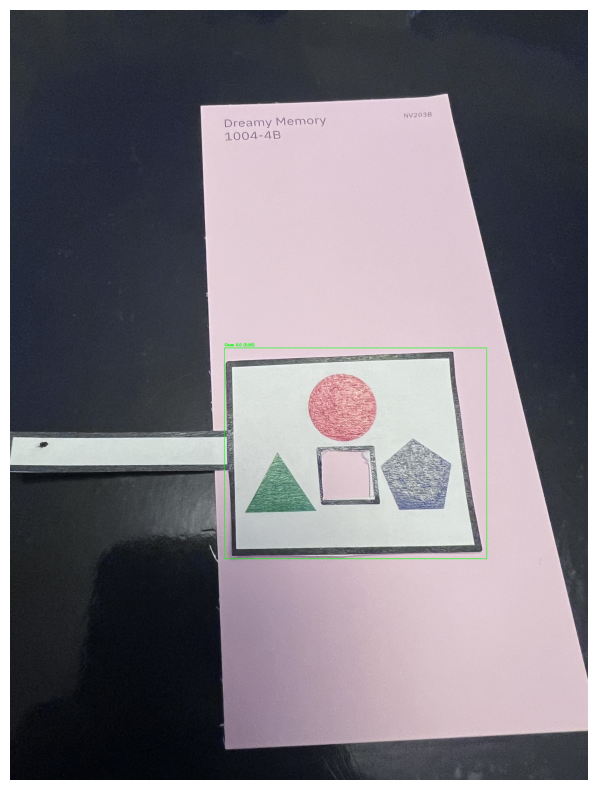

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_3.jpg: 640x480 2 color_cards, 42.6ms
Speed: 1.6ms preprocess, 42.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-6C_3.jpg
Cropped image saved at cropped_1008-6C_3.jpg


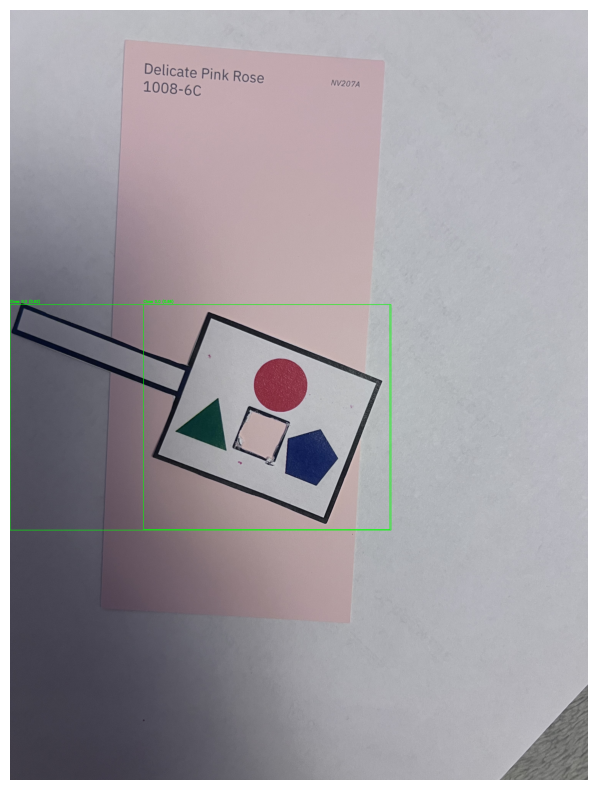

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-6C_2.jpg: 640x480 1 color_card, 35.8ms
Speed: 1.5ms preprocess, 35.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-6C_2.jpg


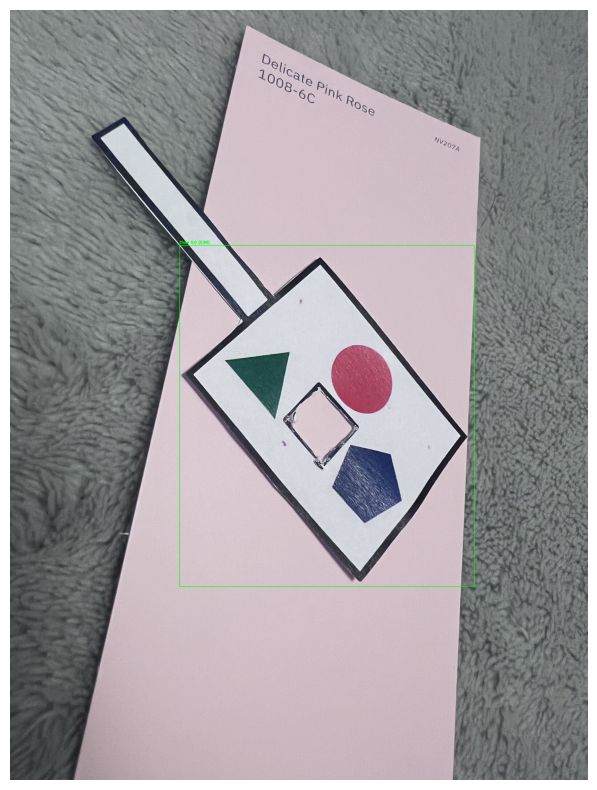

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4B_1.jpg: 640x480 1 color_card, 45.0ms
Speed: 14.2ms preprocess, 45.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4B_1.jpg


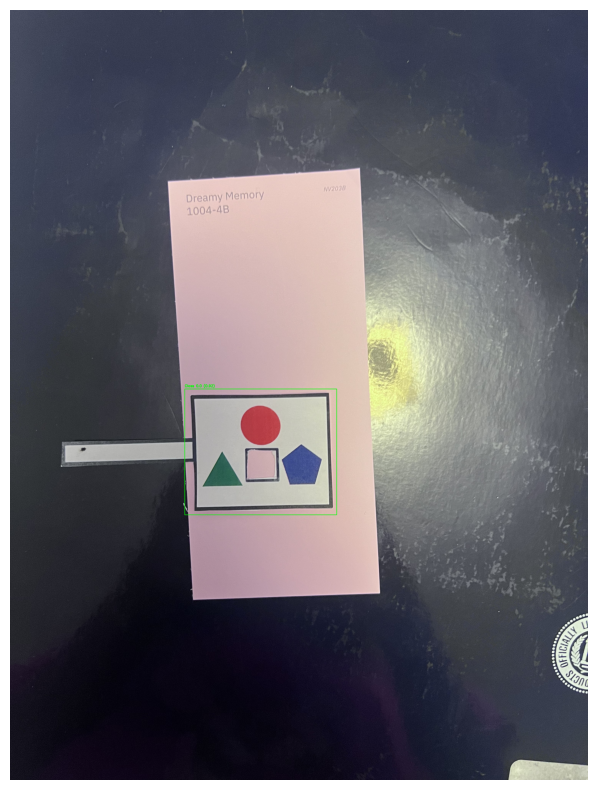

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_3.jpg: 640x480 2 color_cards, 40.0ms
Speed: 7.2ms preprocess, 40.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1002-4B_3.jpg
Cropped image saved at cropped_1002-4B_3.jpg


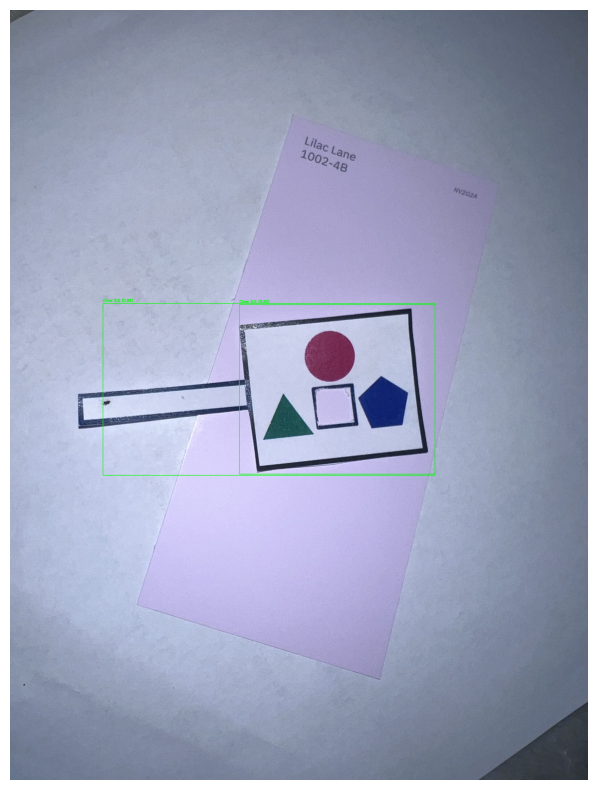

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_1.jpg: 640x480 1 color_card, 37.1ms
Speed: 1.7ms preprocess, 37.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-4B_1.jpg


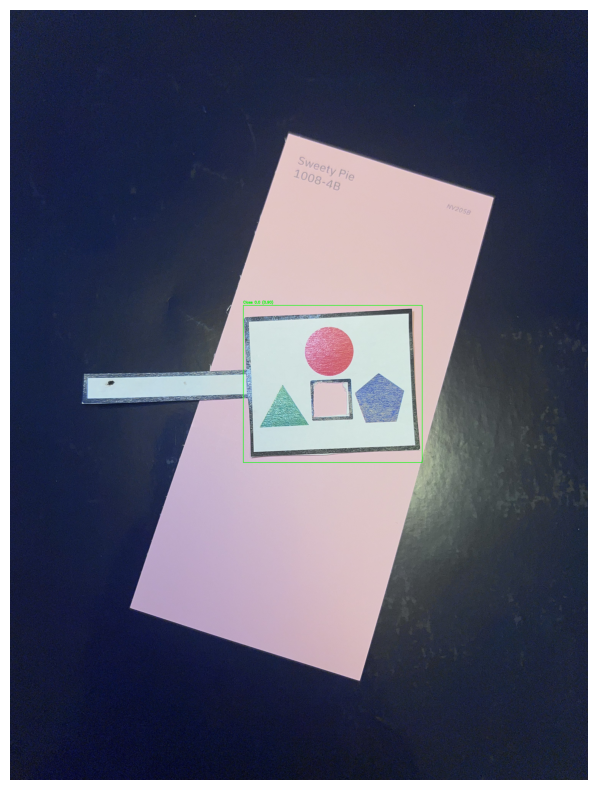

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_2.jpg: 640x480 1 color_card, 34.4ms
Speed: 1.6ms preprocess, 34.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1002-4B_2.jpg


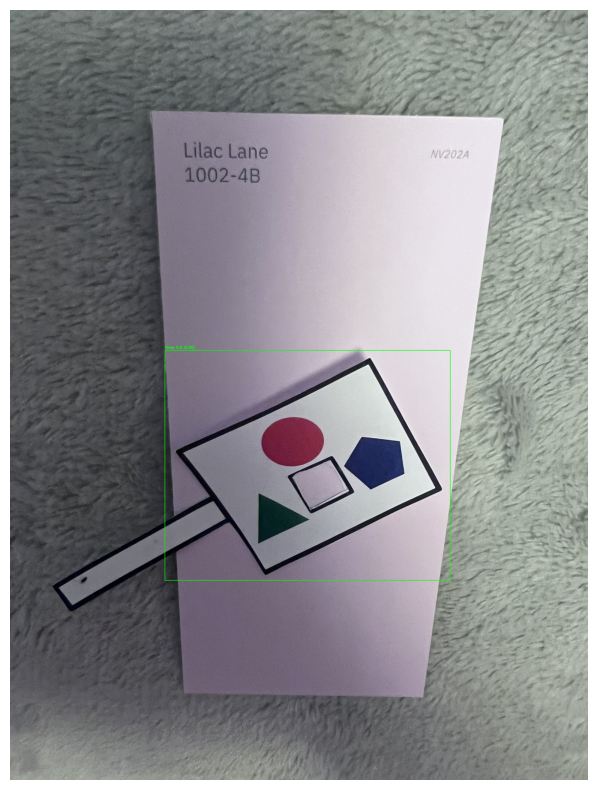

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_3.jpg: 640x480 1 color_card, 37.5ms
Speed: 3.1ms preprocess, 37.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-4B_3.jpg


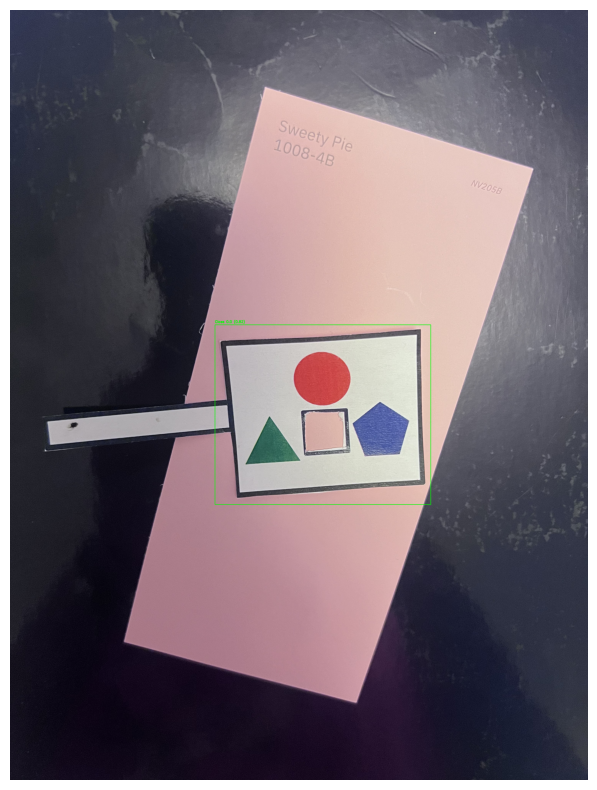

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_5.jpg: 640x480 1 color_card, 34.6ms
Speed: 6.6ms preprocess, 34.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4C_5.jpg


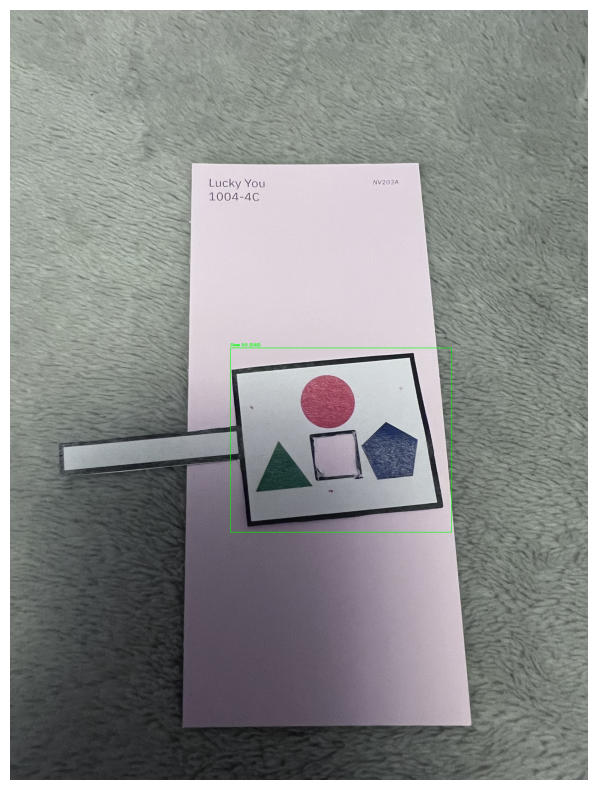

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_4.jpg: 640x480 1 color_card, 41.4ms
Speed: 1.6ms preprocess, 41.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4C_4.jpg


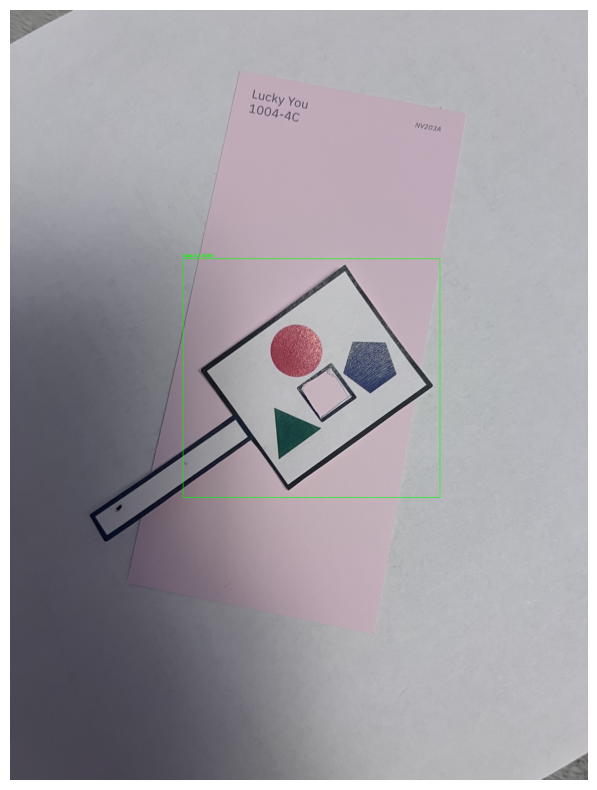

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_2.jpg: 640x480 1 color_card, 43.0ms
Speed: 12.2ms preprocess, 43.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-4B_2.jpg


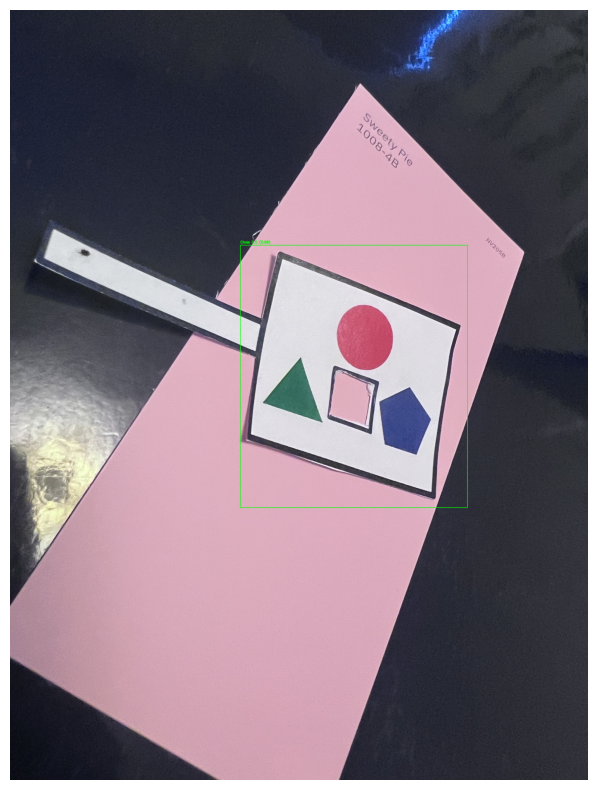

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_1.jpg: 640x480 1 color_card, 40.2ms
Speed: 3.8ms preprocess, 40.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1002-4B_1.jpg


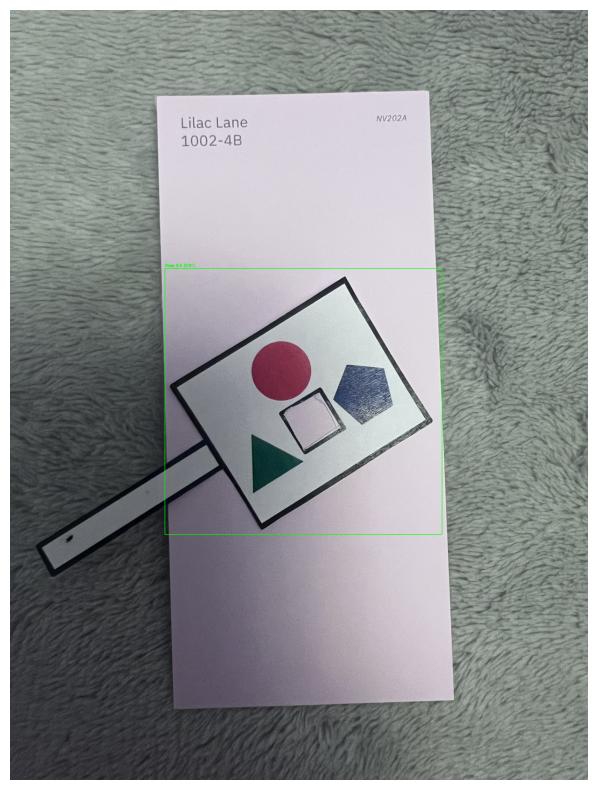

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_5.jpg: 640x480 1 color_card, 34.7ms
Speed: 5.6ms preprocess, 34.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1002-4B_5.jpg


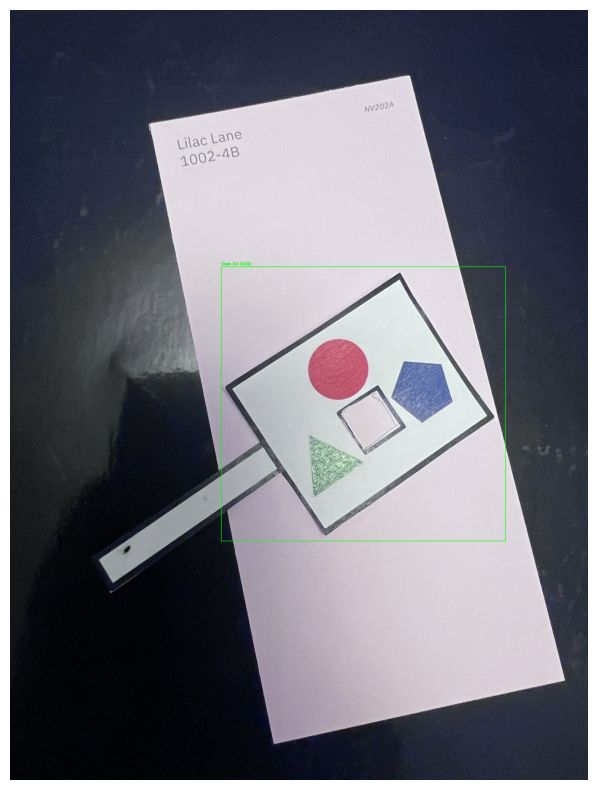

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_1.jpg: 640x480 1 color_card, 36.0ms
Speed: 1.8ms preprocess, 36.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4C_1.jpg


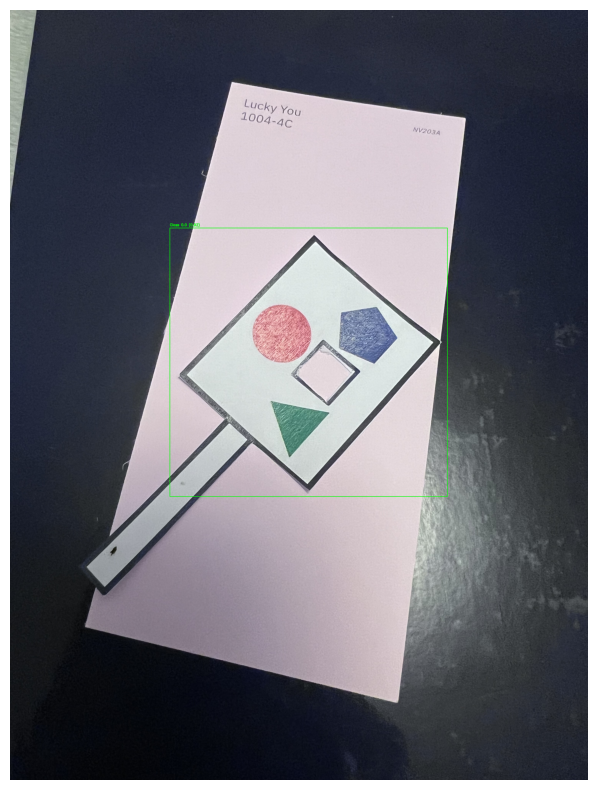

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1002-4B_4.jpg: 640x480 2 color_cards, 41.1ms
Speed: 1.8ms preprocess, 41.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1002-4B_4.jpg
Cropped image saved at cropped_1002-4B_4.jpg


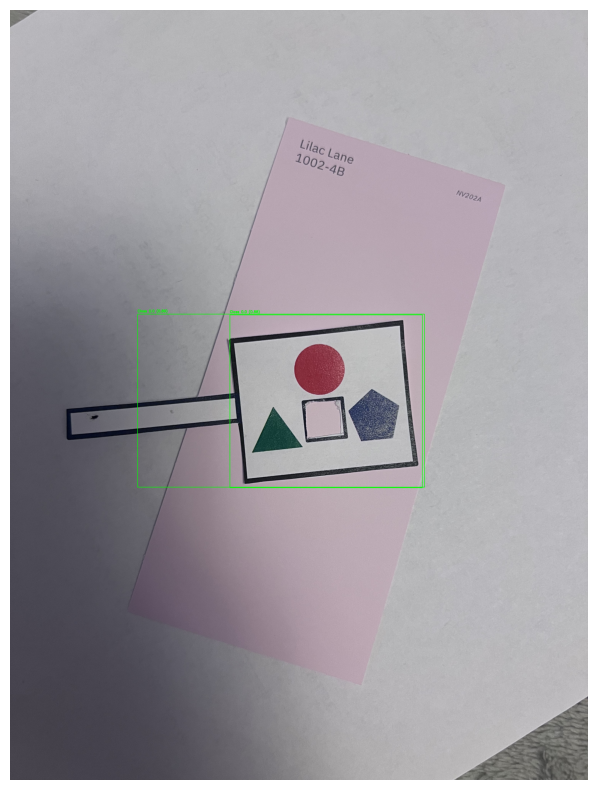

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_5.jpg: 640x480 1 color_card, 47.2ms
Speed: 2.1ms preprocess, 47.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-4B_5.jpg


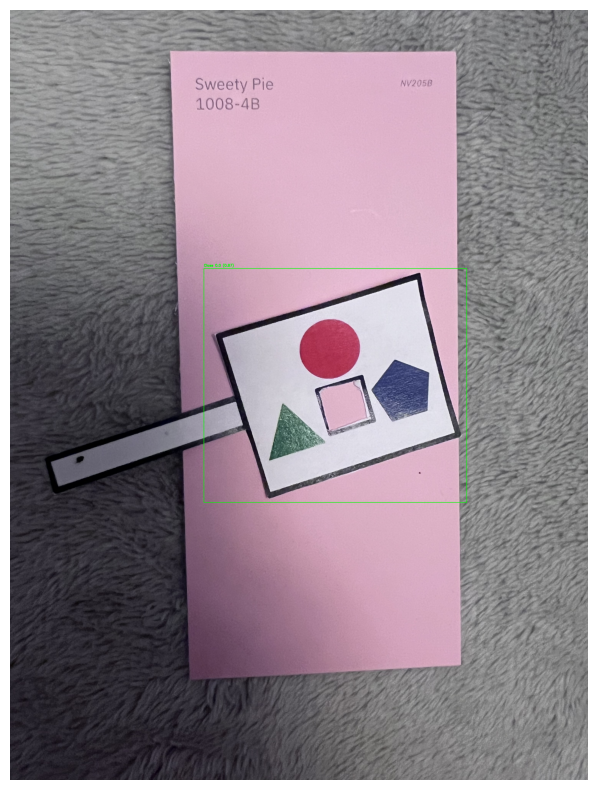

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_3.jpg: 640x480 1 color_card, 51.9ms
Speed: 1.7ms preprocess, 51.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4C_3.jpg


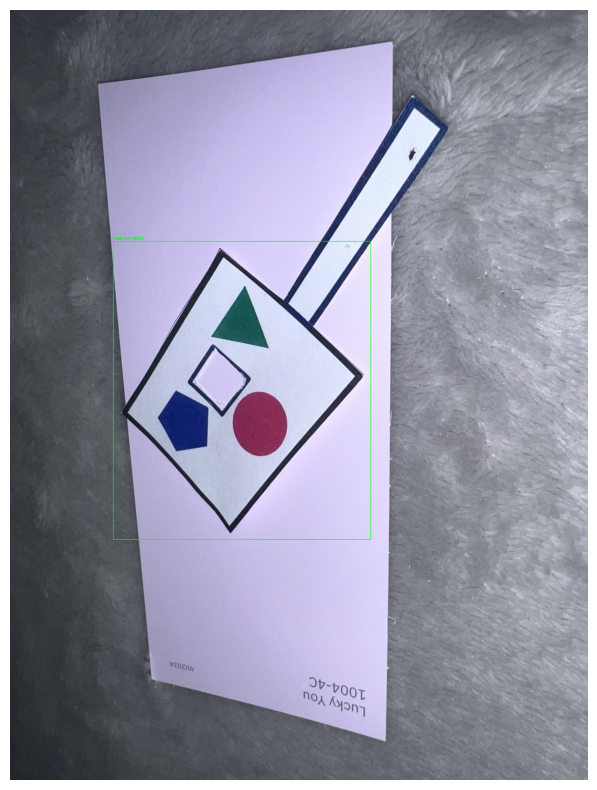

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1004-4C_2.jpg: 640x480 1 color_card, 55.1ms
Speed: 1.9ms preprocess, 55.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1004-4C_2.jpg


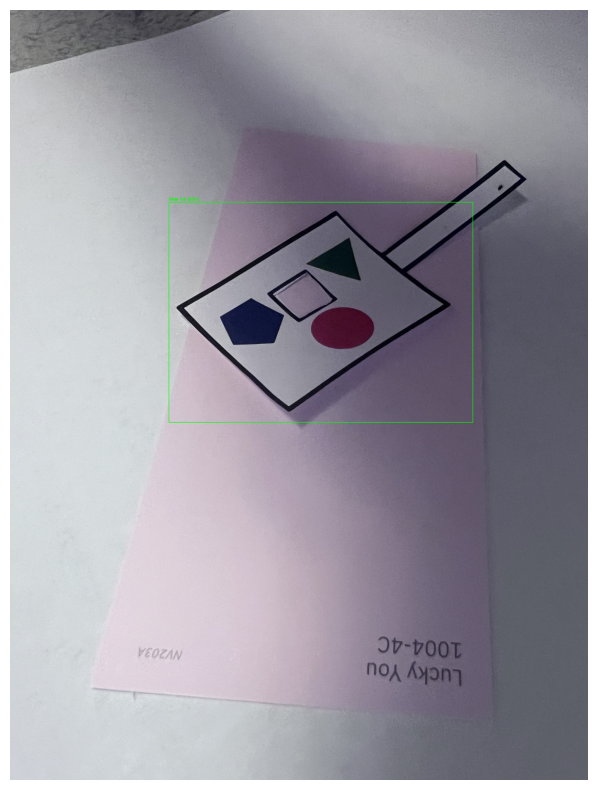

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1008-4B_4.jpg: 640x480 2 color_cards, 54.8ms
Speed: 2.2ms preprocess, 54.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1008-4B_4.jpg
Cropped image saved at cropped_1008-4B_4.jpg


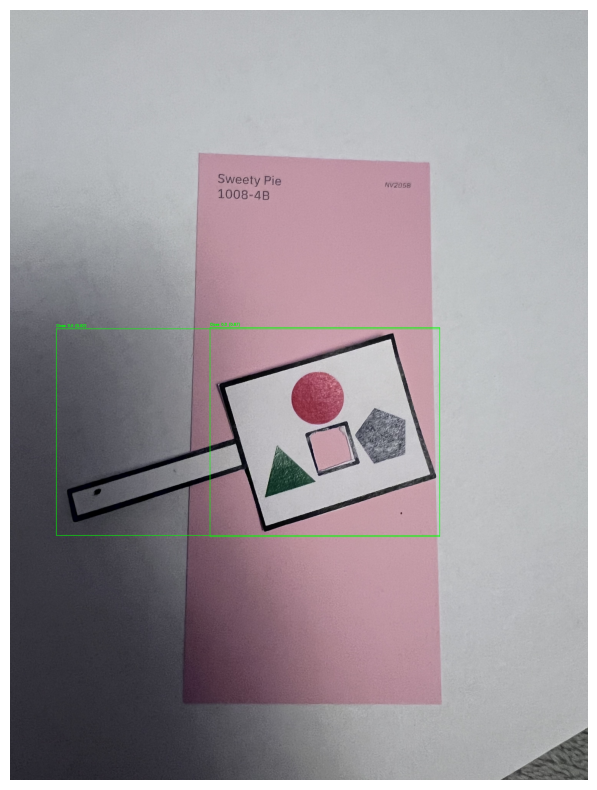

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_5.jpg: 640x480 1 color_card, 52.3ms
Speed: 2.3ms preprocess, 52.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6B_5.jpg


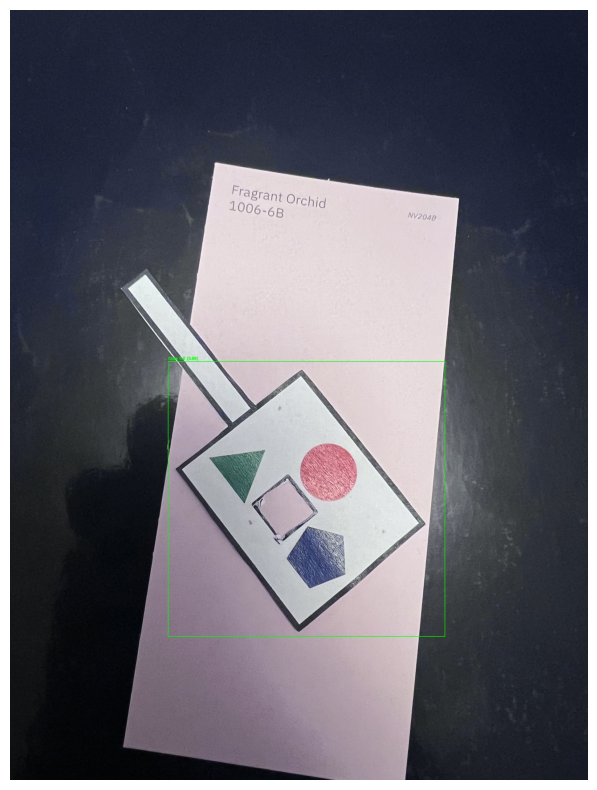

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_4.jpg: 640x480 1 color_card, 37.2ms
Speed: 1.6ms preprocess, 37.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6B_4.jpg


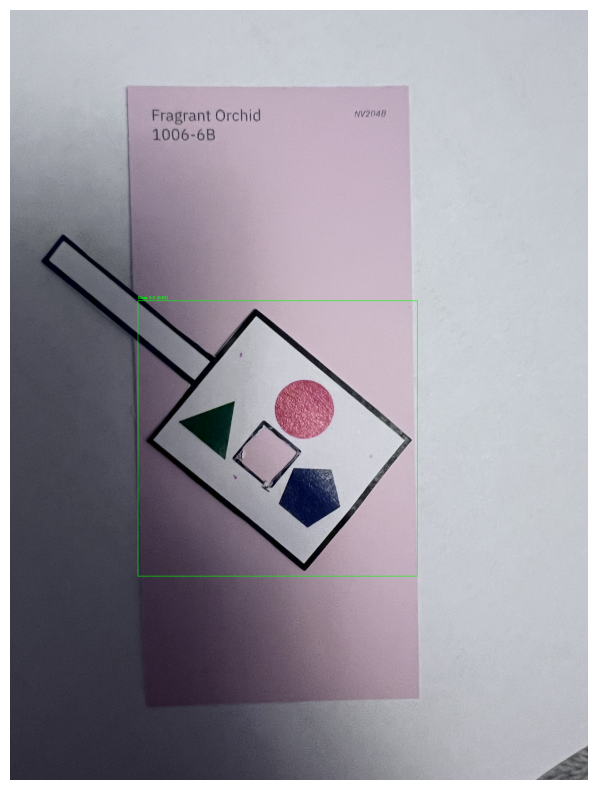

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_3.jpg: 640x480 1 color_card, 43.7ms
Speed: 2.3ms preprocess, 43.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6B_3.jpg


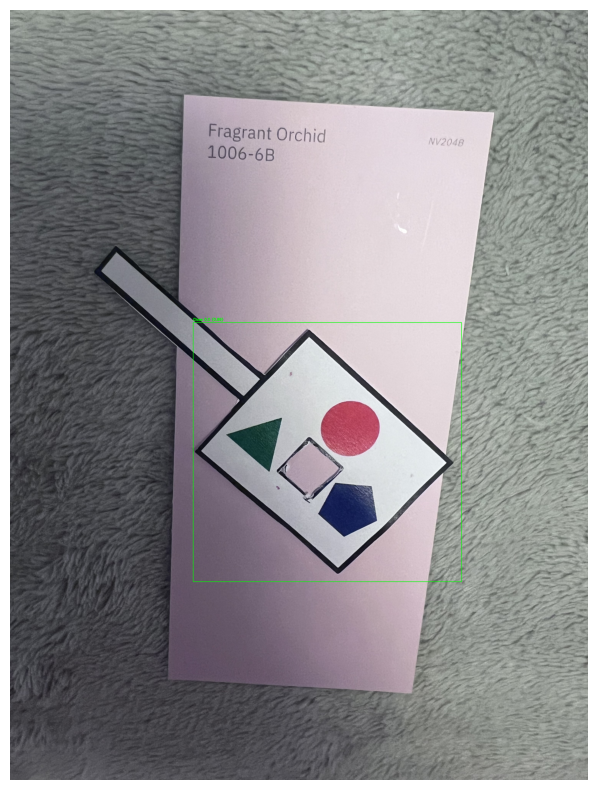

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_2.jpg: 640x480 1 color_card, 41.4ms
Speed: 1.6ms preprocess, 41.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6B_2.jpg


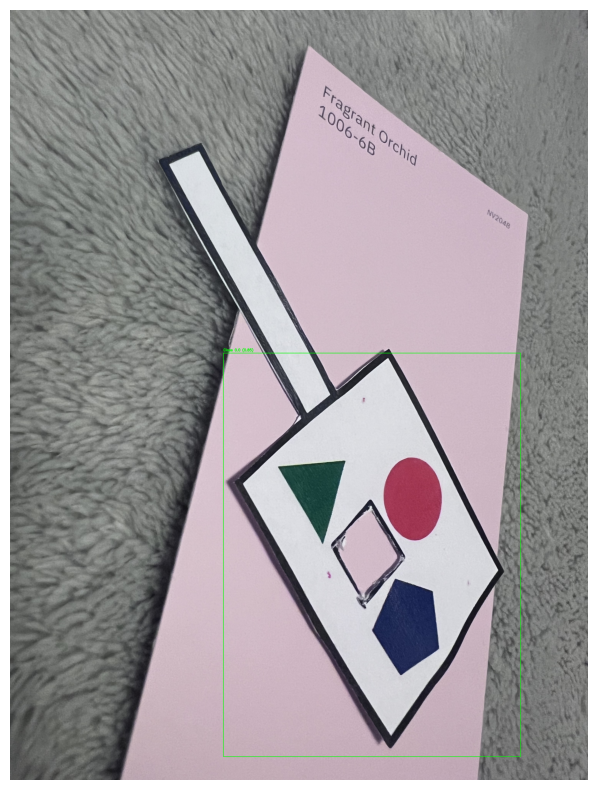

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6B_1.jpg: 640x480 1 color_card, 41.9ms
Speed: 1.6ms preprocess, 41.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6B_1.jpg


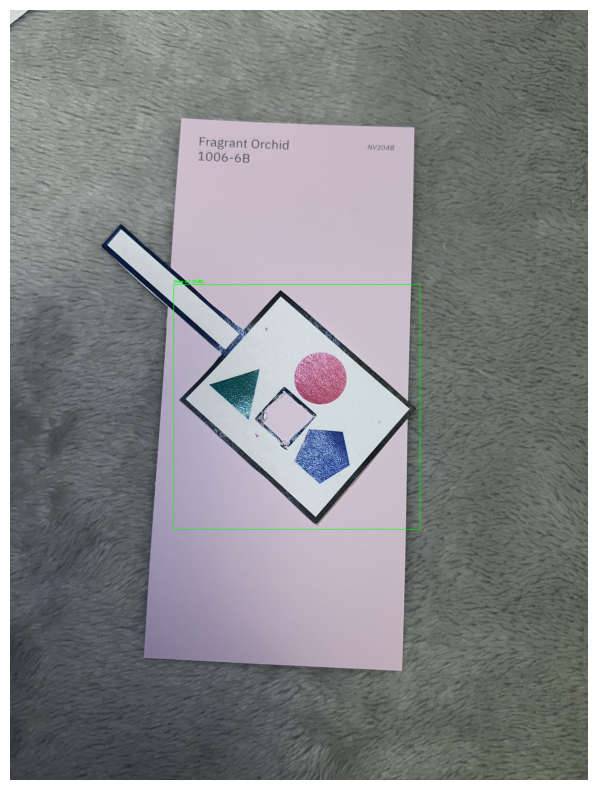

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_4.jpg: 640x480 1 color_card, 66.8ms
Speed: 10.9ms preprocess, 66.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-1A_4.jpg


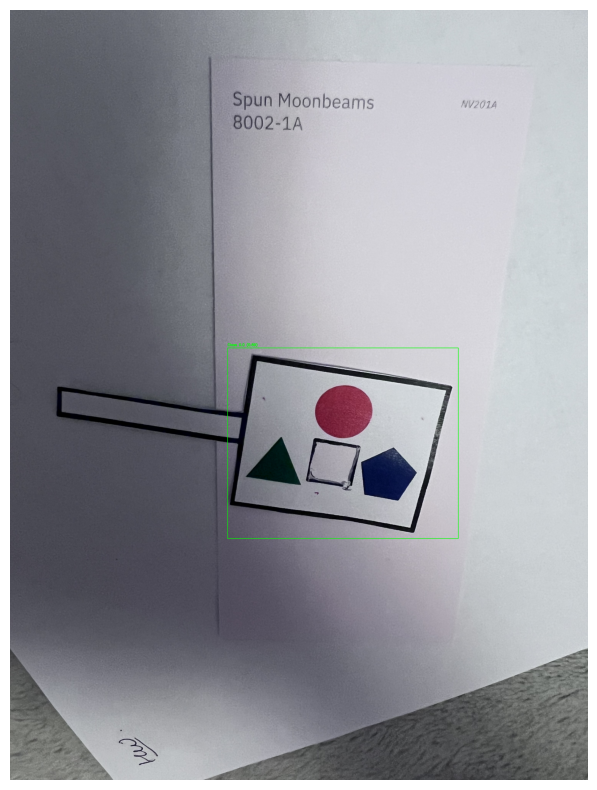

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_5.jpg: 640x480 1 color_card, 39.2ms
Speed: 1.7ms preprocess, 39.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-1A_5.jpg


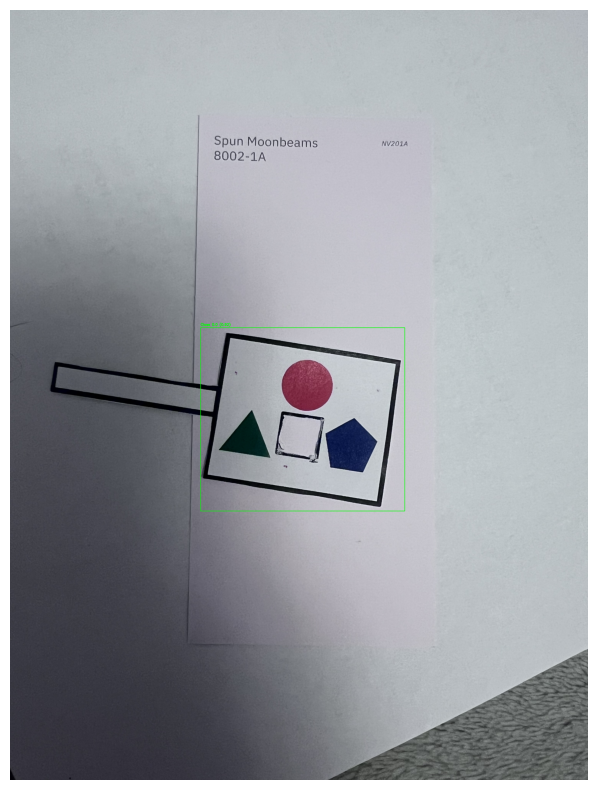

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_5.jpg: 640x480 2 color_cards, 53.9ms
Speed: 2.2ms preprocess, 53.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6C_5.jpg
Cropped image saved at cropped_1006-6C_5.jpg


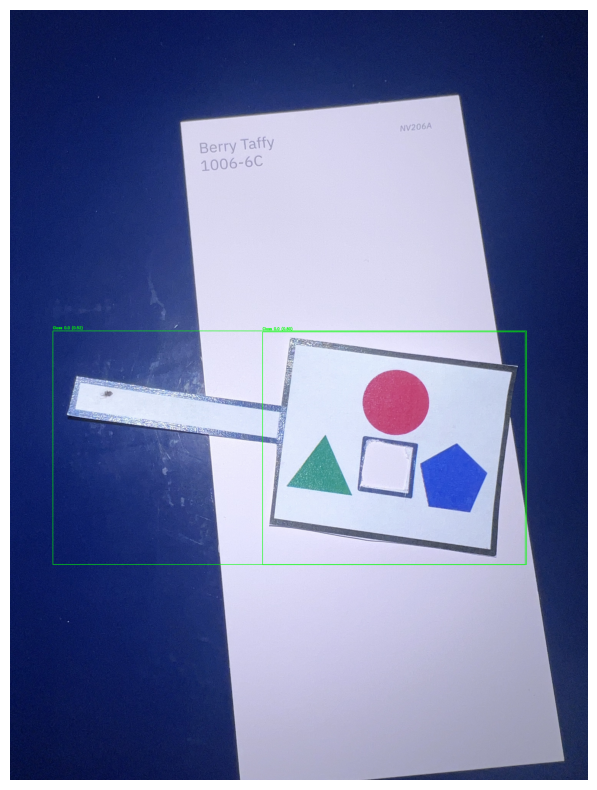

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_4.jpg: 640x480 2 color_cards, 44.8ms
Speed: 1.8ms preprocess, 44.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6C_4.jpg
Cropped image saved at cropped_1006-6C_4.jpg


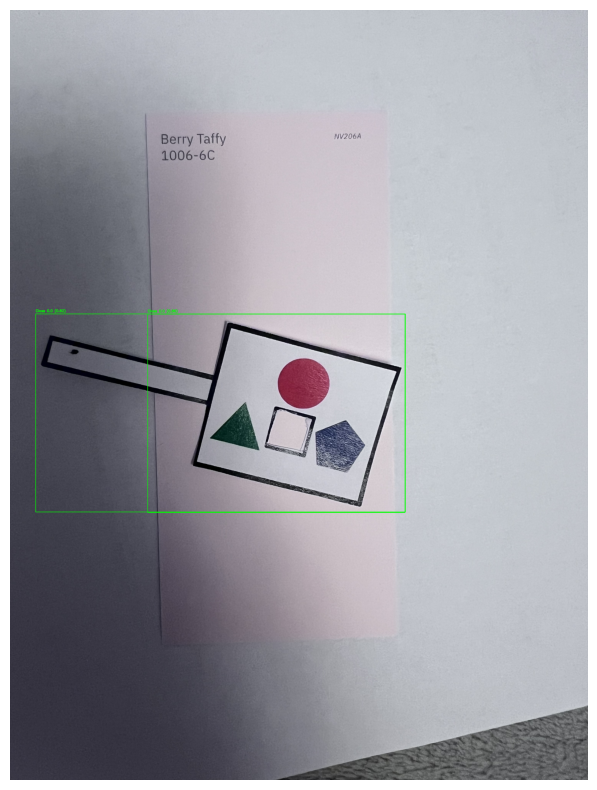

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_2.jpg: 640x480 2 color_cards, 43.7ms
Speed: 2.2ms preprocess, 43.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-1A_2.jpg
Cropped image saved at cropped_8002-1A_2.jpg


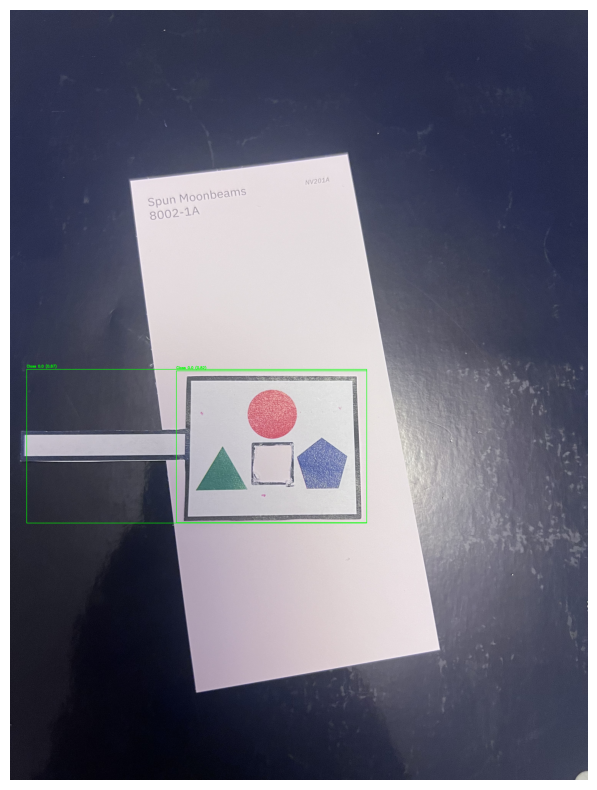

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_3.jpg: 640x480 1 color_card, 37.8ms
Speed: 1.7ms preprocess, 37.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-1A_3.jpg


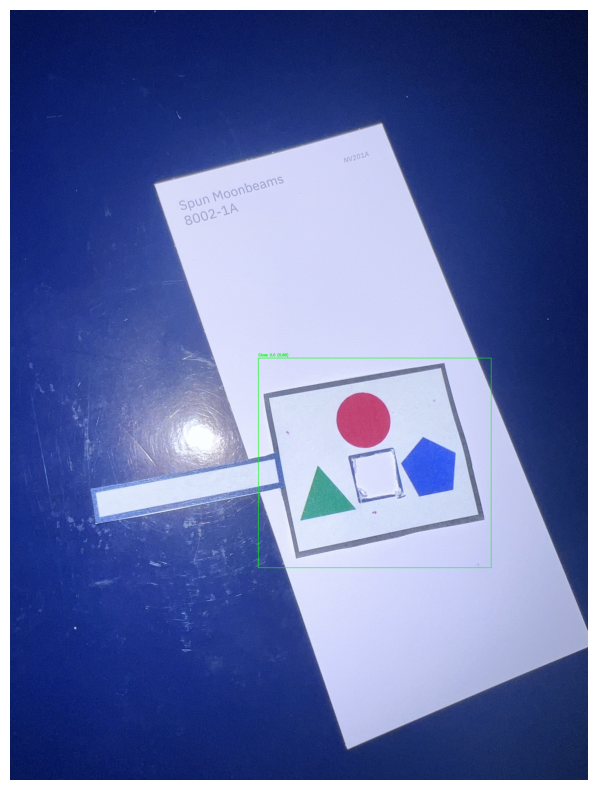

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_1.jpg: 640x480 1 color_card, 40.7ms
Speed: 1.5ms preprocess, 40.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6C_1.jpg


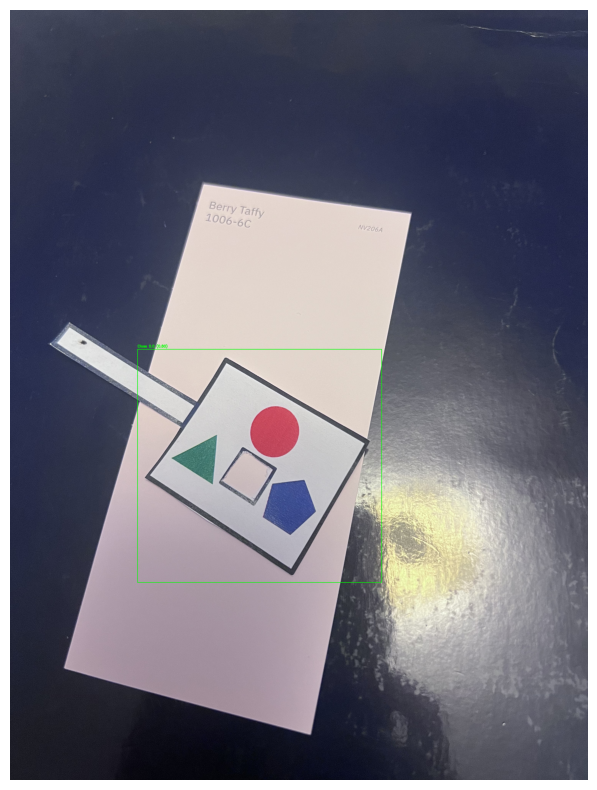

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_3.jpg: 640x480 1 color_card, 53.2ms
Speed: 2.3ms preprocess, 53.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6C_3.jpg


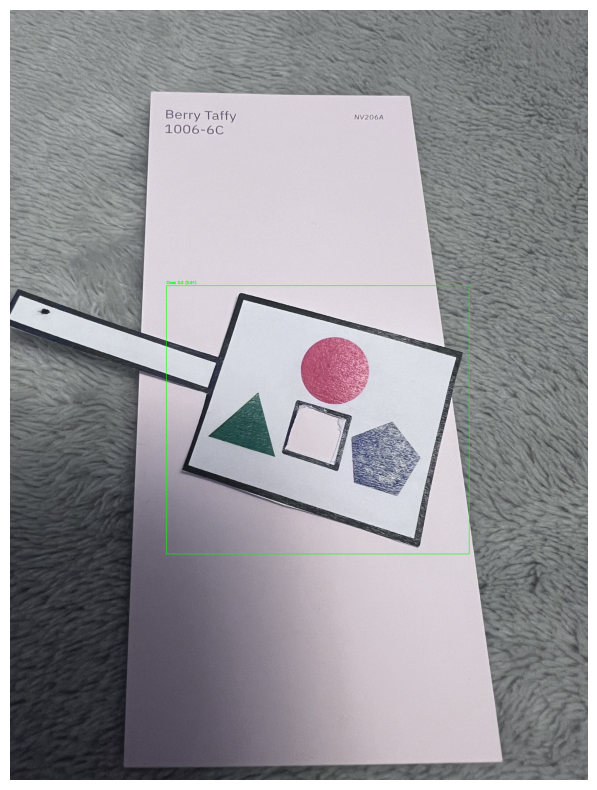

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/8002-1A_1.jpg: 640x480 1 color_card, 38.0ms
Speed: 2.0ms preprocess, 38.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-1A_1.jpg


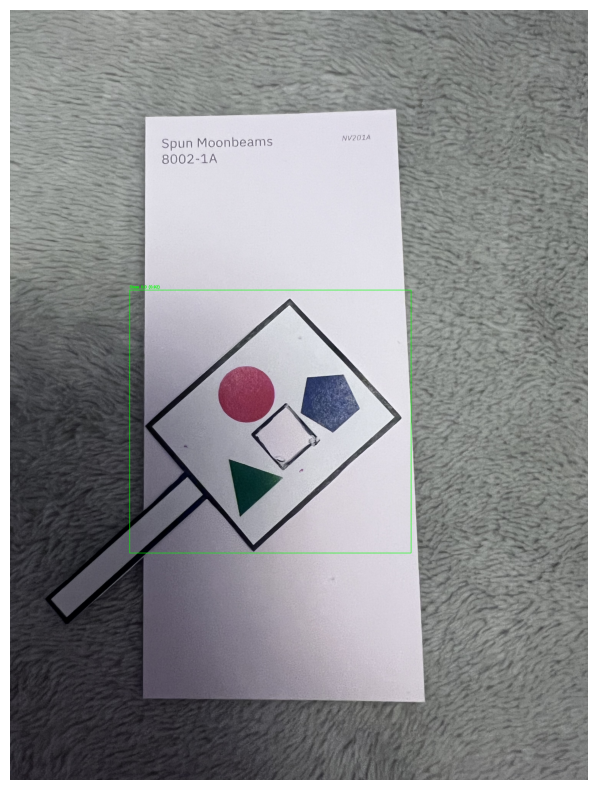

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train/1006-6C_2.jpg: 640x480 1 color_card, 41.8ms
Speed: 3.0ms preprocess, 41.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_1006-6C_2.jpg


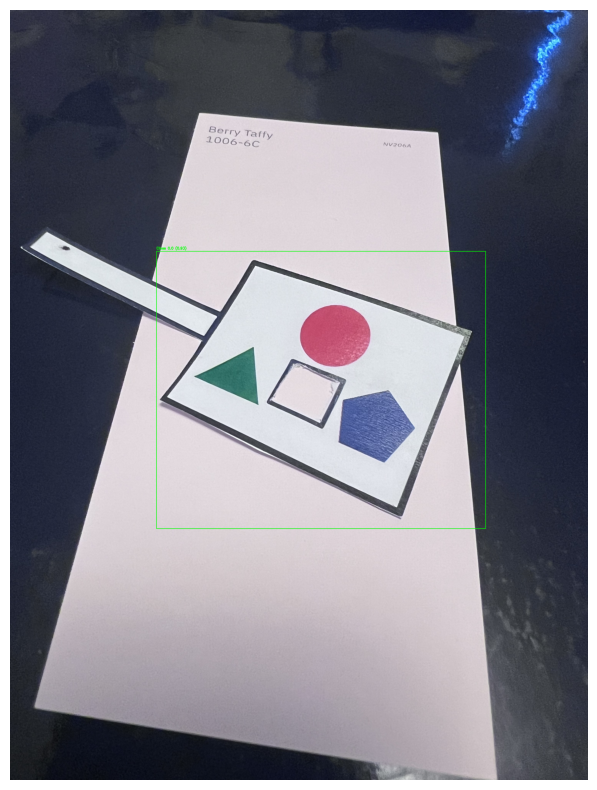

Processing validation images...
Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_3.jpg: 640x480 1 red_circle, 1 green_triangle, 1 blue_pentagon, 48.8ms
Speed: 2.8ms preprocess, 48.8ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-9A_3.jpg
Cropped image saved at cropped_8002-9A_3.jpg
Cropped image saved at cropped_8002-9A_3.jpg


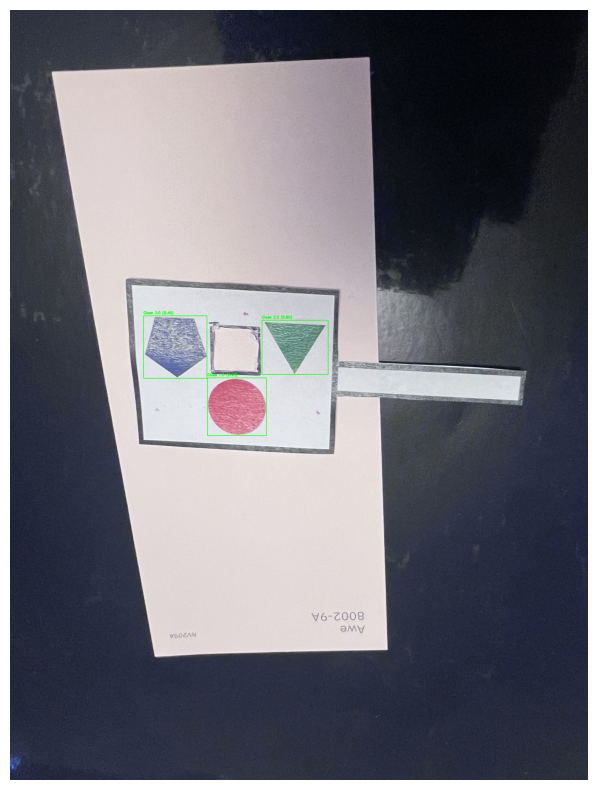

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_2.jpg: 640x480 1 red_circle, 1 green_triangle, 1 blue_pentagon, 38.8ms
Speed: 2.5ms preprocess, 38.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-9A_2.jpg
Cropped image saved at cropped_8002-9A_2.jpg
Cropped image saved at cropped_8002-9A_2.jpg


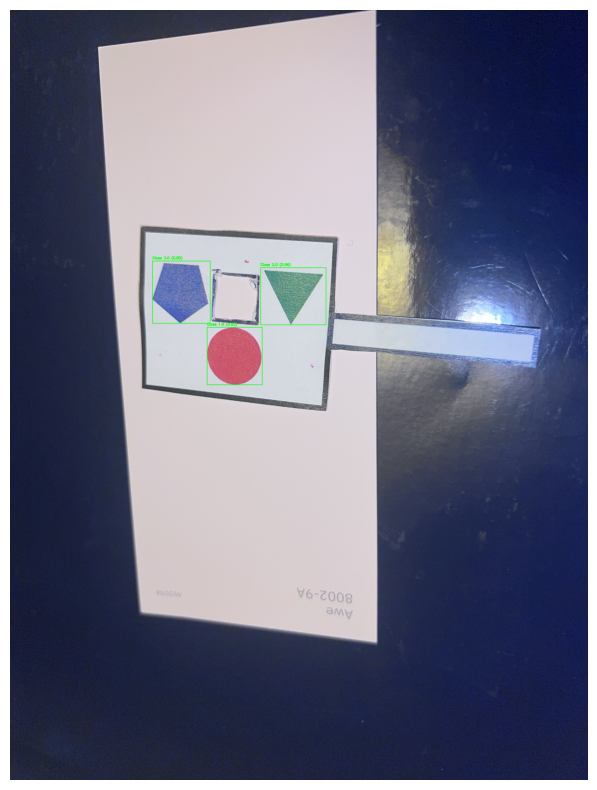

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_1.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_1.jpg: 640x480 1 black_box, 1 red_circle, 1 green_triangle, 1 blue_pentagon, 45.3ms
Speed: 1.8ms preprocess, 45.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-9A_1.jpg
Cropped image saved at cropped_8002-9A_1.jpg
Cropped image saved at cropped_8002-9A_1.jpg
Cropped image saved at cropped_8002-9A_1.jpg


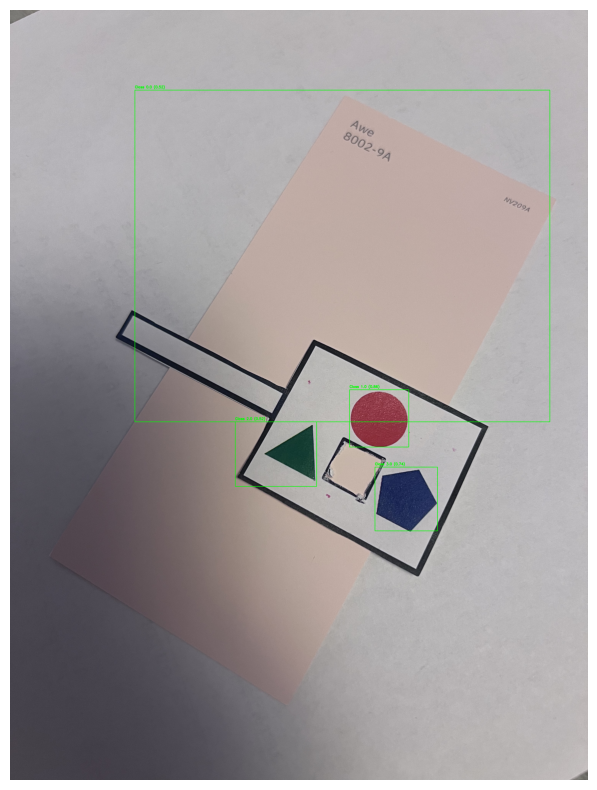

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_5.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_5.jpg: 640x480 1 red_circle, 1 green_triangle, 1 blue_pentagon, 44.7ms
Speed: 2.3ms preprocess, 44.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-9A_5.jpg
Cropped image saved at cropped_8002-9A_5.jpg
Cropped image saved at cropped_8002-9A_5.jpg


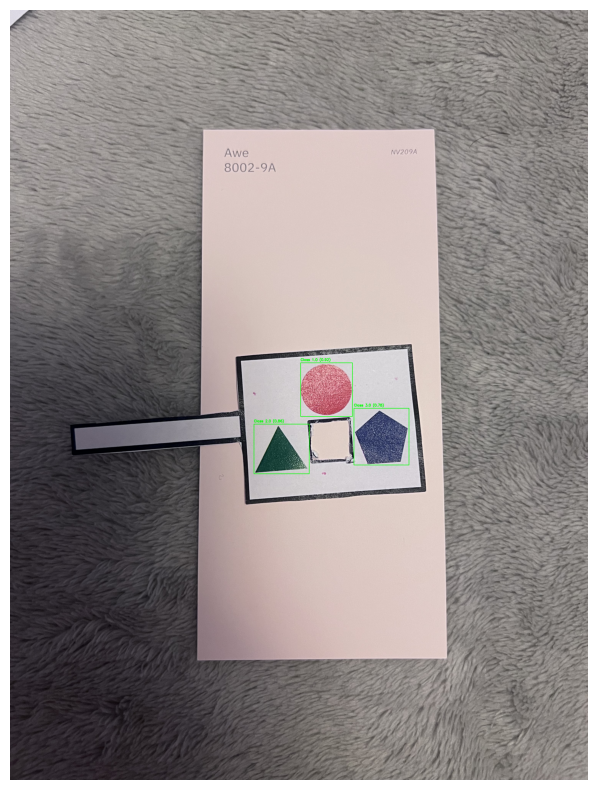

Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_4.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val/8002-9A_4.jpg: 640x480 1 red_circle, 2 green_triangles, 1 blue_pentagon, 83.6ms
Speed: 18.3ms preprocess, 83.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
Cropped image saved at cropped_8002-9A_4.jpg
Cropped image saved at cropped_8002-9A_4.jpg
Cropped image saved at cropped_8002-9A_4.jpg
Cropped image saved at cropped_8002-9A_4.jpg


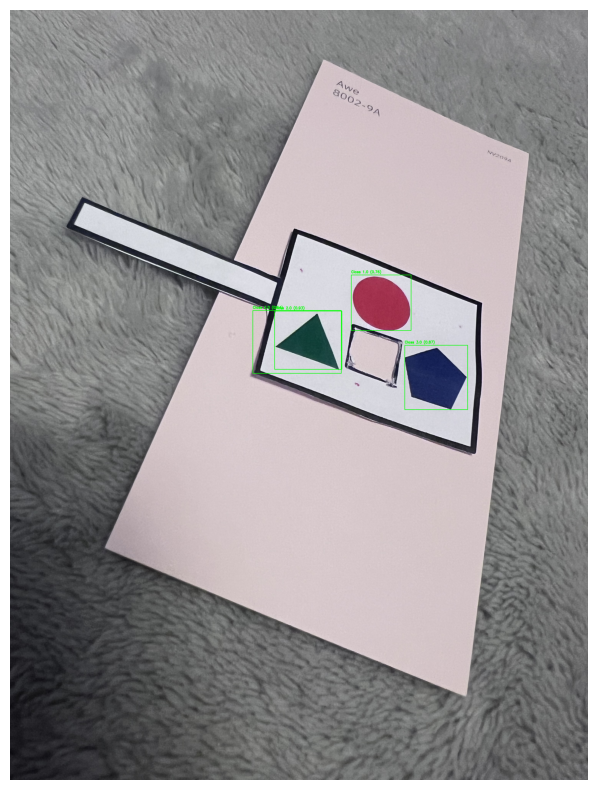

In [ ]:
import torch
import matplotlib.pyplot as plt
import cv2
import numpy as np
import os
from ultralytics import YOLO

# Load the YOLOv8 models from local paths
model_first = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_first.pt')
model_second = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_second.pt')

# Define a function to detect and draw bounding boxes using plt
def detect_and_draw(image_path, model):
    # Load the image
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading image: {image_path}")
        return
    
    # Perform inference
    results = model(image_path)  # Perform detection using the image path
    
    # Extract bounding boxes, scores, and class labels
    boxes = results[0].boxes.xyxy.cpu().numpy()  # Get bounding boxes (x1, y1, x2, y2)
    scores = results[0].boxes.conf.cpu().numpy()  # Get confidence scores
    class_ids = results[0].boxes.cls.cpu().numpy()  # Get class IDs

    # Loop over the detected boxes and draw them
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = box  # Coordinates of the bounding box
        confidence = scores[i]
        class_id = class_ids[i]
        
        # Draw bounding box with class label
        img = cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        
        # Annotate with class id and confidence
        label = f"Class {class_id} ({confidence:.2f})"
        cv2.putText(img, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
        
        # Save the cropped image from the bounding box
        cropped_img = img[int(y1):int(y2), int(x1):int(x2)]
        save_path = f"cropped/cropped_{os.path.basename(image_path)}"
        cv2.imwrite(save_path, cropped_img)
        print(f"Cropped image saved at {save_path}")
    
    # Convert BGR image to RGB for displaying with plt
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Display the image with plt
    plt.figure(figsize=(10, 10))
    plt.imshow(img_rgb)
    plt.axis('off')  # Turn off axis
    plt.show()

# Function to loop over images in a directory and process them
def process_images_in_directory(directory, model):
    # Loop through all files in the directory
    for filename in os.listdir(directory):
        image_path = os.path.join(directory, filename)
        
        # Only process .jpg or .jpeg files (you can add more image extensions if needed)
        if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
            print(f"Processing {image_path}")
            detect_and_draw(image_path, model)

# Define the paths for the directories
test_directory = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test'
train_directory = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train'
val_directory = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val'

# Process images in all directories
print("Processing test images...")
process_images_in_directory(test_directory, model_first)

print("Processing train images...")
process_images_in_directory(train_directory, model_first)

print("Processing validation images...")
process_images_in_directory(val_directory, model_second)


In [28]:
import torch
import os
import cv2
import numpy as np
from ultralytics import YOLO

# Load the YOLOv8 models from local paths
model_first = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_first.pt')
model_second = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_second.pt')

# Define a function to detect shapes using YOLOv8 and draw bounding boxes
def detect_and_save_shapes(image_path, model, shapes_folder, cropped_folder):
    # Load the image
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading image {image_path}")
        return
    
    # Perform inference
    results = model(image_path)  # Perform detection using YOLOv8

    # Extract bounding boxes, scores, and class labels
    boxes = results[0].boxes.xyxy.cpu().numpy()  # Get bounding boxes (x1, y1, x2, y2)
    scores = results[0].boxes.conf.cpu().numpy()  # Get confidence scores
    class_ids = results[0].boxes.cls.cpu().numpy()  # Get class IDs

    # Define shape labels based on class ids
    shape_labels = {
        0: "Red Circle",    # Assuming 0 corresponds to Red Circle
        1: "Green Triangle",  # Assuming 1 corresponds to Green Triangle
        2: "Blue Pentagon",   # Assuming 2 corresponds to Blue Pentagon
        3: "Black Box"      # Assuming 3 corresponds to Black Box
    }
    
    # Ensure output directories exist
    os.makedirs(shapes_folder, exist_ok=True)
    os.makedirs(cropped_folder, exist_ok=True)

    # Loop over the detected boxes and draw them
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = box  # Coordinates of the bounding box
        confidence = scores[i]
        class_id = int(class_ids[i])  # Ensure class_id is an integer
        
        # Annotate with shape name and confidence
        label = f"{shape_labels.get(class_id, 'Unknown')} ({confidence:.2f})"
        
        # Draw bounding box
        img_with_box = img.copy()  # Copy the original image to draw bounding boxes on it
        img_with_box = cv2.rectangle(img_with_box, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        cv2.putText(img_with_box, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
        
        # Save the image with bounding boxes
        shapes_save_path = os.path.join(shapes_folder, f"shapes_{os.path.basename(image_path)}")
        cv2.imwrite(shapes_save_path, img_with_box)
        print(f"Saved image with bounding boxes at {shapes_save_path}")

        # Crop the image within the bounding box
        cropped_img = img[int(y1):int(y2), int(x1):int(x2)]
        cropped_save_path = os.path.join(cropped_folder, f"cropped_{shape_labels.get(class_id, 'Unknown')}_{os.path.basename(image_path)}")
        cv2.imwrite(cropped_save_path, cropped_img)
        print(f"Saved cropped image at {cropped_save_path}")

# Define a function to process images in a directory
def process_images_in_directory(directory, model, shapes_folder, cropped_folder):
    for filename in os.listdir(directory):
        image_path = os.path.join(directory, filename)
        if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
            print(f"Processing {image_path}")
            
            # Detect shapes in the image and save to the appropriate folders
            detect_and_save_shapes(image_path, model, shapes_folder, cropped_folder)

# Define the paths for the directories
test_directory = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test'
train_directory = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/train'
val_directory = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/val'

# Define the save folders
shapes_folder = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes'
cropped_folder = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/cropped'

# Process images in all directories for shapes
print("Processing test images...")
process_images_in_directory(test_directory, model_first, shapes_folder, cropped_folder)

print("Processing train images...")
process_images_in_directory(train_directory, model_first, shapes_folder, cropped_folder)

print("Processing validation images...")
process_images_in_directory(val_directory, model_second, shapes_folder, cropped_folder)


Processing test images...
Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_2.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_2.jpg: 640x480 1 color_card, 49.4ms
Speed: 3.0ms preprocess, 49.4ms inference, 0.2ms postprocess per image at shape (1, 3, 640, 480)
Saved image with bounding boxes at /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/shapes_8002-10A_2.jpg
Saved cropped image at /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/cropped/cropped_Red Circle_8002-10A_2.jpg
Processing /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_3.jpg

image 1/1 /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/8002-10A_3.jpg: 640x480 1 color_card, 42.6ms
Speed: 4.3ms preprocess, 42.6ms inference, 1.1ms postprocess per image at shap


0: 640x480 1 red_circle, 1 green_triangle, 1 blue_pentagon, 67.0ms
Speed: 3.3ms preprocess, 67.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
Saved all cropped patterns at /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/all_cropped_patterns.jpg


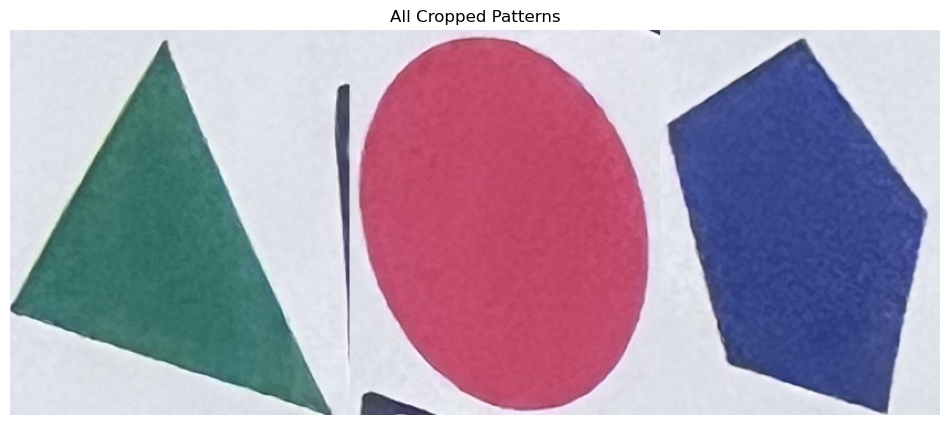

In [24]:
import torch
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np
from ultralytics import YOLO

# Function to detect patterns in the cropped image
def detect_and_crop_patterns(image_crop, model2, patterns_folder):
    # Perform pattern detection
    results2 = model2(image_crop)
    boxes = results2[0].boxes if results2 else []

    # Store all detected patterns
    patterns = []

    # Iterate through all detected bounding boxes
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
        h, w, _ = image_crop.shape

        # Ensure coordinates do not exceed image boundaries
        x1, y1, x2, y2 = max(0, x1), max(0, y1), min(w, x2), min(h, y2)

        # Crop the pattern and store it in the array
        pattern_crop = image_crop[y1:y2, x1:x2]
        patterns.append(pattern_crop)

    # Resize patterns to the same height (resize all to the height of the first pattern)
    if patterns:
        target_height = patterns[0].shape[0]  # Get the height of the first pattern
        resized_patterns = []

        for pattern in patterns:
            aspect_ratio = pattern.shape[1] / pattern.shape[0]  # Aspect ratio (width/height)
            new_width = int(target_height * aspect_ratio)  # Calculate new width to preserve aspect ratio
            resized_pattern = cv2.resize(pattern, (new_width, target_height))  # Resize pattern
            resized_patterns.append(resized_pattern)

        # Concatenate all resized patterns horizontally
        concatenated_patterns = np.concatenate(resized_patterns, axis=1)  # Concatenate along width
        concatenated_save_path = os.path.join(patterns_folder, 'all_cropped_patterns.jpg')
        cv2.imwrite(concatenated_save_path, concatenated_patterns)
        print(f"Saved all cropped patterns at {concatenated_save_path}")
        
        # Display all cropped patterns in one plot
        fig, ax = plt.subplots(figsize=(12, 6))
        ax.imshow(cv2.cvtColor(concatenated_patterns, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        ax.set_title("All Cropped Patterns")
        plt.show()

    else:
        print("No patterns detected.")

# Assuming image_crop exists and you have the model loaded
image_crop = cv2.imread('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_2.jpg')  # Replace with your actual path
model2 = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_second.pt')  # Replace with your actual model path
patterns_folder = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/'  # Replace with your actual folder path

# Perform detection and cropping of patterns from the cropped image
detect_and_crop_patterns(image_crop, model2, patterns_folder)


In [27]:
import torch
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np
from ultralytics import YOLO

# Function to detect patterns in the cropped image
def detect_and_crop_patterns(image_crop, model2, patterns_folder):
    # Perform pattern detection
    results2 = model2(image_crop)
    boxes = results2[0].boxes if results2 else []

    # Store all detected patterns
    patterns = []

    # Iterate through all detected bounding boxes
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
        h, w, _ = image_crop.shape

        # Ensure coordinates do not exceed image boundaries
        x1, y1, x2, y2 = max(0, x1), max(0, y1), min(w, x2), min(h, y2)

        # Crop the pattern and store it in the array
        pattern_crop = image_crop[y1:y2, x1:x2]
        patterns.append(pattern_crop)

        # Save each individual pattern as a separate image
        pattern_save_path = os.path.join(patterns_folder, f"pattern_{i+1}.jpg")
        cv2.imwrite(pattern_save_path, pattern_crop)
        print(f"Saved pattern {i+1} at {pattern_save_path}")

    # Additionally, save the black box if detected (black box might have a specific class id, adjust accordingly)
    if len(boxes) == 0:
        print("No patterns detected.")
    else:
        # Handle saving of the black box if it is detected
        for i, box in enumerate(boxes):
            class_id = int(box.cls[0])  # Get the class id
            if class_id == 0:  # Assuming class ID 0 is for black box
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                black_box = image_crop[y1:y2, x1:x2]
                black_box_save_path = os.path.join(patterns_folder, 'black_box.jpg')
                cv2.imwrite(black_box_save_path, black_box)
                print(f"Saved black box at {black_box_save_path}")
                break  # Assuming only one black box, stop after saving it

# Assuming image_crop exists and you have the model loaded
image_crop = cv2.imread('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/test/2001-6C_2.jpg')  # Replace with your actual path
model2 = YOLO('/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/model_second.pt')  # Replace with your actual model path
patterns_folder = '/Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/'  # Replace with your actual folder path

# Perform detection and cropping of patterns from the cropped image
detect_and_crop_patterns(image_crop, model2, patterns_folder)



0: 640x480 1 red_circle, 1 green_triangle, 1 blue_pentagon, 70.4ms
Speed: 4.1ms preprocess, 70.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Saved pattern 1 at /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/pattern_1.jpg
Saved pattern 2 at /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/pattern_2.jpg
Saved pattern 3 at /Users/vedanshi/Documents/GitHub/practical_ml/project-1-notebooks/dataset/images/shapes/pattern_3.jpg
